# Power Consumption - Pet Food Extruder

## 0. Frame the Problem

The objective is to predict the power consumption of an extruder, mainly with 4 variables:
* Motor Load
* Gearbox oil
* Flowrate
* Product

## 1. Get the data

In [1]:
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns

from scipy import stats
from scipy.stats import norm, skew #for some statistics

import datetime as dt

In [2]:
# Load Energy data

# Baseline oil
df_BL_1 = pd.read_excel('datasets/BL - Trend EXTRUS1.xls', 'Trend')
df_BL_2 = pd.read_excel('datasets/BL - Trend EXTRUS1.xls', '2')

# Post Retrofit oil
df_PR_1 = pd.read_excel('datasets/PR - Trend EXTRUS12.xls', 'Trend')
df_PR_2 = pd.read_excel('datasets/PR - Trend EXTRUS12.xls', '2')

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero


In [3]:
# Load Flow and Product data

# Flow rate
df_flow = pd.read_excel('datasets/Corrientes.xlsx', 'Hoja1')

# Products
df_prod = pd.read_csv('datasets\Products_encoded.csv')

### 1.A) Work with the Energy data

In [4]:
df_BL_1.head(10)

,Model 8335,Serial number,212786,Hardware Rev 1.1 PLD 1.1,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58
0,Trend,EXTRUS1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Date Started,Time Started,Date Ended,Time Ended,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,19/02/2019,09:30:00 a.m.,19/03/2019,09:30:00 a.m.,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Connection Type: 3-Phase 5-Wire,A193 AmpFlex,Reactive values (var) calculation: Without Har...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
6,NaN,NaN,Hz,V,V,V,V,V,V,V,...,A,A,A,A,V,V,V,V,V,V
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,19/02/2019,09:30:00 a.m.,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,...,173,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4
9,19/02/2019,09:30:20 a.m.,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,...,173.5,171,165,0,400.6,400.4,401,396.1,393.8,394.3


In [5]:
df_BL_2.head(10)

,06/03/2019,01:32:00 p.m.,49.93,411.5,410.6,411.6,237.5,237.60000000000002,237.10000000000002,0,...,0.19,0.20,0.21,0.22,413,412.20000000000005,413.6,410.1,408.90000000000003,409.5
0,06/03/2019,01:32:20 p.m.,49.94,411.4,410.5,411.5,237.5,237.5,237.1,0.0,...,0.0,0.0,0.0,0,413.2,412.3,413.8,409.3,408.4,408.9
1,06/03/2019,01:32:40 p.m.,49.95,411.4,410.5,411.6,237.5,237.5,237.1,0.0,...,0.0,0.0,0.0,0,413.1,412.3,414.1,409.8,408.8,409.3
2,06/03/2019,01:33:00 p.m.,49.94,411.3,410.4,411.4,237.4,237.5,237.0,0.0,...,0.0,0.0,0.0,0,412.8,412.1,413.6,409.9,408.6,409.3
3,06/03/2019,01:33:20 p.m.,49.94,411.3,410.4,411.4,237.4,237.5,237.0,0.0,...,0.0,0.0,0.0,0,412.8,412.4,413.3,409.6,408.4,409.2
4,06/03/2019,01:33:40 p.m.,49.97,411.6,410.7,411.7,237.6,237.6,237.2,0.0,...,0.0,0.0,0.0,0,413.1,413.1,413.9,410.3,408.8,409.9
5,06/03/2019,01:34:00 p.m.,49.95,411.5,410.5,411.5,237.5,237.5,237.1,0.0,...,0.0,0.0,0.0,0,412.9,412.8,413.7,409.2,408.1,409.3
6,06/03/2019,01:34:20 p.m.,49.93,411.2,410.3,411.3,237.4,237.4,237.0,0.0,...,0.0,0.0,0.0,0,412.8,412.3,413.7,409.6,408.5,409.3
7,06/03/2019,01:34:40 p.m.,49.93,411.2,410.3,411.3,237.4,237.4,237.0,0.0,...,0.0,0.0,0.0,0,412.8,412.2,413.7,409.6,408.5,409.0
8,06/03/2019,01:35:00 p.m.,49.94,411.1,410.3,411.2,237.3,237.4,236.9,0.0,...,0.0,0.0,0.0,0,412.5,412.2,413.5,409.2,407.9,408.8
9,06/03/2019,01:35:20 p.m.,49.95,411.0,410.1,411.1,237.2,237.3,236.8,0.0,...,0.0,0.0,0.0,0,412.6,412.6,413.7,409.2,407.9,408.7


In [6]:
# Modify Energy datasets

headers_BL = df_BL_1.iloc[5]
headers_PR = df_PR_1.iloc[5]

df_BL_1  = pd.DataFrame(df_BL_1.values[8:], columns=headers_BL)
df_PR_1  = pd.DataFrame(df_PR_1.values[8:], columns=headers_PR)

df_BL_2  = pd.DataFrame(df_BL_2.values[:], columns=headers_BL)
df_PR_2  = pd.DataFrame(df_PR_2.values[:], columns=headers_PR)

df_BL_1.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
0,19/02/2019,09:30:00 a.m.,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,...,173,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4
1,19/02/2019,09:30:20 a.m.,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,...,173.5,171,165,0,400.6,400.4,401,396.1,393.8,394.3
2,19/02/2019,09:30:40 a.m.,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,...,175.5,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9
3,19/02/2019,09:31:00 a.m.,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,...,174.5,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4
4,19/02/2019,09:31:20 a.m.,49.96,398.4,397.6,397.9,229.7,230.5,229,1,...,176.5,177,171,0,400.9,400.8,401.3,396.3,394,394.7


In [7]:
# As we can see, I have to fix the days and months cause sometimes they are swapped (what is interpreted as January 3rd is actually March 1st)

print('df_BL_1')
print(df_BL_1['Date'].min())
print(df_BL_1['Date'].max())

print('----------')

print('df_BL_2')
print(df_BL_2['Date'].min())
print(df_BL_2['Date'].max())

print('----------')

print('df_PR_1')
print(df_PR_1['Date'].min())
print(df_PR_1['Date'].max())

print('----------')

print('df_PR_2')
print(df_PR_2['Date'].min())
print(df_PR_2['Date'].max())

df_BL_1
01/03/2019
28/02/2019
----------
df_BL_2
06/03/2019
19/03/2019
----------
df_PR_1
01/04/2019
31/03/2019
----------
df_PR_2
10/04/2019
23/04/2019


In [8]:
# Join the 2 sheets from each dataset (BL, PR) together to have just one of each

frames_BL = [df_BL_1, df_BL_2]
frames_PR = [df_PR_1, df_PR_2]

df_BL = pd.concat(frames_BL)
df_PR = pd.concat(frames_PR)

df_BL.tail()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
55428,19/03/2019,09:28:20 a.m.,49.97,394.1,393.2,393.3,227,228.1,226.5,0,...,183.5,182,173.5,0,397.3,396.8,396.8,390.7,389.6,389.7
55429,19/03/2019,09:28:40 a.m.,49.97,394.1,393.2,393.4,227,228.1,226.5,0,...,182,180,174,0,397,396.5,396.8,391.1,389.5,390
55430,19/03/2019,09:29:00 a.m.,49.98,394.5,393.6,393.8,227.3,228.3,226.7,0,...,182,179.5,173.5,0,397.5,397.3,397.1,391.9,390.2,390.3
55431,19/03/2019,09:29:20 a.m.,49.96,394.4,393.6,393.8,227.3,228.3,226.7,0,...,179,178,171,0,397.1,396.8,397.3,391.1,390.2,390.3
55432,19/03/2019,09:29:40 a.m.,49.97,394.4,393.5,393.7,227.2,228.3,226.6,0,...,174.5,177.5,171,0,397.4,397,397.2,391.1,390,389.9


In [9]:
df_PR.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
0,26/03/2019,09:40:00 a.m.,49.92,398.1,397.1,397.9,229.6,230,229.2,0,...,0,0,0,0,400.6,399.4,400,395.6,394.9,395.9
1,26/03/2019,09:40:20 a.m.,49.92,397.8,396.8,397.6,229.5,229.8,229,0,...,0,0,0,0,400.1,399.5,400.2,394.7,393.1,394.7
2,26/03/2019,09:40:40 a.m.,49.9,397.6,396.7,397.4,229.3,229.7,228.9,0,...,0,0,0,0,400,398.8,399.4,395.5,394.3,395.4
3,26/03/2019,09:41:00 a.m.,49.93,397.8,396.8,397.6,229.4,229.8,229,0,...,0,0,0,0,399.3,399.1,399.9,396.3,394.4,395.5
4,26/03/2019,09:41:20 a.m.,49.97,397.8,396.8,397.6,229.5,229.8,229,0,...,0,0,0,0,400,399.3,399.5,395.3,394.7,395.4


In [10]:
df_PR.tail()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
55428,23/04/2019,09:38:20 a.m.,49.92,402.6,401.8,402.7,232.4,232.4,232,0,...,0,0,0,0,405,404.3,405.1,400.5,399.3,400.6
55429,23/04/2019,09:38:40 a.m.,49.89,402.1,401.5,402.4,232.2,232.2,231.8,0,...,0,0,0,0,403.4,403.8,404.5,400.5,399.2,400.2
55430,23/04/2019,09:39:00 a.m.,49.92,402.2,401.6,402.5,232.3,232.3,231.9,0,...,0,0,0,0,403.9,403.7,405,400.4,399.5,400.4
55431,23/04/2019,09:39:20 a.m.,49.92,402.4,401.7,402.6,232.4,232.4,232,0,...,0,0,0,0,403.8,403.6,404.9,401,400.3,400.6
55432,23/04/2019,09:39:40 a.m.,49.92,402.7,402.1,403,232.5,232.6,232.2,0,...,0,0,0,0,403.8,404.2,405,401.5,400.1,400.9


In [11]:
# Join Date & Time columns into a single 'Datetime' column

df_BL['Datetime'] = df_BL['Date'] + ' ' + df_BL['Time']
df_PR['Datetime'] = df_PR['Date'] + ' ' + df_PR['Time']

In [12]:
print('df_BL')
print(df_BL['Datetime'].min())
print(df_BL['Datetime'].max())

print('----------')

print('df_PR')
print(df_PR['Datetime'].min())
print(df_PR['Datetime'].max())

df_BL
01/03/2019 01:00:00 a.m.
28/02/2019 12:59:40 p.m.
----------
df_PR
01/04/2019 01:00:00 a.m.
31/03/2019 12:59:40 p.m.


In [13]:
df_BL.dtypes

5
Date          object
Time          object
Frequency     object
U1 RMS        object
U2 RMS        object
U3 RMS        object
V1 RMS        object
V2 RMS        object
V3 RMS        object
VN RMS        object
A1 RMS        object
A2 RMS        object
A3 RMS        object
AN RMS        object
W1            object
W2            object
W3            object
W Total       object
Wh1           object
Wh2           object
Wh3           object
Wh Total      object
var1          object
var2          object
var3          object
var Total     object
varh1         object
varh2         object
varh3         object
varh Total    object
PF1           object
PF2           object
PF3           object
PF Mean       object
Vunb(IEEE)    object
Aunb(IEEE)    object
Uunb(IEEE)    object
V1 RMS MAX    object
V2 RMS MAX    object
V3 RMS MAX    object
VN RMS MAX    object
V1 RMS MIN    object
V2 RMS MIN    object
V3 RMS MIN    object
VN RMS MIN    object
A1 RMS MAX    object
A2 RMS MAX    object
A3 RMS MAX 

In [14]:
df_BL.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Datetime
0,19/02/2019,09:30:00 a.m.,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,...,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4,19/02/2019 09:30:00 a.m.
1,19/02/2019,09:30:20 a.m.,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,...,171,165,0,400.6,400.4,401,396.1,393.8,394.3,19/02/2019 09:30:20 a.m.
2,19/02/2019,09:30:40 a.m.,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,...,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9,19/02/2019 09:30:40 a.m.
3,19/02/2019,09:31:00 a.m.,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,...,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4,19/02/2019 09:31:00 a.m.
4,19/02/2019,09:31:20 a.m.,49.96,398.4,397.6,397.9,229.7,230.5,229,1,...,177,171,0,400.9,400.8,401.3,396.3,394,394.7,19/02/2019 09:31:20 a.m.


In [15]:
# Before conveting to timestamps, I have to correct the values so that they are correctly transformed

df_BL['Datetime'] = df_BL['Datetime'].str.replace('a.m.','AM')
df_BL['Datetime'] = df_BL['Datetime'].str.replace('p.m.','PM')

df_PR['Datetime'] = df_PR['Datetime'].str.replace('a.m.','AM')
df_PR['Datetime'] = df_PR['Datetime'].str.replace('p.m.','PM')

df_BL.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Datetime
0,19/02/2019,09:30:00 a.m.,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,...,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4,19/02/2019 09:30:00 AM
1,19/02/2019,09:30:20 a.m.,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,...,171,165,0,400.6,400.4,401,396.1,393.8,394.3,19/02/2019 09:30:20 AM
2,19/02/2019,09:30:40 a.m.,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,...,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9,19/02/2019 09:30:40 AM
3,19/02/2019,09:31:00 a.m.,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,...,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4,19/02/2019 09:31:00 AM
4,19/02/2019,09:31:20 a.m.,49.96,398.4,397.6,397.9,229.7,230.5,229,1,...,177,171,0,400.9,400.8,401.3,396.3,394,394.7,19/02/2019 09:31:20 AM


In [16]:
# Convert Datetime column from strings to timestamps using the correct format

df_BL['Datetime'] = pd.to_datetime(df_BL['Datetime'], format='%d/%m/%Y %I:%M:%S %p')
df_PR['Datetime'] = pd.to_datetime(df_PR['Datetime'], format='%d/%m/%Y %I:%M:%S %p')

In [17]:
df_BL.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Datetime
0,19/02/2019,09:30:00 a.m.,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,...,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4,2019-02-19 09:30:00
1,19/02/2019,09:30:20 a.m.,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,...,171,165,0,400.6,400.4,401,396.1,393.8,394.3,2019-02-19 09:30:20
2,19/02/2019,09:30:40 a.m.,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,...,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9,2019-02-19 09:30:40
3,19/02/2019,09:31:00 a.m.,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,...,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4,2019-02-19 09:31:00
4,19/02/2019,09:31:20 a.m.,49.96,398.4,397.6,397.9,229.7,230.5,229,1,...,177,171,0,400.9,400.8,401.3,396.3,394,394.7,2019-02-19 09:31:20


In [18]:
# Day and Month are fixed

print('df_BL')
print(df_BL['Datetime'].min())
print(df_BL['Datetime'].max())

print('----------')

print('df_PR')
print(df_PR['Datetime'].min())
print(df_PR['Datetime'].max())

df_BL
2019-02-19 09:30:00
2019-03-19 09:29:40
----------
df_PR
2019-03-26 09:40:00
2019-04-23 09:39:40


In [19]:
# Set timestamps as index

df_BL.reset_index(drop=True)
df_BL = df_BL.set_index('Datetime')

df_PR.reset_index(drop=True)
df_PR = df_PR.set_index('Datetime')

In [20]:
df_BL.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-02-19 09:30:00,19/02/2019,09:30:00 a.m.,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,...,173,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4
2019-02-19 09:30:20,19/02/2019,09:30:20 a.m.,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,...,173.5,171,165,0,400.6,400.4,401,396.1,393.8,394.3
2019-02-19 09:30:40,19/02/2019,09:30:40 a.m.,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,...,175.5,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9
2019-02-19 09:31:00,19/02/2019,09:31:00 a.m.,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,...,174.5,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4
2019-02-19 09:31:20,19/02/2019,09:31:20 a.m.,49.96,398.4,397.6,397.9,229.7,230.5,229,1,...,176.5,177,171,0,400.9,400.8,401.3,396.3,394,394.7


In [21]:
df_PR.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A1 RMS MIN,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-03-26 09:40:00,26/03/2019,09:40:00 a.m.,49.92,398.1,397.1,397.9,229.6,230,229.2,0,...,0,0,0,0,400.6,399.4,400,395.6,394.9,395.9
2019-03-26 09:40:20,26/03/2019,09:40:20 a.m.,49.92,397.8,396.8,397.6,229.5,229.8,229,0,...,0,0,0,0,400.1,399.5,400.2,394.7,393.1,394.7
2019-03-26 09:40:40,26/03/2019,09:40:40 a.m.,49.9,397.6,396.7,397.4,229.3,229.7,228.9,0,...,0,0,0,0,400,398.8,399.4,395.5,394.3,395.4
2019-03-26 09:41:00,26/03/2019,09:41:00 a.m.,49.93,397.8,396.8,397.6,229.4,229.8,229,0,...,0,0,0,0,399.3,399.1,399.9,396.3,394.4,395.5
2019-03-26 09:41:20,26/03/2019,09:41:20 a.m.,49.97,397.8,396.8,397.6,229.5,229.8,229,0,...,0,0,0,0,400,399.3,399.5,395.3,394.7,395.4


In [22]:
df_BL.shape

(120959, 59)

In [23]:
df_PR.shape

(120959, 59)

In [24]:
df_BL.columns

Index(['Date', 'Time', 'Frequency', 'U1 RMS', 'U2 RMS', 'U3 RMS', 'V1 RMS',
       'V2 RMS', 'V3 RMS', 'VN RMS', 'A1 RMS', 'A2 RMS', 'A3 RMS', 'AN RMS',
       'W1', 'W2', 'W3', 'W Total', 'Wh1', 'Wh2', 'Wh3', 'Wh Total', 'var1',
       'var2', 'var3', 'var Total', 'varh1', 'varh2', 'varh3', 'varh Total',
       'PF1', 'PF2', 'PF3', 'PF Mean', 'Vunb(IEEE)', 'Aunb(IEEE)',
       'Uunb(IEEE)', 'V1 RMS MAX', 'V2 RMS MAX', 'V3 RMS MAX', 'VN RMS MAX',
       'V1 RMS MIN', 'V2 RMS MIN', 'V3 RMS MIN', 'VN RMS MIN', 'A1 RMS MAX',
       'A2 RMS MAX', 'A3 RMS MAX', 'AN RMS MAX', 'A1 RMS MIN', 'A2 RMS MIN',
       'A3 RMS MIN', 'AN RMS MIN', 'U1 RMS MAX', 'U2 RMS MAX', 'U3 RMS MAX',
       'U1 RMS MIN', 'U2 RMS MIN', 'U3 RMS MIN'],
      dtype='object', name=5)

In [25]:
# Add column to specify the used oil

df_BL['Oil'] = 'BL'
df_PR['Oil'] = 'PR'
df_PR.head()

5,Date,Time,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,...,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Oil
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-03-26 09:40:00,26/03/2019,09:40:00 a.m.,49.92,398.1,397.1,397.9,229.6,230,229.2,0,...,0,0,0,400.6,399.4,400,395.6,394.9,395.9,PR
2019-03-26 09:40:20,26/03/2019,09:40:20 a.m.,49.92,397.8,396.8,397.6,229.5,229.8,229,0,...,0,0,0,400.1,399.5,400.2,394.7,393.1,394.7,PR
2019-03-26 09:40:40,26/03/2019,09:40:40 a.m.,49.9,397.6,396.7,397.4,229.3,229.7,228.9,0,...,0,0,0,400,398.8,399.4,395.5,394.3,395.4,PR
2019-03-26 09:41:00,26/03/2019,09:41:00 a.m.,49.93,397.8,396.8,397.6,229.4,229.8,229,0,...,0,0,0,399.3,399.1,399.9,396.3,394.4,395.5,PR
2019-03-26 09:41:20,26/03/2019,09:41:20 a.m.,49.97,397.8,396.8,397.6,229.5,229.8,229,0,...,0,0,0,400,399.3,399.5,395.3,394.7,395.4,PR


In [26]:
# Join BL & PR datasets into a single df & drop 'Date' & 'Time' columns

frames_total = [df_BL, df_PR]

df_energy = pd.concat(frames_total)

df_energy.columns.name=''

df_energy.drop(columns = ['Date', 'Time'], inplace = True)

df_energy.head()

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Oil
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-02-19 09:30:00,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,185.7,185.2,...,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4,BL
2019-02-19 09:30:20,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,186.5,185.9,...,171,165,0,400.6,400.4,401,396.1,393.8,394.3,BL
2019-02-19 09:30:40,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,187.8,187.2,...,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9,BL
2019-02-19 09:31:00,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,184.4,184.1,...,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4,BL
2019-02-19 09:31:20,49.96,398.4,397.6,397.9,229.7,230.5,229,1,185.4,185.3,...,177,171,0,400.9,400.8,401.3,396.3,394,394.7,BL


In [27]:
df_energy

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,A2 RMS MIN,A3 RMS MIN,AN RMS MIN,U1 RMS MAX,U2 RMS MAX,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Oil
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-02-19 09:30:00,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,185.7,185.2,...,172,169.5,0,400.7,400.6,400.8,396.3,394,394.4,BL
2019-02-19 09:30:20,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,186.5,185.9,...,171,165,0,400.6,400.4,401,396.1,393.8,394.3,BL
2019-02-19 09:30:40,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,187.8,187.2,...,175.5,172,0,401,400.9,401.1,395.9,393.8,393.9,BL
2019-02-19 09:31:00,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,184.4,184.1,...,173.5,170,0,400.7,401.6,400.8,396,393.9,394.4,BL
2019-02-19 09:31:20,49.96,398.4,397.6,397.9,229.7,230.5,229,1,185.4,185.3,...,177,171,0,400.9,400.8,401.3,396.3,394,394.7,BL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-04-23 09:38:20,49.92,402.6,401.8,402.7,232.4,232.4,232,0,0,0,...,0,0,0,405,404.3,405.1,400.5,399.3,400.6,PR
2019-04-23 09:38:40,49.89,402.1,401.5,402.4,232.2,232.2,231.8,0,0,0,...,0,0,0,403.4,403.8,404.5,400.5,399.2,400.2,PR
2019-04-23 09:39:00,49.92,402.2,401.6,402.5,232.3,232.3,231.9,0,0,0,...,0,0,0,403.9,403.7,405,400.4,399.5,400.4,PR


### 1.B) Work with the Flow & Product data

In [28]:
df_flow.head(7)

,Corriente,TagName,DateTime,Value,vValue,StartDateTime
0,Vapor,0104FT2109.PV,2/19/2019 6:10:00 AM,92.997926,92.997926,2/19/2019 6:00:00 AM
1,Agua,0104FT2110.PV,2/19/2019 6:10:00 AM,255.165542,255.165542,2/19/2019 6:00:00 AM
2,Color,0104FT2111.PV,2/19/2019 6:10:00 AM,39.335413,39.335413,2/19/2019 6:00:00 AM
3,Ácido,0104FT2112.PV,2/19/2019 6:10:00 AM,0.479114,0.479114,2/19/2019 6:00:00 AM
4,Motor,0104IT2106_01.PV,2/19/2019 6:10:00 AM,248.290955,248.290955,2/19/2019 6:00:00 AM
5,Harina,0104FT2116.PV,2/19/2019 6:10:00 AM,1500.944568,1500.944568,2/19/2019 6:00:00 AM
6,Vapor,0104FT2109.PV,2/19/2019 6:20:00 AM,93.120982,93.120982,2/19/2019 6:10:00 AM


In [29]:
df_prod.head()

,INICIO,FIN,FÓRMULA
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
1,2019-02-20 14:00:00,2019-02-22 22:00:00,DOG1_Grown_ExtrBulk_AR_2015
2,2019-02-22 22:00:00,2019-02-23 06:00:00,DOG1_Puppy_ExtrBulk_AR
3,2019-02-23 06:00:00,2019-02-23 22:00:00,Stop
4,2019-02-23 22:00:00,2019-02-24 22:00:00,Sunday


#### 1.B.I) Flow data

In [30]:
# Flow data: Timestamp inconsistency: day and month are swapped when april starts

df_flow.iloc[34973:34976]

,Corriente,TagName,DateTime,Value,vValue,StartDateTime
34973,Harina,0104FT2116.PV,2019-01-04 00:00:00,0.000000,0.000000,3/31/2019 11:50:00 PM
34974,Vapor,0104FT2109.PV,2019-01-04 00:10:00,0.716807,0.716807,2019-01-04 00:00:00
34975,Agua,0104FT2110.PV,2019-01-04 00:10:00,0.048638,0.048638,2019-01-04 00:00:00


In [31]:
# This inconsistency ends when we reach april 13th
# This is due to the fact that before march 31st the only possible timestamp format was mm/dd 
# but afterwards the software thinks it is dd/mm so instead of april 1st, april 2nd, etc we get january 4th, february 4th and 
# so on, until december 4th (which should actually be april 12th). From that we return to the correct timestamp format, 
# as there is no 13th month.

df_flow.iloc[45341:45344]

,Corriente,TagName,DateTime,Value,vValue,StartDateTime
45341,Harina,0104FT2116.PV,4/13/2019 12:00:00 AM,1500.748663,1500.748663,2019-12-04 23:50:00
45342,Vapor,0104FT2109.PV,4/13/2019 12:10:00 AM,96.095439,96.095439,4/13/2019 12:00:00 AM
45343,Agua,0104FT2110.PV,4/13/2019 12:10:00 AM,240.287479,240.287479,4/13/2019 12:00:00 AM


In [32]:
df_flow.iloc[34973:45343]

,Corriente,TagName,DateTime,Value,vValue,StartDateTime
34973,Harina,0104FT2116.PV,2019-01-04 00:00:00,0.000000,0.000000,3/31/2019 11:50:00 PM
34974,Vapor,0104FT2109.PV,2019-01-04 00:10:00,0.716807,0.716807,2019-01-04 00:00:00
34975,Agua,0104FT2110.PV,2019-01-04 00:10:00,0.048638,0.048638,2019-01-04 00:00:00
34976,Color,0104FT2111.PV,2019-01-04 00:10:00,0.220107,0.220107,2019-01-04 00:00:00
34977,Ácido,0104FT2112.PV,2019-01-04 00:10:00,0.462719,0.462719,2019-01-04 00:00:00
...,...,...,...,...,...,...
45338,Color,0104FT2111.PV,4/13/2019 12:00:00 AM,75.029234,75.029234,2019-12-04 23:50:00
45339,Ácido,0104FT2112.PV,4/13/2019 12:00:00 AM,0.428461,0.428461,2019-12-04 23:50:00
45340,Motor,0104IT2106_01.PV,4/13/2019 12:00:00 AM,243.208701,243.208701,2019-12-04 23:50:00
45341,Harina,0104FT2116.PV,4/13/2019 12:00:00 AM,1500.748663,1500.748663,2019-12-04 23:50:00


In [33]:
df_flow.loc[34974:45341,'StartDateTime'] 

34974    2019-01-04 00:00:00
34975    2019-01-04 00:00:00
34976    2019-01-04 00:00:00
34977    2019-01-04 00:00:00
34978    2019-01-04 00:00:00
                ...         
45337    2019-12-04 23:50:00
45338    2019-12-04 23:50:00
45339    2019-12-04 23:50:00
45340    2019-12-04 23:50:00
45341    2019-12-04 23:50:00
Name: StartDateTime, Length: 10368, dtype: object

In [34]:
# Separate the flow df in 3 consecutive parts: 1st and 3rd one have the correct time format, and the 2nd is the wrong one
# I did this so I can work with them properly, and then I am going to join them together

df_flow_1 = df_flow.iloc[:34974] # correct time
df_flow_2 = df_flow.iloc[34974:45342] # incorrect time
df_flow_3 = df_flow.iloc[45342:] # correct time

df_flow_2

,Corriente,TagName,DateTime,Value,vValue,StartDateTime
34974,Vapor,0104FT2109.PV,2019-01-04 00:10:00,0.716807,0.716807,2019-01-04 00:00:00
34975,Agua,0104FT2110.PV,2019-01-04 00:10:00,0.048638,0.048638,2019-01-04 00:00:00
34976,Color,0104FT2111.PV,2019-01-04 00:10:00,0.220107,0.220107,2019-01-04 00:00:00
34977,Ácido,0104FT2112.PV,2019-01-04 00:10:00,0.462719,0.462719,2019-01-04 00:00:00
34978,Motor,0104IT2106_01.PV,2019-01-04 00:10:00,0.551426,0.551426,2019-01-04 00:00:00
...,...,...,...,...,...,...
45337,Agua,0104FT2110.PV,4/13/2019 12:00:00 AM,240.071649,240.071649,2019-12-04 23:50:00
45338,Color,0104FT2111.PV,4/13/2019 12:00:00 AM,75.029234,75.029234,2019-12-04 23:50:00
45339,Ácido,0104FT2112.PV,4/13/2019 12:00:00 AM,0.428461,0.428461,2019-12-04 23:50:00
45340,Motor,0104IT2106_01.PV,4/13/2019 12:00:00 AM,243.208701,243.208701,2019-12-04 23:50:00


In [35]:
# First, I convert the correct time dfs to datetime

df_flow_1.rename(columns={"StartDateTime": "Datetime"}, inplace=True)
df_flow_3.rename(columns={"StartDateTime": "Datetime"}, inplace=True)

df_flow_1['Datetime'] = pd.to_datetime(df_flow_1['Datetime'])
df_flow_3['Datetime'] = pd.to_datetime(df_flow_3['Datetime'])

df_flow_1.head()

D:\anaconda3\lib\site-packages\pandas\core\frame.py:4133: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
D:\anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
D:\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i

,Corriente,TagName,DateTime,Value,vValue,Datetime
0,Vapor,0104FT2109.PV,2/19/2019 6:10:00 AM,92.997926,92.997926,2019-02-19 06:00:00
1,Agua,0104FT2110.PV,2/19/2019 6:10:00 AM,255.165542,255.165542,2019-02-19 06:00:00
2,Color,0104FT2111.PV,2/19/2019 6:10:00 AM,39.335413,39.335413,2019-02-19 06:00:00
3,Ácido,0104FT2112.PV,2/19/2019 6:10:00 AM,0.479114,0.479114,2019-02-19 06:00:00
4,Motor,0104IT2106_01.PV,2/19/2019 6:10:00 AM,248.290955,248.290955,2019-02-19 06:00:00


In [36]:
df_flow_3.head(10)

,Corriente,TagName,DateTime,Value,vValue,Datetime
45342,Vapor,0104FT2109.PV,4/13/2019 12:10:00 AM,96.095439,96.095439,2019-04-13 00:00:00
45343,Agua,0104FT2110.PV,4/13/2019 12:10:00 AM,240.287479,240.287479,2019-04-13 00:00:00
45344,Color,0104FT2111.PV,4/13/2019 12:10:00 AM,75.176306,75.176306,2019-04-13 00:00:00
45345,Ácido,0104FT2112.PV,4/13/2019 12:10:00 AM,0.459687,0.459687,2019-04-13 00:00:00
45346,Motor,0104IT2106_01.PV,4/13/2019 12:10:00 AM,242.131570,242.131570,2019-04-13 00:00:00
45347,Harina,0104FT2116.PV,4/13/2019 12:10:00 AM,1501.549112,1501.549112,2019-04-13 00:00:00
45348,Vapor,0104FT2109.PV,4/13/2019 12:20:00 AM,96.016393,96.016393,2019-04-13 00:10:00
45349,Agua,0104FT2110.PV,4/13/2019 12:20:00 AM,239.922766,239.922766,2019-04-13 00:10:00
45350,Color,0104FT2111.PV,4/13/2019 12:20:00 AM,74.973079,74.973079,2019-04-13 00:10:00
45351,Ácido,0104FT2112.PV,4/13/2019 12:20:00 AM,0.443398,0.443398,2019-04-13 00:10:00


In [37]:
df_flow_2.dtypes

Corriente         object
TagName           object
DateTime          object
Value            float64
vValue           float64
StartDateTime     object
dtype: object

In [38]:
# Done, now with the incorrect date df

df_flow_2.head()

,Corriente,TagName,DateTime,Value,vValue,StartDateTime
34974,Vapor,0104FT2109.PV,2019-01-04 00:10:00,0.716807,0.716807,2019-01-04 00:00:00
34975,Agua,0104FT2110.PV,2019-01-04 00:10:00,0.048638,0.048638,2019-01-04 00:00:00
34976,Color,0104FT2111.PV,2019-01-04 00:10:00,0.220107,0.220107,2019-01-04 00:00:00
34977,Ácido,0104FT2112.PV,2019-01-04 00:10:00,0.462719,0.462719,2019-01-04 00:00:00
34978,Motor,0104IT2106_01.PV,2019-01-04 00:10:00,0.551426,0.551426,2019-01-04 00:00:00


In [39]:
# Rename date column
df_flow_2.rename(columns={"StartDateTime": "Datetime"}, inplace=True)

# Convert dates to datetime format (here, I still got the wrong timestamp with day and month swapped)
df_flow_2['Datetime'] = pd.to_datetime(df_flow_2['Datetime'])

# Correct timestamp, switching day and month position in each row
df_flow_2['Datetime'] = df_flow_2['Datetime'].apply(lambda x: dt.datetime.strftime(x, '%Y-%d-%m %H:%M:%S'))

df_flow_2.head()

D:\anaconda3\lib\site-packages\pandas\core\frame.py:4133: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
D:\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
D:\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,Corriente,TagName,DateTime,Value,vValue,Datetime
34974,Vapor,0104FT2109.PV,2019-01-04 00:10:00,0.716807,0.716807,2019-04-01 00:00:00
34975,Agua,0104FT2110.PV,2019-01-04 00:10:00,0.048638,0.048638,2019-04-01 00:00:00
34976,Color,0104FT2111.PV,2019-01-04 00:10:00,0.220107,0.220107,2019-04-01 00:00:00
34977,Ácido,0104FT2112.PV,2019-01-04 00:10:00,0.462719,0.462719,2019-04-01 00:00:00
34978,Motor,0104IT2106_01.PV,2019-01-04 00:10:00,0.551426,0.551426,2019-04-01 00:00:00


In [40]:
df_flow_2.tail()

,Corriente,TagName,DateTime,Value,vValue,Datetime
45337,Agua,0104FT2110.PV,4/13/2019 12:00:00 AM,240.071649,240.071649,2019-04-12 23:50:00
45338,Color,0104FT2111.PV,4/13/2019 12:00:00 AM,75.029234,75.029234,2019-04-12 23:50:00
45339,Ácido,0104FT2112.PV,4/13/2019 12:00:00 AM,0.428461,0.428461,2019-04-12 23:50:00
45340,Motor,0104IT2106_01.PV,4/13/2019 12:00:00 AM,243.208701,243.208701,2019-04-12 23:50:00
45341,Harina,0104FT2116.PV,4/13/2019 12:00:00 AM,1500.748663,1500.748663,2019-04-12 23:50:00


In [41]:
# Now that the dates are correct, I join the 3 flow dataframes, and afterwards set the Datetime column as index

frames_flow = [df_flow_1, df_flow_2, df_flow_3]
df_flow_mod = pd.concat(frames_flow)

df_flow_mod.reset_index(drop=True)
df_flow_mod = df_flow_mod.set_index('Datetime')
df_flow_mod.columns.name=''

df_flow_mod.head()

,Corriente,TagName,DateTime,Value,vValue
Datetime,,,,,
2019-02-19 06:00:00,Vapor,0104FT2109.PV,2/19/2019 6:10:00 AM,92.997926,92.997926
2019-02-19 06:00:00,Agua,0104FT2110.PV,2/19/2019 6:10:00 AM,255.165542,255.165542
2019-02-19 06:00:00,Color,0104FT2111.PV,2/19/2019 6:10:00 AM,39.335413,39.335413
2019-02-19 06:00:00,Ácido,0104FT2112.PV,2/19/2019 6:10:00 AM,0.479114,0.479114
2019-02-19 06:00:00,Motor,0104IT2106_01.PV,2/19/2019 6:10:00 AM,248.290955,248.290955


In [42]:
df_flow_mod.dtypes


Corriente     object
TagName       object
DateTime      object
Value        float64
vValue       float64
dtype: object

In [43]:
# drop 'TagName', 'DateTime' & 'vValue' as they are useless

df_flow_mod = df_flow_mod.drop(columns =['TagName', 'DateTime', 'vValue'])
df_flow_mod

,Corriente,Value
Datetime,,
2019-02-19 06:00:00,Vapor,92.997926
2019-02-19 06:00:00,Agua,255.165542
2019-02-19 06:00:00,Color,39.335413
2019-02-19 06:00:00,Ácido,0.479114
2019-02-19 06:00:00,Motor,248.290955
...,...,...
2019-04-23 05:50:00,Agua,351.466393
2019-04-23 05:50:00,Color,81.033446
2019-04-23 05:50:00,Ácido,0.434389


In [44]:
# Now I am going to convert every category from the 'Corriente' column into columns representing each flowrate from the 'Value' column

flowrates=df_flow_mod['Corriente'].unique()
df_flow_mod_2=pd.concat([df_flow_mod.groupby('Corriente')['Value'].get_group(key) for key in flowrates], axis=1)
df_flow_mod_2.columns=flowrates

df_flow_mod_2

,Vapor,Agua,Color,Ácido,Motor,Harina
2019-02-19 06:00:00,92.997926,255.165542,39.335413,0.479114,248.290955,1500.944568
2019-02-19 06:10:00,93.120982,254.979210,39.384523,0.482134,248.519820,1500.300445
2019-02-19 06:20:00,93.020037,254.971480,39.025330,0.487668,248.825390,1499.717585
2019-02-19 06:30:00,93.056749,255.058367,39.395536,0.499040,247.633741,1500.648154
2019-02-19 06:40:00,92.829183,254.583010,40.091774,0.483261,246.519141,1497.405105
...,...,...,...,...,...,...
2019-04-23 05:10:00,202.512270,351.040931,81.024910,0.484228,221.115570,2699.919386
2019-04-23 05:20:00,202.297755,351.288527,81.015945,0.453900,220.402280,2702.329022
2019-04-23 05:30:00,202.374034,351.025054,81.037619,0.500653,221.778456,2700.077518
2019-04-23 05:40:00,202.333527,350.626942,80.911775,0.448631,221.560982,2697.236432


In [45]:
# Convert index to datetime

df_flow_mod_2.index = pd.to_datetime(df_flow_mod_2.index)
df_flow_mod_2.index.dtype 

dtype('<M8[ns]')

In [46]:
# Next, I fill the NaN values with 0 because it means there was no flow

df_flow_mod_p = df_flow_mod_2.loc['2019-02-19 09:30:00':].fillna(0)

df_flow_mod_p

,Vapor,Agua,Color,Ácido,Motor,Harina
2019-02-19 09:30:00,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:40:00,89.686222,254.472243,37.734055,0.513313,248.452868,1497.164650
2019-02-19 09:50:00,89.198961,254.513138,37.916318,0.544694,247.113839,1496.850177
2019-02-19 10:00:00,90.959149,255.622368,37.816523,0.482642,248.376227,1503.052618
2019-02-19 10:10:00,89.951321,254.914525,37.186152,0.493301,250.737163,1500.352197
...,...,...,...,...,...,...
2019-04-23 05:10:00,202.512270,351.040931,81.024910,0.484228,221.115570,2699.919386
2019-04-23 05:20:00,202.297755,351.288527,81.015945,0.453900,220.402280,2702.329022
2019-04-23 05:30:00,202.374034,351.025054,81.037619,0.500653,221.778456,2700.077518
2019-04-23 05:40:00,202.333527,350.626942,80.911775,0.448631,221.560982,2697.236432


In [47]:
# Drop rows with 0 values

df_flow_mod_p_2=df_flow_mod_p.loc[~(df_flow_mod_p==0).any(axis=1)]
df_flow_mod_p_2.describe()

,Vapor,Agua,Color,Ácido,Motor,Harina
count,5339.000000,5339.000000,5339.000000,5339.000000,5339.000000,5339.000000
mean,111.206104,276.351680,48.729321,9.336212,224.465551,1639.313256
std,45.658774,74.457813,30.280475,18.175794,40.647956,555.975984
min,0.639797,-0.004874,-0.987731,0.314561,0.214574,2.097333
25%,89.994045,252.967845,29.153423,0.454519,224.630157,1401.656424
50%,97.269724,272.936613,35.722666,0.491970,232.607785,1499.667373
75%,105.134435,285.557466,74.939724,3.309518,239.960156,1503.863302
max,258.549180,482.074415,167.752212,78.005971,294.752402,3303.578229


In [48]:
# Check there are no duplicate timestamps

df_flow_mod_p_2[df_flow_mod_p_2.index.duplicated(keep=False)]

,Vapor,Agua,Color,Ácido,Motor,Harina


In [49]:
# Following, the current frequency of times is 10 minutes and I want it to be 20 seconds like in the Energy dataset
# I also select the start and end dates to match the ones from the Energy dataset

df_flow_mod_p3 = df_flow_mod_p_2.resample('20S').pad().loc['2019-02-19 09:30:00':'2019-04-23 09:39:40']
df_flow_mod_p3

,Vapor,Agua,Color,Ácido,Motor,Harina
2019-02-19 09:30:00,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:30:20,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:30:40,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:31:00,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:31:20,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
...,...,...,...,...,...,...
2019-04-23 09:38:20,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585
2019-04-23 09:38:40,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585
2019-04-23 09:39:00,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585
2019-04-23 09:39:20,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585


In [50]:
# Drop the values from the times that are missing from the Energy dataset (between oil changes) so the Datetime values match

df_flow_final = df_flow_mod_p3.drop(df_flow_mod_p3.loc['19/03/2019 09:29:40':'26/03/2019 09:40:00'].index)
df_flow_final

,Vapor,Agua,Color,Ácido,Motor,Harina
2019-02-19 09:30:00,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:30:20,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:30:40,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:31:00,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
2019-02-19 09:31:20,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120
...,...,...,...,...,...,...
2019-04-23 09:38:20,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585
2019-04-23 09:38:40,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585
2019-04-23 09:39:00,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585
2019-04-23 09:39:20,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585


#### 1.B.II) Product data

In [51]:
df_prod.head()

,INICIO,FIN,FÓRMULA
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
1,2019-02-20 14:00:00,2019-02-22 22:00:00,DOG1_Grown_ExtrBulk_AR_2015
2,2019-02-22 22:00:00,2019-02-23 06:00:00,DOG1_Puppy_ExtrBulk_AR
3,2019-02-23 06:00:00,2019-02-23 22:00:00,Stop
4,2019-02-23 22:00:00,2019-02-24 22:00:00,Sunday


In [52]:
df_prod.tail()

,INICIO,FIN,FÓRMULA
67,2019-04-19 22:00:00,2019-04-20 22:00:00,Stop
68,2019-04-20 22:00:00,2019-04-21 22:00:00,Sunday
69,2019-04-21 22:00:00,2019-04-22 22:00:00,CAT2_MeatRiceCorn_ExtrBulk_AR
70,2019-04-22 22:00:00,2019-04-23 14:00:00,DOG1_MeatVeg_Extr_2018
71,2019-04-23 14:00:00,2019-04-24 22:00:00,DOG1_Puppy_ExtrBulk_AR


In [53]:
df_prod.dtypes

INICIO     object
FIN        object
FÓRMULA    object
dtype: object

In [54]:
df_prod['FÓRMULA'].unique()

array(['DOG1_Grown_Small_Extr_AR_2017', 'DOG1_Grown_ExtrBulk_AR_2015',
       'DOG1_Puppy_ExtrBulk_AR', 'Stop', 'Sunday',
       'CAT1_Grown_Meat_ExtrBulk_2015', 'CAT1_Grown_Fish_ExtrBulk_2015',
       'DOG1_Old_ExtrBulk_AR_2016', 'CAT1_Grown_Healthy_Extr_2016',
       'DOG1_Healthy_Extr_AR_2016', 'DOG1_Puppy_Small_Extr_AR_2017',
       'DOG1_Puppy_ExtrBulk_CL', 'DOG1_Grown_ExtrBulk_CL_2015',
       'DOG1_Grown_Small_Extr_AR', 'DOG2_MeatCerRice_Extr_2018',
       'CAT1_Grown_ExtrBulk_2015', 'CAT1_Deli_ExtrBulk_2015',
       'CAT2_FishRiceSpin_ExtrBulk_CL', 'CAT2_FishRiceSpin_ExtrBulk_AR',
       'CAT2_MeatRiceCorn_ExtrBulk_AR', 'CAT2_MeatRiceCorn_ExtrBulk_CL',
       'DOG1_Grown_Small_ExtrBulk_CL_2015', 'DOG1_MeatVeg_Extr_2018'],
      dtype=object)

In [55]:
df_prod.iloc[0,0]

'2019-02-18 22:00:00'

In [56]:
# Get all the values from the start to the end point for every value of 'FORMULA' with a frequency of 20 seconds in order to match de frequency from the Energy dataset

df_prod['Datetime'] = df_prod.apply(lambda x: pd.date_range(x['INICIO'], x['FIN'], freq='20S'), axis=1)
df_prod = (df_prod.explode("Datetime"))
df_prod.head()

,INICIO,FIN,FÓRMULA,Datetime
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017,2019-02-18 22:00:00
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017,2019-02-18 22:00:20
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017,2019-02-18 22:00:40
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017,2019-02-18 22:01:00
0,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017,2019-02-18 22:01:20


In [57]:
df_prod.tail()

,INICIO,FIN,FÓRMULA,Datetime
71,2019-04-23 14:00:00,2019-04-24 22:00:00,DOG1_Puppy_ExtrBulk_AR,2019-04-24 21:58:40
71,2019-04-23 14:00:00,2019-04-24 22:00:00,DOG1_Puppy_ExtrBulk_AR,2019-04-24 21:59:00
71,2019-04-23 14:00:00,2019-04-24 22:00:00,DOG1_Puppy_ExtrBulk_AR,2019-04-24 21:59:20
71,2019-04-23 14:00:00,2019-04-24 22:00:00,DOG1_Puppy_ExtrBulk_AR,2019-04-24 21:59:40
71,2019-04-23 14:00:00,2019-04-24 22:00:00,DOG1_Puppy_ExtrBulk_AR,2019-04-24 22:00:00


In [58]:
# Again, set Datetime as the index

df_prod.reset_index(drop=True)
df_prod = df_prod.set_index('Datetime')
df_prod.columns.name=''

df_prod.head()

,INICIO,FIN,FÓRMULA
Datetime,,,
2019-02-18 22:00:00,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-18 22:00:20,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-18 22:00:40,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-18 22:01:00,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-18 22:01:20,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017


In [59]:
# Drop every column except from the 'FORMULA' as they are useless/redundant

df_prod_final = df_prod.loc['2019-02-19 09:30:00':'2019-04-23 09:39:40'].drop(columns =['INICIO', 'FIN'])
df_prod_final

,FÓRMULA
Datetime,
2019-02-19 09:30:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:20,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:40,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:20,DOG1_Grown_Small_Extr_AR_2017
...,...
2019-04-23 09:38:20,DOG1_MeatVeg_Extr_2018
2019-04-23 09:38:40,DOG1_MeatVeg_Extr_2018
2019-04-23 09:39:00,DOG1_MeatVeg_Extr_2018


In [60]:
pd.date_range('2019-02-19 09:30:00', '2019-04-23 09:39:40', freq='20S')

DatetimeIndex(['2019-02-19 09:30:00', '2019-02-19 09:30:20',
               '2019-02-19 09:30:40', '2019-02-19 09:31:00',
               '2019-02-19 09:31:20', '2019-02-19 09:31:40',
               '2019-02-19 09:32:00', '2019-02-19 09:32:20',
               '2019-02-19 09:32:40', '2019-02-19 09:33:00',
               ...
               '2019-04-23 09:36:40', '2019-04-23 09:37:00',
               '2019-04-23 09:37:20', '2019-04-23 09:37:40',
               '2019-04-23 09:38:00', '2019-04-23 09:38:20',
               '2019-04-23 09:38:40', '2019-04-23 09:39:00',
               '2019-04-23 09:39:20', '2019-04-23 09:39:40'],
              dtype='datetime64[ns]', length=272190, freq='20S')

In [61]:
df_prod.loc['2019-02-20 13:59:00':'2019-02-20 14:01:00']

,INICIO,FIN,FÓRMULA
Datetime,,,
2019-02-20 13:59:00,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-20 13:59:20,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-20 13:59:40,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-20 14:00:00,2019-02-18 22:00:00,2019-02-20 14:00:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-20 14:00:00,2019-02-20 14:00:00,2019-02-22 22:00:00,DOG1_Grown_ExtrBulk_AR_2015
2019-02-20 14:00:20,2019-02-20 14:00:00,2019-02-22 22:00:00,DOG1_Grown_ExtrBulk_AR_2015
2019-02-20 14:00:40,2019-02-20 14:00:00,2019-02-22 22:00:00,DOG1_Grown_ExtrBulk_AR_2015
2019-02-20 14:01:00,2019-02-20 14:00:00,2019-02-22 22:00:00,DOG1_Grown_ExtrBulk_AR_2015


In [62]:
# Because the start ('INICIO') and end ('FIN') points of consecutive FORMULAS are the same, I've got 1 duplicate for every FORMULA, meaning a total of 70 duplicates that I have to get rid off

df_prod_final_2 = df_prod_final.reset_index().drop_duplicates(subset='Datetime', keep='first').set_index('Datetime')
df_prod_final_2

,FÓRMULA
Datetime,
2019-02-19 09:30:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:20,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:40,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:20,DOG1_Grown_Small_Extr_AR_2017
...,...
2019-04-23 09:38:20,DOG1_MeatVeg_Extr_2018
2019-04-23 09:38:40,DOG1_MeatVeg_Extr_2018
2019-04-23 09:39:00,DOG1_MeatVeg_Extr_2018


In [63]:
# Drop the values from the times that are missing from the Energy dataset (between oil changes) so the Datetime values match

df_prod_final_2.drop(df_prod_final_2.loc['19/03/2019 09:29:40':'26/03/2019 09:40:00'].index, inplace=True)
df_prod_final_2

,FÓRMULA
Datetime,
2019-02-19 09:30:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:20,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:40,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:00,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:20,DOG1_Grown_Small_Extr_AR_2017
...,...
2019-04-23 09:38:20,DOG1_MeatVeg_Extr_2018
2019-04-23 09:38:40,DOG1_MeatVeg_Extr_2018
2019-04-23 09:39:00,DOG1_MeatVeg_Extr_2018


### 1.C) Join the 3 datasets

In [64]:
df = pd.concat([df_energy, df_flow_final, df_prod_final_2], axis=1)

df

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,U2 RMS MIN,U3 RMS MIN,Oil,Vapor,Agua,Color,Ácido,Motor,Harina,FÓRMULA
2019-02-19 09:30:00,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,185.7,185.2,...,394,394.4,BL,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:20,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,186.5,185.9,...,393.8,394.3,BL,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:30:40,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,187.8,187.2,...,393.8,393.9,BL,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:00,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,184.4,184.1,...,393.9,394.4,BL,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120,DOG1_Grown_Small_Extr_AR_2017
2019-02-19 09:31:20,49.96,398.4,397.6,397.9,229.7,230.5,229,1,185.4,185.3,...,394,394.7,BL,90.215641,255.829874,37.784792,0.481220,251.829002,1505.113120,DOG1_Grown_Small_Extr_AR_2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-04-23 09:38:20,49.92,402.6,401.8,402.7,232.4,232.4,232,0,0,0,...,399.3,400.6,PR,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585,DOG1_MeatVeg_Extr_2018
2019-04-23 09:38:40,49.89,402.1,401.5,402.4,232.2,232.2,231.8,0,0,0,...,399.2,400.2,PR,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585,DOG1_MeatVeg_Extr_2018
2019-04-23 09:39:00,49.92,402.2,401.6,402.5,232.3,232.3,231.9,0,0,0,...,399.5,400.4,PR,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585,DOG1_MeatVeg_Extr_2018
2019-04-23 09:39:20,49.92,402.4,401.7,402.6,232.4,232.4,232,0,0,0,...,400.3,400.6,PR,202.608423,351.466393,81.033446,0.434389,222.743356,2702.836585,DOG1_MeatVeg_Extr_2018


In [65]:
print(df.index.min())
print(df.index.max())

2019-02-19 09:30:00
2019-04-23 09:39:40


In [66]:
df[df.index.duplicated(keep=False)]

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,U2 RMS MIN,U3 RMS MIN,Oil,Vapor,Agua,Color,Ácido,Motor,Harina,FÓRMULA


## 2. Explore the Data

In [67]:
df.dtypes

Frequency     object
U1 RMS        object
U2 RMS        object
U3 RMS        object
V1 RMS        object
              ...   
Color        float64
Ácido        float64
Motor        float64
Harina       float64
FÓRMULA       object
Length: 65, dtype: object

In [68]:
df.columns

Index(['Frequency', 'U1 RMS', 'U2 RMS', 'U3 RMS', 'V1 RMS', 'V2 RMS', 'V3 RMS',
       'VN RMS', 'A1 RMS', 'A2 RMS', 'A3 RMS', 'AN RMS', 'W1', 'W2', 'W3',
       'W Total', 'Wh1', 'Wh2', 'Wh3', 'Wh Total', 'var1', 'var2', 'var3',
       'var Total', 'varh1', 'varh2', 'varh3', 'varh Total', 'PF1', 'PF2',
       'PF3', 'PF Mean', 'Vunb(IEEE)', 'Aunb(IEEE)', 'Uunb(IEEE)',
       'V1 RMS MAX', 'V2 RMS MAX', 'V3 RMS MAX', 'VN RMS MAX', 'V1 RMS MIN',
       'V2 RMS MIN', 'V3 RMS MIN', 'VN RMS MIN', 'A1 RMS MAX', 'A2 RMS MAX',
       'A3 RMS MAX', 'AN RMS MAX', 'A1 RMS MIN', 'A2 RMS MIN', 'A3 RMS MIN',
       'AN RMS MIN', 'U1 RMS MAX', 'U2 RMS MAX', 'U3 RMS MAX', 'U1 RMS MIN',
       'U2 RMS MIN', 'U3 RMS MIN', 'Oil', 'Vapor', 'Agua', 'Color', 'Ácido',
       'Motor', 'Harina', 'FÓRMULA'],
      dtype='object')

Target = 'W Total'
It is the power consumption of the extruder in watts

In [69]:
df = df[['Frequency', 'U1 RMS', 'U2 RMS', 'U3 RMS', 'V1 RMS', 'V2 RMS', 'V3 RMS',
       'VN RMS', 'A1 RMS', 'A2 RMS', 'A3 RMS', 'AN RMS', 'W1', 'W2', 'W3',
       'W Total', 'Wh1', 'Wh2', 'Wh3', 'Wh Total', 'var1', 'var2', 'var3',
       'var Total', 'varh1', 'varh2', 'varh3', 'varh Total', 'PF1', 'PF2',
       'PF3', 'PF Mean', 'Vunb(IEEE)', 'Aunb(IEEE)', 'Uunb(IEEE)',
       'V1 RMS MAX', 'V2 RMS MAX', 'V3 RMS MAX', 'VN RMS MAX', 'V1 RMS MIN',
       'V2 RMS MIN', 'V3 RMS MIN', 'VN RMS MIN', 'A1 RMS MAX', 'A2 RMS MAX',
       'A3 RMS MAX', 'AN RMS MAX', 'A1 RMS MIN', 'A2 RMS MIN', 'A3 RMS MIN',
       'AN RMS MIN', 'U1 RMS MAX', 'U2 RMS MAX', 'U3 RMS MAX', 'U1 RMS MIN',
       'U2 RMS MIN', 'U3 RMS MIN', 'Vapor', 'Agua', 'Color', 'Ácido',
       'Motor', 'Harina', 'FÓRMULA', 'Oil']]

df.head()

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,U2 RMS MIN,U3 RMS MIN,Vapor,Agua,Color,Ácido,Motor,Harina,FÓRMULA,Oil
2019-02-19 09:30:00,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1,185.7,185.2,...,394,394.4,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL
2019-02-19 09:30:20,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1,186.5,185.9,...,393.8,394.3,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL
2019-02-19 09:30:40,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1,187.8,187.2,...,393.8,393.9,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL
2019-02-19 09:31:00,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1,184.4,184.1,...,393.9,394.4,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL
2019-02-19 09:31:20,49.96,398.4,397.6,397.9,229.7,230.5,229,1,185.4,185.3,...,394,394.7,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL


In [70]:
for col in  df.columns[:-3]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.dtypes

Frequency    float64
U1 RMS       float64
U2 RMS       float64
U3 RMS       float64
V1 RMS       float64
              ...   
Ácido        float64
Motor        float64
Harina       float64
FÓRMULA       object
Oil           object
Length: 65, dtype: object

In [71]:
df.describe()

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,U3 RMS MAX,U1 RMS MIN,U2 RMS MIN,U3 RMS MIN,Vapor,Agua,Color,Ácido,Motor,Harina
count,240534.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,...,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000,241918.000000
mean,49.985934,396.435402,395.492282,396.080890,228.605958,229.179295,228.074230,0.496956,101.267354,100.814218,...,398.968612,393.661649,392.299554,393.200471,88.572902,228.990254,39.421523,6.477301,187.500955,1323.010684
std,0.075069,31.518043,31.450086,31.560322,18.181078,18.165727,18.211678,0.616731,91.180874,90.716369,...,31.530176,31.667703,31.633596,31.673127,49.577824,109.988626,28.152815,13.545581,77.106534,673.218524
min,40.650000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.639797,-0.004874,-0.987731,0.336293,0.214574,2.097333
25%,49.960000,393.200000,392.300000,392.600000,226.700000,227.500000,225.900000,0.000000,0.000000,0.000000,...,396.100000,389.500000,387.900000,389.000000,73.202590,182.284948,22.538748,0.474634,155.042810,1097.660465
50%,49.980000,397.700000,396.800000,397.200000,229.300000,230.000000,228.700000,0.000000,167.800000,167.300000,...,400.200000,394.700000,393.300000,394.200000,96.007522,269.495619,34.201228,0.531416,230.159273,1497.923290
75%,50.020000,404.600000,403.700000,404.600000,233.400000,233.700000,233.100000,1.000000,179.000000,178.700000,...,406.700000,402.800000,401.800000,402.600000,97.536044,299.789050,55.107806,4.141160,232.693242,1500.238887
max,51.880000,422.800000,422.100000,423.100000,244.000000,244.200000,243.800000,3.700000,357.600000,349.600000,...,473.000000,421.500000,420.700000,421.200000,258.549180,482.074415,157.922808,78.005971,294.752402,3303.578229


In [72]:
df['W Total'].describe()

count    241918.000000
mean      61007.587400
std       55168.439847
min          -5.930000
25%           0.000000
50%      100928.790000
75%      107835.540000
max      218230.050000
Name: W Total, dtype: float64

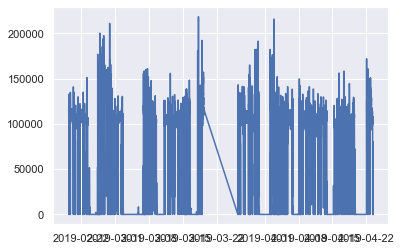

In [73]:
sns.set(font_scale=1)
plt.plot(df['W Total'])

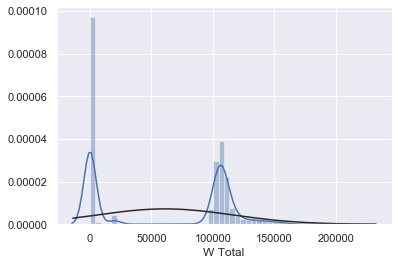

In [74]:
sns.distplot(df['W Total'] , fit=norm)

In [75]:
df['W Total'].quantile(0.45)

27753.628000001117

I am going to drop all the rows with Power measures < 50.000 W, because they are not representative of the power consumption of the machine

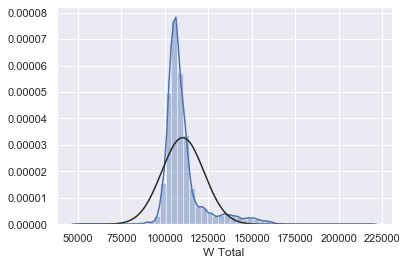

In [76]:
df = df.drop(df[df['W Total'] < 50000].index)

sns.distplot(df['W Total'] , fit=norm)

I am going to divide 'W Total' by 1000 so I have the Power measurements in kilowatts [kW]

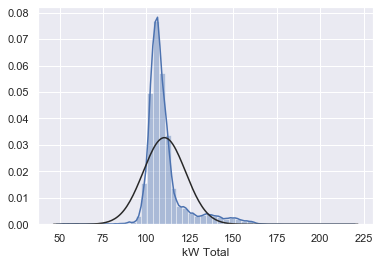

In [77]:
df['kW Total'] = df['W Total']/1000
df.drop(columns =['W Total'], inplace=True)

sns.distplot(df['kW Total'] , fit=norm)

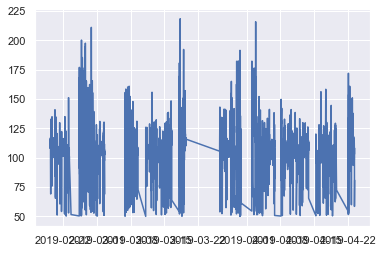

In [78]:
plt.plot(df['kW Total'])

In [79]:
df['kW Total'].describe()

count    132624.000000
mean        110.325416
std          12.180842
min          50.009460
25%         103.965605
50%         107.213070
75%         111.992015
max         218.230050
Name: kW Total, dtype: float64

In [80]:
df['kW Total'].median()

107.21307

### Categorical variables

#### Analyze by pivoting categorical features

##### Power vs Oil type

In [81]:
# Pivot Table

df_pt_oil = df[['Oil', 'kW Total']].groupby(['Oil'], as_index=False).agg(['median', 'count']).sort_values(by=('kW Total','count'), ascending=False)
df_pt_oil[('kW Total','%count')] = df_pt_oil[('kW Total','count')].transform(lambda x: x/x.sum())

df_pt_oil # as we can see, the samples are almost 50-50

kW Total                 
        median  count    %count
Oil                            
PR   106.95497  69843  0.526624
BL   107.52997  62781  0.473376

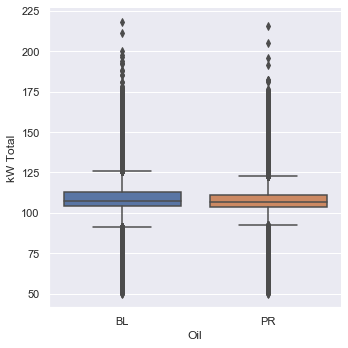

In [82]:
# Boxplot

sns.catplot(x='Oil', y='kW Total', kind='box', data=df)

##### Power vs Product type

In [83]:
# Pivot Table

df_pt_prod = df[['FÓRMULA', 'kW Total']].groupby(['FÓRMULA'], as_index=False).agg(['median', 'count']).sort_values(by=('kW Total','count'), ascending=False)
df_pt_prod[('kW Total','%count')] = df_pt_prod[('kW Total','count')].transform(lambda x: x/x.sum())

df_pt_prod

kW Total                 
                                       median  count    %count
FÓRMULA                                                       
DOG1_Grown_ExtrBulk_AR_2015        106.621990  55302  0.416986
DOG1_Puppy_ExtrBulk_AR             105.457700  14521  0.109491
DOG1_Grown_Small_Extr_AR_2017      106.224310  14346  0.108171
CAT1_Grown_Fish_ExtrBulk_2015      115.524095   9094  0.068570
CAT1_Grown_Meat_ExtrBulk_2015      140.801570   6863  0.051748
DOG1_Puppy_Small_Extr_AR_2017      107.283470   5319  0.040106
CAT2_MeatRiceCorn_ExtrBulk_AR      127.420225   5034  0.037957
CAT1_Deli_ExtrBulk_2015            102.291310   3717  0.028027
DOG1_Puppy_ExtrBulk_CL             104.873985   2396  0.018066
DOG1_Grown_ExtrBulk_CL_2015        104.484435   2350  0.017719
CAT2_FishRiceSpin_ExtrBulk_AR      133.191760   2191  0.016521
DOG1_MeatVeg_Extr_2018             111.779160   1739  0.013112
DOG1_Grown_Small_Extr_AR           104.920875   1440  0.010858
CAT2_FishRiceSpin_ExtrBulk_CL      127.312670   1367  0.010307
DOG1_Healthy_Extr_AR_2016          110.524790   1275  0.009614
DOG1_Grown_Small_ExtrBulk_CL_2015  104.222910   1189  0.008965
DOG1_Old_ExtrBulk_AR_2016          117.533490   1069  0.008060
DOG2_MeatCerRice_Extr_2018         116.321435    988  0.007450
CAT1_Grown_Healthy_Extr_2016       120.707140    953  0.007186
CAT2_MeatRiceCorn_ExtrBulk_CL       98.551400    786  0.005927
Stop                               105.281250    684  0.005157

In [84]:
# Products that account for the top 90% of the samples


print(df_pt_prod[('kW Total','%count')].head(11))
print(df_pt_prod[('kW Total','%count')].head(11).sum())

df_pt_prod_90 = df_pt_prod.index[:11] # save those products

FÓRMULA
DOG1_Grown_ExtrBulk_AR_2015      0.416986
DOG1_Puppy_ExtrBulk_AR           0.109491
DOG1_Grown_Small_Extr_AR_2017    0.108171
CAT1_Grown_Fish_ExtrBulk_2015    0.068570
CAT1_Grown_Meat_ExtrBulk_2015    0.051748
DOG1_Puppy_Small_Extr_AR_2017    0.040106
CAT2_MeatRiceCorn_ExtrBulk_AR    0.037957
CAT1_Deli_ExtrBulk_2015          0.028027
DOG1_Puppy_ExtrBulk_CL           0.018066
DOG1_Grown_ExtrBulk_CL_2015      0.017719
CAT2_FishRiceSpin_ExtrBulk_AR    0.016521
Name: (kW Total, %count), dtype: float64
0.9133634437465596


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20]),
 <a list of 21 Text xticklabel objects>)

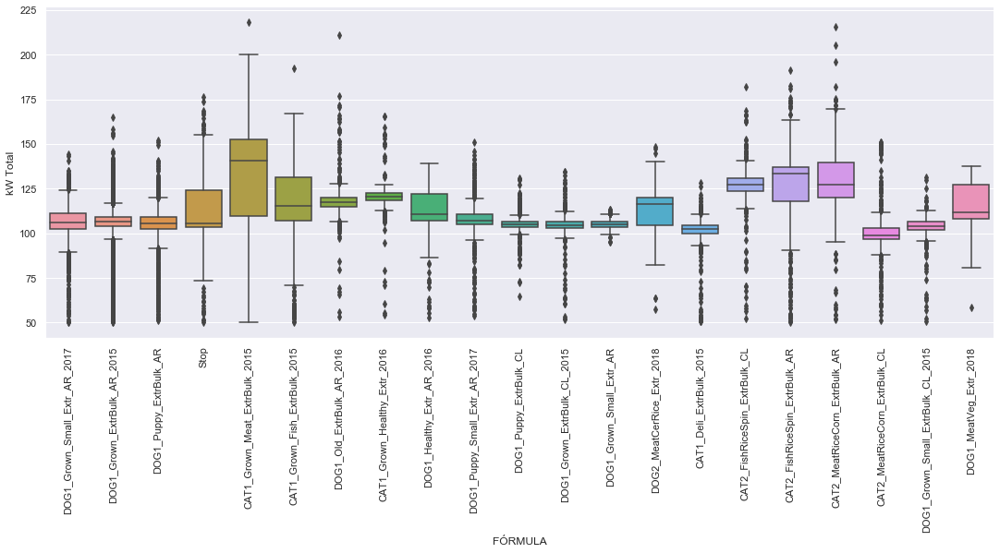

In [85]:
# Boxplot

# sns.set(rc={'figure.figsize':(20,10)})
g=sns.catplot(x='FÓRMULA', y='kW Total', kind='box', data=df)
g.fig.set_figheight(6)
g.fig.set_figwidth(30)
plt.xticks(rotation=90)

It seems like the following products have considerably more power consumption than the median, which is 107 kW:
* CAT1_Grown_Meat_ExtrBulk_2015 (mean Power: 141 kW)
* CAT2_MeatRiceCorn_ExtrBulk_AR (mean Power: 127 kW)
* CAT2_FishRiceSpin_ExtrBulk_AR (mean Power: 133 kW)
* CAT2_FishRiceSpin_ExtrBulk_CL (mean Power: 127 kW)
* CAT1_Grown_Healthy_Extr_2016 (mean Power: 121 kW)

They are all Cat Food products, so a possible insight is that Cat Food production has a superior energy consumption than Dog Food.

Now, according to what we've  got until now with the 'Product' categorical variable there are 4 possible paths for feature engineering:
1. Keep every category as is.
2. Keep only the categories that account for 90%+ of the data (11 categories).
3. Keep only a binary variable: Dog Food or Cat Food
4. Combination of 2 & 3: binary variable with the first 11 categories

I will explore every one of this options and see which one yields the best results.

In [86]:
df_pt_prod.index

Index(['DOG1_Grown_ExtrBulk_AR_2015', 'DOG1_Puppy_ExtrBulk_AR',
       'DOG1_Grown_Small_Extr_AR_2017', 'CAT1_Grown_Fish_ExtrBulk_2015',
       'CAT1_Grown_Meat_ExtrBulk_2015', 'DOG1_Puppy_Small_Extr_AR_2017',
       'CAT2_MeatRiceCorn_ExtrBulk_AR', 'CAT1_Deli_ExtrBulk_2015',
       'DOG1_Puppy_ExtrBulk_CL', 'DOG1_Grown_ExtrBulk_CL_2015',
       'CAT2_FishRiceSpin_ExtrBulk_AR', 'DOG1_MeatVeg_Extr_2018',
       'DOG1_Grown_Small_Extr_AR', 'CAT2_FishRiceSpin_ExtrBulk_CL',
       'DOG1_Healthy_Extr_AR_2016', 'DOG1_Grown_Small_ExtrBulk_CL_2015',
       'DOG1_Old_ExtrBulk_AR_2016', 'DOG2_MeatCerRice_Extr_2018',
       'CAT1_Grown_Healthy_Extr_2016', 'CAT2_MeatRiceCorn_ExtrBulk_CL',
       'Stop'],
      dtype='object', name='FÓRMULA')

##### Power vs (Product type , Oil)

Next, I am going to combine 'FORMULA' and 'Oil' Features to see how they both affect the Power 'kW Total'

In [87]:
# Pivot table with 'FORMULA' and 'Oil' as indexes, and 'kW Total' median and value counts as columns

df_pt_prod_oil = pd.pivot_table(df, index=['FÓRMULA','Oil'], values='kW Total', aggfunc=[np.median,len])
df_pt_prod_oil

,,median,len
,,kW Total,kW Total
FÓRMULA,Oil,,
CAT1_Deli_ExtrBulk_2015,PR,102.291310,3717.0
CAT1_Grown_Fish_ExtrBulk_2015,BL,115.524095,9094.0
CAT1_Grown_Healthy_Extr_2016,BL,120.707140,953.0
CAT1_Grown_Meat_ExtrBulk_2015,BL,140.801570,6863.0
CAT2_FishRiceSpin_ExtrBulk_AR,PR,133.191760,2191.0
CAT2_FishRiceSpin_ExtrBulk_CL,PR,127.312670,1367.0
CAT2_MeatRiceCorn_ExtrBulk_AR,PR,127.420225,5034.0
CAT2_MeatRiceCorn_ExtrBulk_CL,PR,98.551400,786.0


As we can see, not every 'FORMULA' category has measurements of both BL & PR Oils.

The only 'FORMULA' categories with measurements of both oils are:
* DOG1_Grown_ExtrBulk_AR_2015
* DOG1_Grown_ExtrBulk_CL_2015
* DOG1_Grown_Small_Extr_AR_2017	
* DOG1_Puppy_ExtrBulk_AR
* DOG1_Puppy_ExtrBulk_CL
* DOG1_Puppy_Small_Extr_AR_2017
* Stop (IRRELEVANT)

Now, this types of products are all Dog Food. If I want to use Cat Food products for the analysis I'll have to imput the missing data of the oils. Given that 'Oil' is a binary category I think that is kind of wrong. So I won't be using any category without measurements of both oils. That leaves only the 6 categories mentioned above ('Stop' will also go away as it means the machine is not producing). 

Thus, as all the remaining categories are Dog Food, there are 2 remaining options:
1. Keep every one of the 6 categories.
2. Keep only the categories that account for X%+ of the data (I'll have to recalculate).
3 y 4 are therefore not relevant anymore.

In [88]:
# Most relevant categories

df_pt_prod_def = [
        'DOG1_Grown_ExtrBulk_AR_2015',
        'DOG1_Grown_ExtrBulk_CL_2015',
        'DOG1_Grown_Small_Extr_AR_2017',
        'DOG1_Puppy_ExtrBulk_AR',
        'DOG1_Puppy_ExtrBulk_CL',
        'DOG1_Puppy_Small_Extr_AR_2017'
    ]

In [89]:
df_prep = df.loc[df['FÓRMULA'].isin(df_pt_prod_def)]

df_prep.head()

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,U3 RMS MIN,Vapor,Agua,Color,Ácido,Motor,Harina,FÓRMULA,Oil,kW Total
2019-02-19 09:30:00,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1.0,185.7,185.2,...,394.4,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL,114.76185
2019-02-19 09:30:20,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1.0,186.5,185.9,...,394.3,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL,115.01682
2019-02-19 09:30:40,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1.0,187.8,187.2,...,393.9,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL,115.98296
2019-02-19 09:31:00,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1.0,184.4,184.1,...,394.4,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL,113.87040
2019-02-19 09:31:20,49.96,398.4,397.6,397.9,229.7,230.5,229.0,1.0,185.4,185.3,...,394.7,90.215641,255.829874,37.784792,0.48122,251.829002,1505.11312,DOG1_Grown_Small_Extr_AR_2017,BL,114.59367


D:\anaconda3\lib\site-packages\seaborn\axisgrid.py:728: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


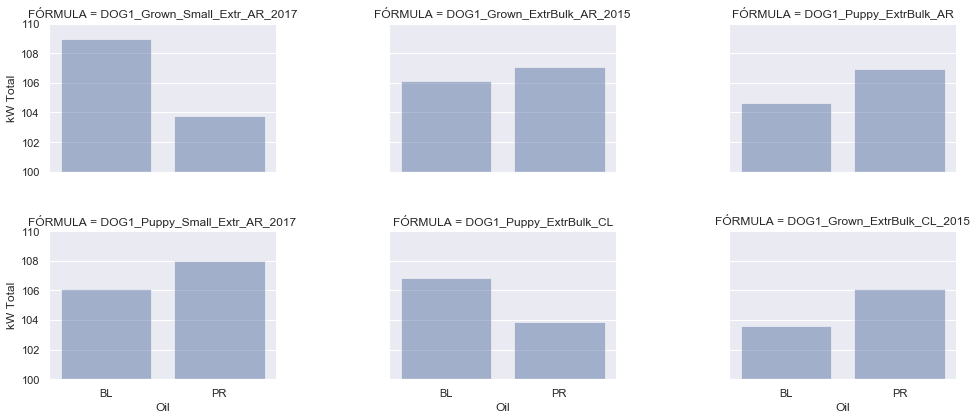

In [90]:
# Barplot to see the variation in the target (Power), with the categorical variables Product and Oil.

grid = sns.FacetGrid(df_prep, col='FÓRMULA', col_wrap=3, height=3, aspect=1.5)
grid.map(sns.barplot, 'Oil', 'kW Total', alpha=.5, ci=None)
grid.add_legend()
grid.set(ylim=(100, 110))
plt.subplots_adjust(hspace=0.4, wspace=0.5)

There's not a lot of insight I can take from the plots. Here are some thoughts:
* It is not clear that the 'Oil' variable influences the Power consumption of the different Products: BL Oil has less consumption in 4 Types of Product and PR Oil in the remaining 2.
* There doesn't seem to be much difference in the Power consumption of the different Product types, regarding Year (2015, 2017), Country (AR: Argentina, CL: Chile) and dog age (Grown, Puppy).
* There is an exception: 'DOG1_Grown_Small_Extr_AR_2017'. This Product has a much higher correlation between Power and the Oil variable: With BL Oil the Power consumption is much higher than the overall mean, and this is much lower with PR Oil.

### Numerical variables

In [91]:
df.columns[:-3]

Index(['Frequency', 'U1 RMS', 'U2 RMS', 'U3 RMS', 'V1 RMS', 'V2 RMS', 'V3 RMS',
       'VN RMS', 'A1 RMS', 'A2 RMS', 'A3 RMS', 'AN RMS', 'W1', 'W2', 'W3',
       'Wh1', 'Wh2', 'Wh3', 'Wh Total', 'var1', 'var2', 'var3', 'var Total',
       'varh1', 'varh2', 'varh3', 'varh Total', 'PF1', 'PF2', 'PF3', 'PF Mean',
       'Vunb(IEEE)', 'Aunb(IEEE)', 'Uunb(IEEE)', 'V1 RMS MAX', 'V2 RMS MAX',
       'V3 RMS MAX', 'VN RMS MAX', 'V1 RMS MIN', 'V2 RMS MIN', 'V3 RMS MIN',
       'VN RMS MIN', 'A1 RMS MAX', 'A2 RMS MAX', 'A3 RMS MAX', 'AN RMS MAX',
       'A1 RMS MIN', 'A2 RMS MIN', 'A3 RMS MIN', 'AN RMS MIN', 'U1 RMS MAX',
       'U2 RMS MAX', 'U3 RMS MAX', 'U1 RMS MIN', 'U2 RMS MIN', 'U3 RMS MIN',
       'Vapor', 'Agua', 'Color', 'Ácido', 'Motor', 'Harina'],
      dtype='object')

D:\anaconda3\lib\site-packages\seaborn\axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


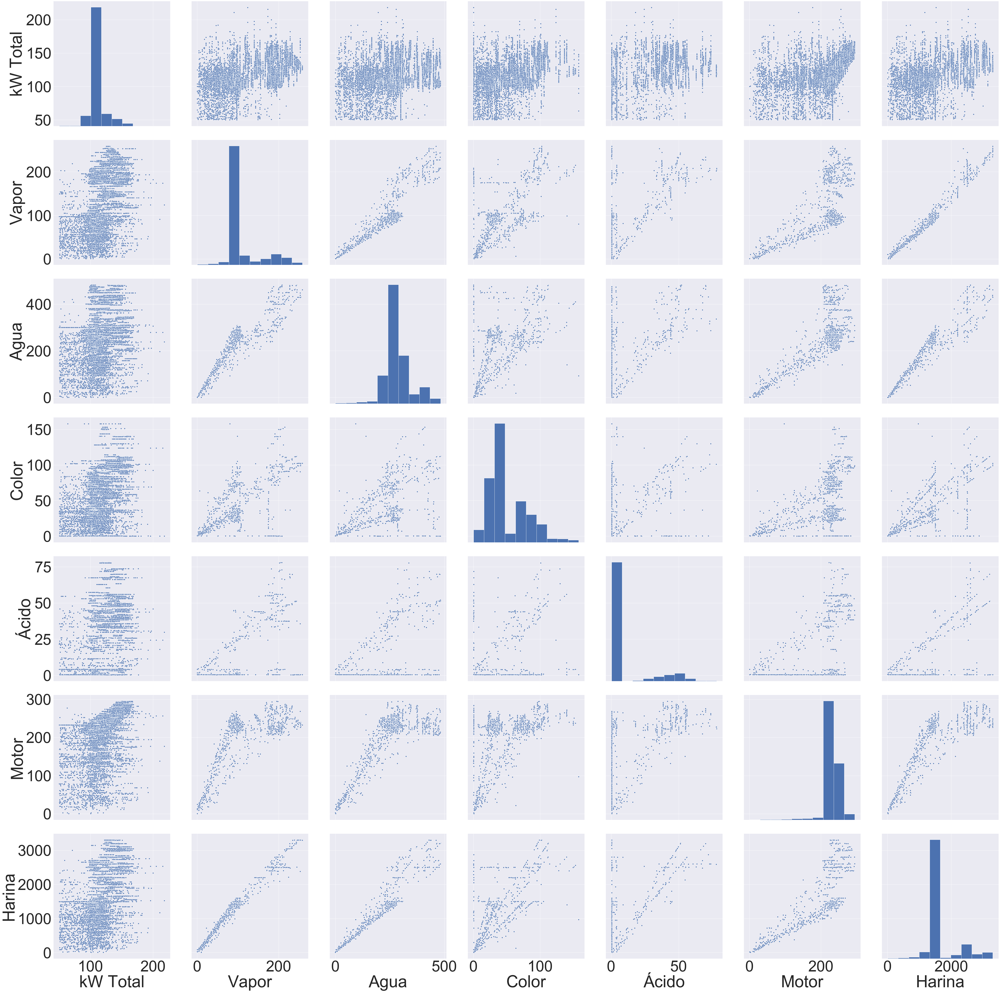

In [92]:
# Pairplots: Target 'kW Total' and Flowrate features

sns.set(font_scale=7)
num_cols = ['kW Total',
            'Vapor', 
            'Agua', 
            'Color', 
            'Ácido', 
            'Motor', 
            'Harina']
sns.pairplot(df[num_cols], size = 10)
# sns.set(font_scale=15)
# plt.show();

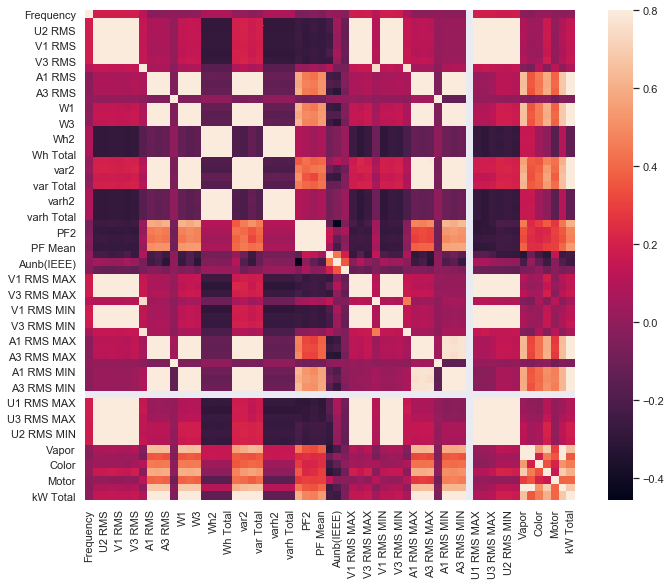

In [93]:
sns.set(font_scale=1)
corrmat = df.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True);

In [94]:
# Pairplots: Target 'kW Total' and electrical property features

sns.set(font_scale=7)
num_cols = ['kW Total',
            'Frequency', 
            'U1 RMS', 
            'V1 RMS', 
            'A1 RMS',
            'PF1',
            'PF Mean', 
            'V1 RMS MAX', 
            'V1 RMS MIN', 
            'A1 RMS MAX', 
            'A1 RMS MIN', 
            'U1 RMS MAX', 
            'U1 RMS MIN' 
#             'Vapor', 
#             'Agua', 
#             'Color', 
#             'Ácido', 
#             'Motor', 
#             'Harina'
           ]
sns.pairplot(df[num_cols], size = 10)

*Flowrate pairplots*
In the first pairplots we can see there is some positive correlation between the target 'kW Total' and all the other variables, which are different types of flowrates. 

Moreover, there is clear multicollinearity between the flowrate features. This means that all of them add pretty much the same information, so it would be incorrect to use all of them.

'Harina' is the flowrate of the Product flour that enters the extruder so it would be best to keep this variable and drop the other ones, since it is the most important one.

*Electrical properties pairplots*

The correlation between all the variables is clear and is due to the fact that we can calculate the Power of the $i$th phase as:

$
P_i = U_i.A_i.PF_i
$

The correlation of the Voltage (U, I) and current (A) variables with Power are mathematical due to the equation. It would not be correct to use them in a model.

PF variables are correlated but they can also be used to calculate the Motor %Load with feature engineering. Using them raw is similar to the current and voltage variables so that would also not be correct.

Frequency and kW Total could be keeped, but there doesn't seem to be any correlation with Power.

## 3. Prepare the Data

### Categorical variables

As seen in the previous section, there are two types of categorical variables:
* Product Type: 'FORMULA'
* Oil Type: 'Oil'

I will keep both types of 'Oil': 
* BL
* PR 

And the main 6 Product Types:
* DOG1_Grown_ExtrBulk_AR_2015
* DOG1_Grown_ExtrBulk_CL_2015
* DOG1_Grown_Small_Extr_AR_2017	
* DOG1_Puppy_ExtrBulk_AR
* DOG1_Puppy_ExtrBulk_CL
* DOG1_Puppy_Small_Extr_AR_2017

In [95]:
# Keep only the main Product Type categories from the 'Formula' feature

df = df.loc[df['FÓRMULA'].isin(df_pt_prod_def)]

In [96]:
# Encode categoricals using Get Dummies

df = pd.get_dummies(df)
df.head()

,Frequency,U1 RMS,U2 RMS,U3 RMS,V1 RMS,V2 RMS,V3 RMS,VN RMS,A1 RMS,A2 RMS,...,Harina,kW Total,FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015,FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015,FÓRMULA_DOG1_Grown_Small_Extr_AR_2017,FÓRMULA_DOG1_Puppy_ExtrBulk_AR,FÓRMULA_DOG1_Puppy_ExtrBulk_CL,FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017,Oil_BL,Oil_PR
2019-02-19 09:30:00,49.95,398.3,397.4,397.7,229.6,230.5,228.9,1.0,185.7,185.2,...,1505.11312,114.76185,0,0,1,0,0,0,1,0
2019-02-19 09:30:20,49.95,398.1,397.3,397.5,229.5,230.4,228.9,1.0,186.5,185.9,...,1505.11312,115.01682,0,0,1,0,0,0,1,0
2019-02-19 09:30:40,49.96,398.1,397.3,397.5,229.5,230.4,228.8,1.0,187.8,187.2,...,1505.11312,115.98296,0,0,1,0,0,0,1,0
2019-02-19 09:31:00,49.96,398.2,397.4,397.7,229.6,230.5,228.9,1.0,184.4,184.1,...,1505.11312,113.87040,0,0,1,0,0,0,1,0
2019-02-19 09:31:20,49.96,398.4,397.6,397.9,229.7,230.5,229.0,1.0,185.4,185.3,...,1505.11312,114.59367,0,0,1,0,0,0,1,0


### Numerical variables

In [97]:
df.columns

Index(['Frequency', 'U1 RMS', 'U2 RMS', 'U3 RMS', 'V1 RMS', 'V2 RMS', 'V3 RMS',
       'VN RMS', 'A1 RMS', 'A2 RMS', 'A3 RMS', 'AN RMS', 'W1', 'W2', 'W3',
       'Wh1', 'Wh2', 'Wh3', 'Wh Total', 'var1', 'var2', 'var3', 'var Total',
       'varh1', 'varh2', 'varh3', 'varh Total', 'PF1', 'PF2', 'PF3', 'PF Mean',
       'Vunb(IEEE)', 'Aunb(IEEE)', 'Uunb(IEEE)', 'V1 RMS MAX', 'V2 RMS MAX',
       'V3 RMS MAX', 'VN RMS MAX', 'V1 RMS MIN', 'V2 RMS MIN', 'V3 RMS MIN',
       'VN RMS MIN', 'A1 RMS MAX', 'A2 RMS MAX', 'A3 RMS MAX', 'AN RMS MAX',
       'A1 RMS MIN', 'A2 RMS MIN', 'A3 RMS MIN', 'AN RMS MIN', 'U1 RMS MAX',
       'U2 RMS MAX', 'U3 RMS MAX', 'U1 RMS MIN', 'U2 RMS MIN', 'U3 RMS MIN',
       'Vapor', 'Agua', 'Color', 'Ácido', 'Motor', 'Harina', 'kW Total',
       'FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015',
       'FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015',
       'FÓRMULA_DOG1_Grown_Small_Extr_AR_2017',
       'FÓRMULA_DOG1_Puppy_ExtrBulk_AR', 'FÓRMULA_DOG1_Puppy_ExtrBulk_CL',
       'FÓRMULA

In [98]:
# Keep only 'PF Mean' and 'Harina'features

cols_to_drop = ['Frequency', 'U1 RMS', 'U2 RMS', 'U3 RMS', 'V1 RMS', 'V2 RMS', 'V3 RMS',
       'VN RMS', 'A1 RMS', 'A2 RMS', 'A3 RMS', 'AN RMS', 'W1', 'W2', 'W3',
       'Wh1', 'Wh2', 'Wh3', 'Wh Total', 'var1', 'var2', 'var3', 'var Total',
       'varh1', 'varh2', 'varh3', 'varh Total', 'PF1', 'PF2', 'PF3',
       'Vunb(IEEE)', 'Aunb(IEEE)', 'Uunb(IEEE)', 'V1 RMS MAX', 'V2 RMS MAX',
       'V3 RMS MAX', 'VN RMS MAX', 'V1 RMS MIN', 'V2 RMS MIN', 'V3 RMS MIN',
       'VN RMS MIN', 'A1 RMS MAX', 'A2 RMS MAX', 'A3 RMS MAX', 'AN RMS MAX',
       'A1 RMS MIN', 'A2 RMS MIN', 'A3 RMS MIN', 'AN RMS MIN', 'U1 RMS MAX',
       'U2 RMS MAX', 'U3 RMS MAX', 'U1 RMS MIN', 'U2 RMS MIN', 'U3 RMS MIN',
       'Vapor', 'Agua', 'Color', 'Ácido', 'Motor']

df.drop(columns = cols_to_drop, inplace = True)
df.head()

,PF Mean,Harina,kW Total,FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015,FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015,FÓRMULA_DOG1_Grown_Small_Extr_AR_2017,FÓRMULA_DOG1_Puppy_ExtrBulk_AR,FÓRMULA_DOG1_Puppy_ExtrBulk_CL,FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017,Oil_BL,Oil_PR
2019-02-19 09:30:00,0.902,1505.11312,114.76185,0,0,1,0,0,0,1,0
2019-02-19 09:30:20,0.901,1505.11312,115.01682,0,0,1,0,0,0,1,0
2019-02-19 09:30:40,0.902,1505.11312,115.98296,0,0,1,0,0,0,1,0
2019-02-19 09:31:00,0.900,1505.11312,113.87040,0,0,1,0,0,0,1,0
2019-02-19 09:31:20,0.901,1505.11312,114.59367,0,0,1,0,0,0,1,0


#### Feature Engineering

I am going to add a feature which is an estimate (it is not the actual value) of the Motor Load Percentage, using the following equation for a sample $i$:

$
Load_i = 100.\frac{PF_i.Power_i}{PF_{MAX}.Power_{MAX}}
$

Then, I'll drop the PF feature

In [99]:
MAX_Power = df['kW Total'].max()
MAX_PF = df['PF Mean'].max()

In [100]:
df['Load'] = 100*(df['PF Mean']*df['kW Total'])/(MAX_PF*MAX_Power)
df.drop(columns = ['PF Mean'], inplace = True)
df.head()

,Harina,kW Total,FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015,FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015,FÓRMULA_DOG1_Grown_Small_Extr_AR_2017,FÓRMULA_DOG1_Puppy_ExtrBulk_AR,FÓRMULA_DOG1_Puppy_ExtrBulk_CL,FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017,Oil_BL,Oil_PR,Load
2019-02-19 09:30:00,1505.11312,114.76185,0,0,1,0,0,0,1,0,67.770521
2019-02-19 09:30:20,1505.11312,115.01682,0,0,1,0,0,0,1,0,67.845788
2019-02-19 09:30:40,1505.11312,115.98296,0,0,1,0,0,0,1,0,68.491625
2019-02-19 09:31:00,1505.11312,113.87040,0,0,1,0,0,0,1,0,67.094991
2019-02-19 09:31:20,1505.11312,114.59367,0,0,1,0,0,0,1,0,67.596182


D:\anaconda3\lib\site-packages\seaborn\axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


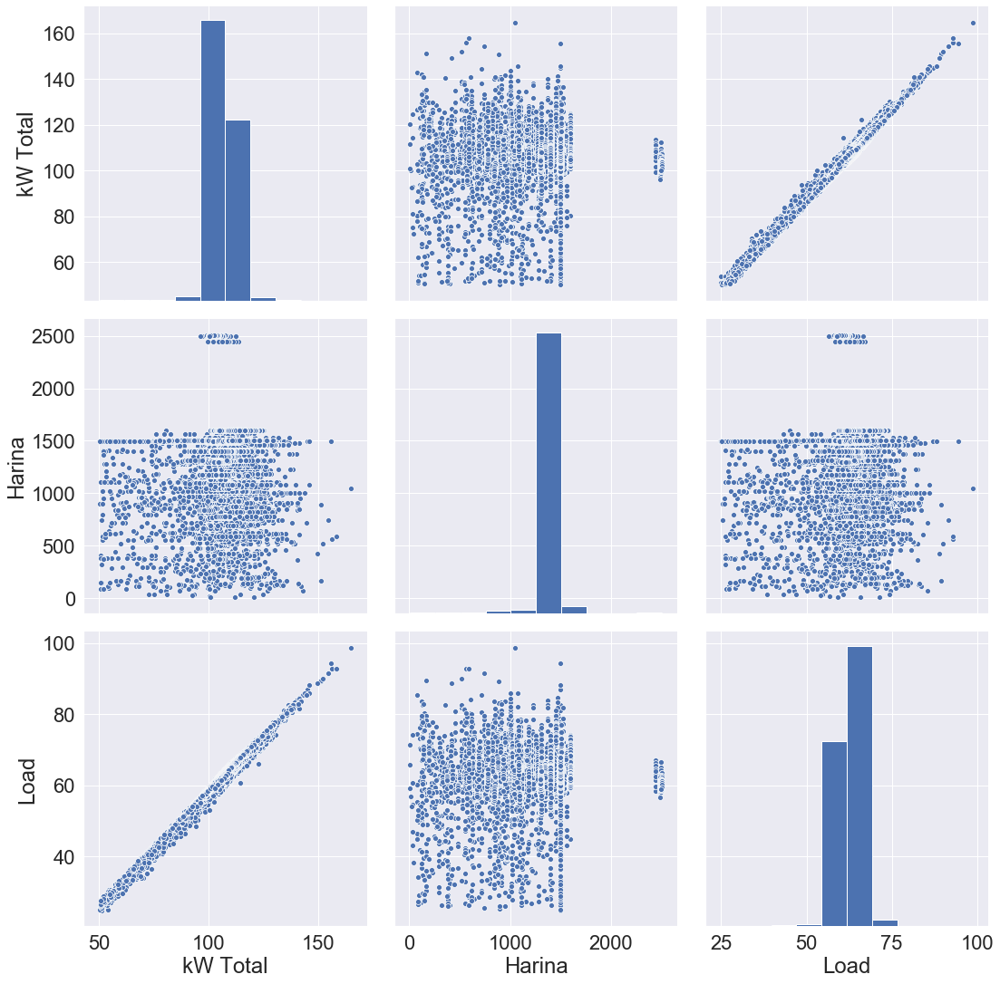

In [101]:
sns.set(font_scale=2)
sns.pairplot(df[['kW Total','Harina','Load']], size = 5)

In [102]:
# I don't think I can use Load as using a feature that uses the target doesn't seem right, it is too lineal as seen in the graph.

df.drop(columns = ['Load'], inplace = True)

In [103]:
# check null values

df.isna().sum()

Harina                                   0
kW Total                                 1
FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015      0
FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015      0
FÓRMULA_DOG1_Grown_Small_Extr_AR_2017    0
FÓRMULA_DOG1_Puppy_ExtrBulk_AR           0
FÓRMULA_DOG1_Puppy_ExtrBulk_CL           0
FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017    0
Oil_BL                                   0
Oil_PR                                   0
dtype: int64

In [104]:
# It is just 1 row so I'll delete it

df.dropna(inplace=True)
df.isna().sum()

Harina                                   0
kW Total                                 0
FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015      0
FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015      0
FÓRMULA_DOG1_Grown_Small_Extr_AR_2017    0
FÓRMULA_DOG1_Puppy_ExtrBulk_AR           0
FÓRMULA_DOG1_Puppy_ExtrBulk_CL           0
FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017    0
Oil_BL                                   0
Oil_PR                                   0
dtype: int64

In [105]:
# Shuffle rows to get random a 'Oil'in each sample. If I didn't do this, it would be all the 'BL' oil samples first and all the 'PR' oils after

from sklearn.utils import shuffle

df = shuffle(df)
df.head()

,Harina,kW Total,FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015,FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015,FÓRMULA_DOG1_Grown_Small_Extr_AR_2017,FÓRMULA_DOG1_Puppy_ExtrBulk_AR,FÓRMULA_DOG1_Puppy_ExtrBulk_CL,FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017,Oil_BL,Oil_PR
2019-02-21 19:51:40,1497.450975,104.02093,1,0,0,0,0,0,1,0
2019-03-27 03:12:00,1500.994905,104.58502,1,0,0,0,0,0,0,1
2019-04-05 20:52:20,1499.881944,104.86583,1,0,0,0,0,0,0,1
2019-03-14 07:46:00,1500.068159,101.98391,0,0,0,1,0,0,1,0
2019-02-22 01:06:00,1499.608294,105.82395,1,0,0,0,0,0,1,0


In [106]:
# Create train and test datasets

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df.drop('kW Total', axis=1), df['kW Total'], test_size=0.1, random_state=42)

X_test

,Harina,FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015,FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015,FÓRMULA_DOG1_Grown_Small_Extr_AR_2017,FÓRMULA_DOG1_Puppy_ExtrBulk_AR,FÓRMULA_DOG1_Puppy_ExtrBulk_CL,FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017,Oil_BL,Oil_PR
2019-03-15 12:19:40,1501.348258,0,0,0,1,0,0,1,0
2019-02-22 02:07:40,1505.701495,1,0,0,0,0,0,1,0
2019-03-02 13:42:20,1497.923290,1,0,0,0,0,0,1,0
2019-04-09 20:32:20,1602.261510,1,0,0,0,0,0,0,1
2019-03-15 12:44:40,1499.292309,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...
2019-02-21 04:17:40,1496.459088,1,0,0,0,0,0,1,0
2019-02-21 04:36:20,1496.599774,1,0,0,0,0,0,1,0
2019-03-26 16:59:40,1498.437631,0,1,0,0,0,0,0,1
2019-03-13 06:30:20,557.488305,0,1,0,0,0,0,1,0


In [107]:
# Create train and validation datasets from the train set

from sklearn.model_selection import train_test_split

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

## 4. Shortlist Promising Models

I am going to test this models:

* Multiple Linear Regression
* Random Forests
* XGBoost

Scoring: Root Mean Squared Error

In [108]:
# Import libraries

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler, MinMaxScaler
from sklearn.base import BaseEstimator, TransformerMixin, RegressorMixin, clone
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import reciprocal, uniform
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from xgboost import XGBRegressor

### Base models

* **Multiple Linear Regression:**

In [109]:
lm = make_pipeline(RobustScaler(), LinearRegression())

np.mean(-cross_val_score(lm, X_train, y_train, scoring = 'neg_root_mean_squared_error', cv= 5))

5.268383826643786

* **Random Forests:**

In [110]:
rf = RandomForestRegressor()

np.mean(-cross_val_score(rf, X_train, y_train, scoring = 'neg_root_mean_squared_error', cv= 5))

3.722333478036572

* **XGBoost:**

In [111]:
xgbr = xgb.XGBRegressor()

np.mean(-cross_val_score(xgbr, X_train, y_train, scoring = 'neg_root_mean_squared_error', cv= 5))

4.143578678025485

The best performing model was **Random Forests**. Usually, I have better results with **XGBoost** so I'll be fine tuning bothmodels to see which one is better overall.

## 5. Fine-Tune the Systems

### Random Forests

In [112]:
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]

# Number of features to consider at every split
max_features = ['auto', 'sqrt']

# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]

max_depth.append(None)
# Minimum number of samples required to split a node

min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node

min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree

bootstrap = [True, False]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

In [113]:
# Use the random grid to search for best hyperparameters

# First create the base model to tune
rf = RandomForestRegressor()

# Random search of parameters, using 5 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, 
                               param_distributions = random_grid, 
                               n_iter = 100, cv = 5, 
                               verbose=2, 
                               random_state=42)

# Fit the random search model
rf_random.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
[CV] END bootstrap=True, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  18.0s
[CV] END bootstrap=True, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  19.1s
[CV] END bootstrap=True, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  18.9s
[CV] END bootstrap=True, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  18.9s
[CV] END bootstrap=True, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  19.1s
[CV] END bootstrap=True, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=2000; total time=  43.2s
[CV] END bootstrap=True, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=2000; to

[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=2000; total time=  59.5s
[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=2000; total time= 1.0min
[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=2000; total time= 1.0min
[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=2000; total time= 1.0min
[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=2000; total time= 1.0min
[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1600; total time=  47.9s
[CV] END bootstrap=False, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1600; total time=  48.1s
[CV] END bootstrap=False, max

[CV] END bootstrap=False, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=1400; total time= 1.7min
[CV] END bootstrap=False, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=1400; total time= 1.6min
[CV] END bootstrap=False, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=1400; total time= 1.6min
[CV] END bootstrap=False, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=1400; total time= 1.6min
[CV] END bootstrap=False, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=1400; total time= 1.7min
[CV] END bootstrap=False, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=  28.0s
[CV] END bootstrap=False, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=  26.7s
[CV] END bootstrap=False, max_de

[CV] END bootstrap=True, max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1200; total time=  46.7s
[CV] END bootstrap=True, max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1200; total time=  47.0s
[CV] END bootstrap=True, max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1200; total time=  46.9s
[CV] END bootstrap=True, max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1200; total time=  46.7s
[CV] END bootstrap=True, max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1200; total time=  47.1s
[CV] END bootstrap=True, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=  40.2s
[CV] END bootstrap=True, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=  41.0s
[CV] END bootstrap=True, max_depth=100, m

[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=1200; total time= 1.4min
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=1200; total time= 1.4min
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=1200; total time= 1.4min
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=1200; total time= 1.4min
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=1200; total time= 1.5min
[CV] END bootstrap=False, max_depth=110, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=600; total time=  42.8s
[CV] END bootstrap=False, max_depth=110, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=600; total time=  40.5s
[CV] END bootstrap=False, max_dept

[CV] END bootstrap=True, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   9.6s
[CV] END bootstrap=True, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   9.9s
[CV] END bootstrap=True, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=400; total time=   8.6s
[CV] END bootstrap=True, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=400; total time=   8.5s
[CV] END bootstrap=True, max_depth=10, max_featu

[CV] END bootstrap=True, max_depth=60, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1800; total time= 1.5min
[CV] END bootstrap=True, max_depth=60, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1800; total time= 1.5min
[CV] END bootstrap=True, max_depth=60, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1800; total time= 1.5min
[CV] END bootstrap=True, max_depth=60, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1800; total time= 1.5min
[CV] END bootstrap=True, max_depth=60, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=1800; total time= 1.6min
[CV] END bootstrap=False, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  29.4s
[CV] END bootstrap=False, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=  32.0s
[CV] END bootstrap=False, max_depth=90, m

[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=800; total time=  59.4s
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=800; total time=  56.3s
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=800; total time=  56.9s
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=800; total time=  55.9s
[CV] END bootstrap=False, max_depth=70, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=800; total time= 1.0min
[CV] END bootstrap=False, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=600; total time=  42.7s
[CV] END bootstrap=False, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=600; total time=  41.8s
[CV] END bootstrap=False, max_depth=40,

[CV] END bootstrap=False, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  39.7s
[CV] END bootstrap=False, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  40.8s
[CV] END bootstrap=False, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  40.6s
[CV] END bootstrap=False, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  40.6s
[CV] END bootstrap=False, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  39.7s
[CV] END bootstrap=False, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=200; total time=  14.1s
[CV] END bootstrap=False, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=200; total time=  15.2s
[CV] END bootstrap=False, max_dept

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=100,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   random_state=42, verbose=2)

In [114]:
rf_random.best_params_

{'n_estimators': 400,
 'min_samples_split': 10,
 'min_samples_leaf': 4,
 'max_features': 'auto',
 'max_depth': 70,
 'bootstrap': True}

In [115]:
# RandomizedSearchCV best parameters:

r_search_best_params = {'n_estimators': 600,
 'min_samples_split': 5,
 'min_samples_leaf': 1,
 'max_features': 'auto',
 'max_depth': 80,
 'bootstrap': True}

In [116]:
# Function to evaluate the performance of the models

def evaluate(model, X_valid, y_valid):
    predictions = model.predict(X_valid)
    errors = abs(predictions - y_valid)
    mape = 100 * np.mean(errors / y_valid)
    accuracy = 100 - mape
    print('Model Performance')
    print('Average Error: {:0.4f} kW.'.format(np.mean(errors)))
    print('Accuracy = {:0.2f}%.'.format(accuracy))
    
    return accuracy

In [117]:
# Base Random Forest Model performance

base_model = RandomForestRegressor(random_state = 42)
base_model.fit(X_train, y_train)
base_accuracy = evaluate(base_model, X_valid, y_valid)

Model Performance
Average Error: 1.7961 kW.
Accuracy = 98.23%.


In [118]:
# RandomizedSearchCV Random Forest Model performance

best_random = rf_random.best_estimator_
random_accuracy = evaluate(best_random, X_valid, y_valid)

Model Performance
Average Error: 1.8009 kW.
Accuracy = 98.23%.


In [119]:
# Improvement of the Tweaked RandomizedSearchCV Model over the Base one

print('Improvement of {:0.2f}%.'.format( 100 * (random_accuracy - base_accuracy) / base_accuracy))

Improvement of -0.01%.


We can see that it didn't improve.

I am going to try some further tuning, now with **GridSearchCV**. I am going to use values around the best estimators from thr **RandomizedSearchCV** I used before.

In [120]:
from sklearn.model_selection import GridSearchCV

# Create the parameter grid based on the results of random search 
param_grid = {
    'bootstrap': [True],
    'max_depth': [75, 80, 85],
    'max_features': ['auto'],
    'min_samples_leaf': [1, 2],
    'min_samples_split': [4, 5, 6],
    'n_estimators': [500, 600, 700]
}

# Create a based model
rf = RandomForestRegressor()

# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 5, verbose = 2)

# Fit the random search model
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time=  25.1s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time=  25.7s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time=  25.6s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time=  25.6s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time=  26.5s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=600; total time=  30.2s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=600; total

[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time=  26.4s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time=  26.8s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time=  26.5s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time=  26.8s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time=  29.3s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=  31.9s
[CV] END bootstrap=True, max_depth=75, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=  31.8s
[CV] END bootstrap=True, max_depth=75, max_featu

[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=  25.7s
[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=  25.3s
[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=  25.4s
[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=  26.5s
[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=600; total time=  30.0s
[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=600; total time=  31.1s
[CV] END bootstrap=True, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=6, n_estimators=600; total time=  30.4s
[CV] END bootstrap=True, max_depth=80, max_featu

[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time= 1.2min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time= 1.2min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=500; total time= 1.3min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=600; total time= 1.4min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=1, min_samples_split=4, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_featu

[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time= 1.0min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=500; total time= 1.3min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time= 1.5min
[CV] END bootstrap=True, max_depth=85, max_featu

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [75, 80, 85],
                         'max_features': ['auto'], 'min_samples_leaf': [1, 2],
                         'min_samples_split': [4, 5, 6],
                         'n_estimators': [500, 600, 700]},
             verbose=2)

In [121]:
grid_search.best_params_

{'bootstrap': True,
 'max_depth': 85,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 6,
 'n_estimators': 500}

In [122]:
# GridSearchCV best parameters:

r_search_best_params = {'bootstrap': True,
 'max_depth': 80,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 6,
 'n_estimators': 500}

In [123]:
# GridSearchCV Random Forest Model performance

best_grid = grid_search.best_estimator_
grid_accuracy = evaluate(best_grid, X_valid, y_valid)

Model Performance
Average Error: 1.7946 kW.
Accuracy = 98.24%.


In [124]:
# Improvement of the Tweaked GridSearchCV Model over the Base one

print('Improvement of {:0.2f}%.'.format( 100 * (grid_accuracy - base_accuracy) / base_accuracy))

Improvement of 0.00%.


Again, the improvement is absouletly negligible. 

I'll keep the **GridSearchCV** model as the definitive one though.

### XGBoost

In [125]:
import xgboost as xgb
from xgboost import XGBRegressor
from xgboost import plot_importance

In [126]:
# Create training and validation set from the training data

X_train_train, X_train_validation, y_train_train, y_train_validation = train_test_split(X_train, y_train, test_size=0.2)

In [136]:
# Create function to train XGBoostRegressor model with early stopping, evaluating the RMSE from the validation set to obtain the optimum number of iterations

def model_fit(model, early_stopping_rounds, eval_metric = 'rmse'):
    
    # Fit model on the training set and evaluate on the validation set
    model.fit(X_train, y_train, 
            eval_set = [(X_train, y_train), 
                      (X_valid, y_valid)], 
            eval_metric = eval_metric,
            early_stopping_rounds = early_stopping_rounds)
    
    # Print optimum number of trees, best iteration (= #opt trees - 1) and best score from the Early Stopping Rounds
    print("---------------------------------------------\nModel Report")
    print("Optimum number of trees: %d" % model.best_ntree_limit)
    print("Best iteration: %d" % model.best_iteration)
    print("Best score: %d" % model.best_score)
    print("---------------------------------------------")
    
    # Plot best result
    results = model.evals_result()
    plt.figure(figsize=(10,7))
    plt.plot(results["validation_0"]["rmse"], label="Training RMSE")
    plt.plot(results["validation_1"]["rmse"], label="Validation RMSE")
    plt.axvline(model.best_ntree_limit, color="gray", label="Optimal tree number")
    plt.xlabel("Number of trees")
    plt.ylabel("RMSE")
    plt.legend()
    plt.rc('font', size=2)  
    
    # Plot Feature Importances
    plot_importance(model)

Tune every parameter with **RandomizedSearchCV**

In [128]:
# Define parameter grid
param_test = {
 'max_depth':range(1,10,2), # before was 5, now Grid Search on [1, 3, 5, 7, 9]; >max_depth --> >over-fitting
 'min_child_weight':range(1,6,2), # before was 1, now Grid Search on [1, 3, 5] ; >min_child_weight --> <over-fitting
 'gamma':[i/10.0 for i in range(0,5)], # gamma = [0, 0.1, 0.2, 0.3, 0.4]; the default is 0; >gamma means a > minimum loss reduction requirement to make a split (makes the algoritm more conservative)
 'subsample':[i/10.0 for i in range(6,10)], # [0.6, 0.7, 0.8, 0.9]
 'colsample_bytree':[i/10.0 for i in range(6,10)], # [0.6, 0.7, 0.8, 0.9] 
 'reg_alpha':[0, 1e-5, 1e-2, 0.1, 1, 100],
 'reg_lambda':[1, 10, 20, 50, 100, 1000],
 'learning_rate':[0.01, 0.05, 0.1, 0.5, 1]
}

# Fit model with RandomizedSearchCV to find optimum values of the parameter grid
xgbr = xgb.XGBRegressor( 
        objective='reg:squarederror',
        n_estimators=1000,
        max_depth=5,
        min_child_weight=1, 
        gamma=0, 
        subsample=0.8, 
        colsample_bytree=0.8, 
        reg_alpha=0, 
        reg_lambda=1,
        scale_pos_weight=1,
        seed=10)

rsearch_xgbr = RandomizedSearchCV(xgbr,
    param_test, 
    scoring='neg_root_mean_squared_error',   
    cv=5,
    verbose=True)

rsearch_xgbr.fit(X_train, y_train)
rsearch_xgbr.cv_results_, rsearch_xgbr.best_params_, rsearch_xgbr.best_score_

Fitting 5 folds for each of 10 candidates, totalling 50 fits


({'mean_fit_time': array([10.3954958 , 10.92408595, 10.96567245, 22.00404143, 17.55167551,
         22.46193719, 16.81723242, 19.75340462, 16.93123817, 16.88976159]),
  'std_fit_time': array([0.30389633, 0.25841995, 0.3242155 , 0.03418545, 0.04060156,
         0.03697047, 0.06504717, 0.03349666, 0.00399633, 0.03504205]),
  'mean_score_time': array([0.01515994, 0.01615772, 0.01515985, 0.05544562, 0.03808165,
         0.06920495, 0.03031015, 0.04544449, 0.03967595, 0.03527832]),
  'std_score_time': array([0.00342012, 0.00364499, 0.0028489 , 0.00048292, 0.00439648,
         0.01431347, 0.00079082, 0.00100771, 0.01007323, 0.00049798]),
  'param_subsample': masked_array(data=[0.8, 0.8, 0.7, 0.8, 0.7, 0.9, 0.6, 0.8, 0.8, 0.8],
               mask=[False, False, False, False, False, False, False, False,
                     False, False],
         fill_value='?',
              dtype=object),
  'param_reg_lambda': masked_array(data=[1000, 1, 100, 1, 50, 10, 50, 10, 10, 20],
               mask

In [129]:
rsearch_xgbr.best_params_

{'subsample': 0.7,
 'reg_lambda': 50,
 'reg_alpha': 1e-05,
 'min_child_weight': 5,
 'max_depth': 5,
 'learning_rate': 1,
 'gamma': 0.0,
 'colsample_bytree': 0.7}

In [130]:
rsearch_xgbr_best_params = {'subsample': 0.8,
 'reg_lambda': 50,
 'reg_alpha': 0.01,
 'min_child_weight': 5,
 'max_depth': 9,
 'learning_rate': 1,
 'gamma': 0.2,
 'colsample_bytree': 0.8}

[0]	validation_0-rmse:5.33292	validation_1-rmse:5.29775
[1]	validation_0-rmse:4.89921	validation_1-rmse:4.86352
[2]	validation_0-rmse:4.88644	validation_1-rmse:4.85766
[3]	validation_0-rmse:4.88363	validation_1-rmse:4.85662
[4]	validation_0-rmse:4.75417	validation_1-rmse:4.73060
[5]	validation_0-rmse:4.72292	validation_1-rmse:4.70743
[6]	validation_0-rmse:4.71840	validation_1-rmse:4.70693
[7]	validation_0-rmse:4.69597	validation_1-rmse:4.69895
[8]	validation_0-rmse:4.67896	validation_1-rmse:4.66568
[9]	validation_0-rmse:4.67869	validation_1-rmse:4.66381
[10]	validation_0-rmse:4.67853	validation_1-rmse:4.66509
[11]	validation_0-rmse:4.65297	validation_1-rmse:4.65719
[12]	validation_0-rmse:4.65300	validation_1-rmse:4.65556
[13]	validation_0-rmse:4.64117	validation_1-rmse:4.64824
[14]	validation_0-rmse:4.61829	validation_1-rmse:4.62162
[15]	validation_0-rmse:4.59550	validation_1-rmse:4.59344
[16]	validation_0-rmse:4.59503	validation_1-rmse:4.59231
[17]	validation_0-rmse:4.59520	validation

[144]	validation_0-rmse:4.31356	validation_1-rmse:4.34112
[145]	validation_0-rmse:4.31337	validation_1-rmse:4.34453
[146]	validation_0-rmse:4.31425	validation_1-rmse:4.33886
[147]	validation_0-rmse:4.31411	validation_1-rmse:4.33941
[148]	validation_0-rmse:4.31250	validation_1-rmse:4.33850
[149]	validation_0-rmse:4.31263	validation_1-rmse:4.33956
[150]	validation_0-rmse:4.31280	validation_1-rmse:4.33923
[151]	validation_0-rmse:4.31314	validation_1-rmse:4.34562
[152]	validation_0-rmse:4.30940	validation_1-rmse:4.33421
[153]	validation_0-rmse:4.30999	validation_1-rmse:4.32744
[154]	validation_0-rmse:4.31005	validation_1-rmse:4.33020
[155]	validation_0-rmse:4.30185	validation_1-rmse:4.32048
[156]	validation_0-rmse:4.29872	validation_1-rmse:4.31719
[157]	validation_0-rmse:4.29852	validation_1-rmse:4.31641
[158]	validation_0-rmse:4.29859	validation_1-rmse:4.31614
[159]	validation_0-rmse:4.29875	validation_1-rmse:4.31386
[160]	validation_0-rmse:4.29861	validation_1-rmse:4.31149
[161]	validati

[286]	validation_0-rmse:4.18520	validation_1-rmse:4.22233
[287]	validation_0-rmse:4.18528	validation_1-rmse:4.22205
[288]	validation_0-rmse:4.18522	validation_1-rmse:4.22291
[289]	validation_0-rmse:4.18629	validation_1-rmse:4.22011
[290]	validation_0-rmse:4.18628	validation_1-rmse:4.21869
[291]	validation_0-rmse:4.18616	validation_1-rmse:4.22607
[292]	validation_0-rmse:4.18627	validation_1-rmse:4.24141
[293]	validation_0-rmse:4.18608	validation_1-rmse:4.23566
[294]	validation_0-rmse:4.18693	validation_1-rmse:4.23303
[295]	validation_0-rmse:4.18536	validation_1-rmse:4.22961
[296]	validation_0-rmse:4.18311	validation_1-rmse:4.21514
[297]	validation_0-rmse:4.17929	validation_1-rmse:4.22278
[298]	validation_0-rmse:4.18030	validation_1-rmse:4.22352
[299]	validation_0-rmse:4.18027	validation_1-rmse:4.22283
[300]	validation_0-rmse:4.18037	validation_1-rmse:4.23039
[301]	validation_0-rmse:4.17689	validation_1-rmse:4.22305
[302]	validation_0-rmse:4.17696	validation_1-rmse:4.22350
[303]	validati

[428]	validation_0-rmse:4.09854	validation_1-rmse:4.18158
[429]	validation_0-rmse:4.09701	validation_1-rmse:4.17832
[430]	validation_0-rmse:4.09699	validation_1-rmse:4.17888
[431]	validation_0-rmse:4.09841	validation_1-rmse:4.18889
[432]	validation_0-rmse:4.09799	validation_1-rmse:4.18314
[433]	validation_0-rmse:4.09800	validation_1-rmse:4.18385
[434]	validation_0-rmse:4.09789	validation_1-rmse:4.18342
[435]	validation_0-rmse:4.09826	validation_1-rmse:4.18247
[436]	validation_0-rmse:4.09185	validation_1-rmse:4.16640
[437]	validation_0-rmse:4.09208	validation_1-rmse:4.16924
[438]	validation_0-rmse:4.09205	validation_1-rmse:4.16868
[439]	validation_0-rmse:4.09144	validation_1-rmse:4.17035
[440]	validation_0-rmse:4.09077	validation_1-rmse:4.17059
[441]	validation_0-rmse:4.09032	validation_1-rmse:4.17120
[442]	validation_0-rmse:4.08914	validation_1-rmse:4.16634
[443]	validation_0-rmse:4.08920	validation_1-rmse:4.16574
[444]	validation_0-rmse:4.08821	validation_1-rmse:4.16205
[445]	validati

[570]	validation_0-rmse:4.04469	validation_1-rmse:4.12841
[571]	validation_0-rmse:4.04564	validation_1-rmse:4.13863
[572]	validation_0-rmse:4.04450	validation_1-rmse:4.13113
[573]	validation_0-rmse:4.04480	validation_1-rmse:4.12839
[574]	validation_0-rmse:4.04481	validation_1-rmse:4.12904
[575]	validation_0-rmse:4.04528	validation_1-rmse:4.13129
[576]	validation_0-rmse:4.04526	validation_1-rmse:4.12941
[577]	validation_0-rmse:4.04526	validation_1-rmse:4.12820
[578]	validation_0-rmse:4.04526	validation_1-rmse:4.12806
[579]	validation_0-rmse:4.04448	validation_1-rmse:4.13542
[580]	validation_0-rmse:4.04441	validation_1-rmse:4.13620
[581]	validation_0-rmse:4.04317	validation_1-rmse:4.13881
[582]	validation_0-rmse:4.04374	validation_1-rmse:4.13176
[583]	validation_0-rmse:4.04316	validation_1-rmse:4.13307
[584]	validation_0-rmse:4.04092	validation_1-rmse:4.14065
[585]	validation_0-rmse:4.04095	validation_1-rmse:4.14002
[586]	validation_0-rmse:4.04024	validation_1-rmse:4.13770
[587]	validati

[712]	validation_0-rmse:3.99876	validation_1-rmse:4.10064
[713]	validation_0-rmse:3.99870	validation_1-rmse:4.10141
[714]	validation_0-rmse:3.99791	validation_1-rmse:4.11547
[715]	validation_0-rmse:3.99535	validation_1-rmse:4.10163
[716]	validation_0-rmse:3.99538	validation_1-rmse:4.10117
[717]	validation_0-rmse:3.99537	validation_1-rmse:4.10164
[718]	validation_0-rmse:3.99501	validation_1-rmse:4.09773
[719]	validation_0-rmse:3.99503	validation_1-rmse:4.09912
[720]	validation_0-rmse:3.99524	validation_1-rmse:4.10375
[721]	validation_0-rmse:3.99027	validation_1-rmse:4.08730
[722]	validation_0-rmse:3.99032	validation_1-rmse:4.08755
[723]	validation_0-rmse:3.99010	validation_1-rmse:4.09498
[724]	validation_0-rmse:3.98923	validation_1-rmse:4.08810
[725]	validation_0-rmse:3.98788	validation_1-rmse:4.08517
[726]	validation_0-rmse:3.98827	validation_1-rmse:4.09165
[727]	validation_0-rmse:3.98764	validation_1-rmse:4.09750
[728]	validation_0-rmse:3.98757	validation_1-rmse:4.09616
[729]	validati

[854]	validation_0-rmse:3.94518	validation_1-rmse:4.03671
[855]	validation_0-rmse:3.94512	validation_1-rmse:4.03613
[856]	validation_0-rmse:3.94519	validation_1-rmse:4.03612
[857]	validation_0-rmse:3.94523	validation_1-rmse:4.03893
[858]	validation_0-rmse:3.94239	validation_1-rmse:4.03704
[859]	validation_0-rmse:3.94128	validation_1-rmse:4.03129
[860]	validation_0-rmse:3.94131	validation_1-rmse:4.03174
[861]	validation_0-rmse:3.94199	validation_1-rmse:4.03525
[862]	validation_0-rmse:3.94181	validation_1-rmse:4.03592
[863]	validation_0-rmse:3.94163	validation_1-rmse:4.03472
[864]	validation_0-rmse:3.94022	validation_1-rmse:4.04284
[865]	validation_0-rmse:3.94021	validation_1-rmse:4.04268
[866]	validation_0-rmse:3.94176	validation_1-rmse:4.03253
[867]	validation_0-rmse:3.94106	validation_1-rmse:4.02847
[868]	validation_0-rmse:3.94198	validation_1-rmse:4.02628
[869]	validation_0-rmse:3.94019	validation_1-rmse:4.03340
[870]	validation_0-rmse:3.93939	validation_1-rmse:4.02675
[871]	validati

[996]	validation_0-rmse:3.91334	validation_1-rmse:4.02126
[997]	validation_0-rmse:3.91307	validation_1-rmse:4.01615
[998]	validation_0-rmse:3.91248	validation_1-rmse:4.00449
[999]	validation_0-rmse:3.91165	validation_1-rmse:4.01240
[1000]	validation_0-rmse:3.91048	validation_1-rmse:4.00511
[1001]	validation_0-rmse:3.90988	validation_1-rmse:4.00935
[1002]	validation_0-rmse:3.90915	validation_1-rmse:4.01361
[1003]	validation_0-rmse:3.90913	validation_1-rmse:4.01397
[1004]	validation_0-rmse:3.90870	validation_1-rmse:4.01097
[1005]	validation_0-rmse:3.90874	validation_1-rmse:4.01026
[1006]	validation_0-rmse:3.90901	validation_1-rmse:4.01360
[1007]	validation_0-rmse:3.90900	validation_1-rmse:4.01388
[1008]	validation_0-rmse:3.90902	validation_1-rmse:4.01358
[1009]	validation_0-rmse:3.90902	validation_1-rmse:4.01466
[1010]	validation_0-rmse:3.91033	validation_1-rmse:4.00955
[1011]	validation_0-rmse:3.90855	validation_1-rmse:4.01207
[1012]	validation_0-rmse:3.90853	validation_1-rmse:4.01122
[

[1135]	validation_0-rmse:3.88539	validation_1-rmse:3.96602
[1136]	validation_0-rmse:3.88316	validation_1-rmse:3.97350
[1137]	validation_0-rmse:3.88294	validation_1-rmse:3.97175
[1138]	validation_0-rmse:3.88437	validation_1-rmse:3.97335
[1139]	validation_0-rmse:3.88151	validation_1-rmse:3.97264
[1140]	validation_0-rmse:3.88231	validation_1-rmse:3.97414
[1141]	validation_0-rmse:3.88225	validation_1-rmse:3.97584
[1142]	validation_0-rmse:3.88160	validation_1-rmse:3.97929
[1143]	validation_0-rmse:3.88247	validation_1-rmse:3.98543
[1144]	validation_0-rmse:3.88237	validation_1-rmse:3.98365
[1145]	validation_0-rmse:3.88220	validation_1-rmse:3.97503
[1146]	validation_0-rmse:3.88187	validation_1-rmse:3.97239
[1147]	validation_0-rmse:3.88022	validation_1-rmse:3.97040
[1148]	validation_0-rmse:3.87880	validation_1-rmse:3.96991
[1149]	validation_0-rmse:3.88008	validation_1-rmse:3.97882
[1150]	validation_0-rmse:3.88126	validation_1-rmse:3.96936
[1151]	validation_0-rmse:3.88125	validation_1-rmse:3.970

[1274]	validation_0-rmse:3.85742	validation_1-rmse:3.95304
[1275]	validation_0-rmse:3.85736	validation_1-rmse:3.95142
[1276]	validation_0-rmse:3.85462	validation_1-rmse:3.94586
[1277]	validation_0-rmse:3.85421	validation_1-rmse:3.94099
[1278]	validation_0-rmse:3.85418	validation_1-rmse:3.94270
[1279]	validation_0-rmse:3.85449	validation_1-rmse:3.94528
[1280]	validation_0-rmse:3.85450	validation_1-rmse:3.94325
[1281]	validation_0-rmse:3.85431	validation_1-rmse:3.94320
[1282]	validation_0-rmse:3.85449	validation_1-rmse:3.94259
[1283]	validation_0-rmse:3.85450	validation_1-rmse:3.94402
[1284]	validation_0-rmse:3.85608	validation_1-rmse:3.93552
[1285]	validation_0-rmse:3.85603	validation_1-rmse:3.93465
[1286]	validation_0-rmse:3.85461	validation_1-rmse:3.93471
[1287]	validation_0-rmse:3.85530	validation_1-rmse:3.93180
[1288]	validation_0-rmse:3.85514	validation_1-rmse:3.93477
[1289]	validation_0-rmse:3.85428	validation_1-rmse:3.93031
[1290]	validation_0-rmse:3.85495	validation_1-rmse:3.928

[1413]	validation_0-rmse:3.83666	validation_1-rmse:3.90499
[1414]	validation_0-rmse:3.83606	validation_1-rmse:3.91301
[1415]	validation_0-rmse:3.83446	validation_1-rmse:3.91272
[1416]	validation_0-rmse:3.83440	validation_1-rmse:3.91373
[1417]	validation_0-rmse:3.83395	validation_1-rmse:3.91617
[1418]	validation_0-rmse:3.83401	validation_1-rmse:3.91359
[1419]	validation_0-rmse:3.83374	validation_1-rmse:3.92487
[1420]	validation_0-rmse:3.83379	validation_1-rmse:3.93275
[1421]	validation_0-rmse:3.83376	validation_1-rmse:3.93232
[1422]	validation_0-rmse:3.83299	validation_1-rmse:3.92244
[1423]	validation_0-rmse:3.83305	validation_1-rmse:3.92958
[1424]	validation_0-rmse:3.83313	validation_1-rmse:3.92975
[1425]	validation_0-rmse:3.83186	validation_1-rmse:3.92627
[1426]	validation_0-rmse:3.83115	validation_1-rmse:3.92752
[1427]	validation_0-rmse:3.83222	validation_1-rmse:3.92633
[1428]	validation_0-rmse:3.83397	validation_1-rmse:3.92077
[1429]	validation_0-rmse:3.83398	validation_1-rmse:3.921

[1552]	validation_0-rmse:3.81969	validation_1-rmse:3.89832
[1553]	validation_0-rmse:3.81954	validation_1-rmse:3.90205
[1554]	validation_0-rmse:3.81951	validation_1-rmse:3.90274
[1555]	validation_0-rmse:3.81944	validation_1-rmse:3.90222
[1556]	validation_0-rmse:3.81819	validation_1-rmse:3.89914
[1557]	validation_0-rmse:3.81820	validation_1-rmse:3.89513
[1558]	validation_0-rmse:3.81821	validation_1-rmse:3.89575
[1559]	validation_0-rmse:3.81807	validation_1-rmse:3.88990
[1560]	validation_0-rmse:3.81932	validation_1-rmse:3.89800
[1561]	validation_0-rmse:3.81876	validation_1-rmse:3.88631
[1562]	validation_0-rmse:3.81885	validation_1-rmse:3.88707
[1563]	validation_0-rmse:3.81754	validation_1-rmse:3.89695
[1564]	validation_0-rmse:3.81740	validation_1-rmse:3.89422
[1565]	validation_0-rmse:3.81740	validation_1-rmse:3.89481
[1566]	validation_0-rmse:3.81734	validation_1-rmse:3.89369
[1567]	validation_0-rmse:3.81730	validation_1-rmse:3.89288
[1568]	validation_0-rmse:3.81735	validation_1-rmse:3.893

[1691]	validation_0-rmse:3.80090	validation_1-rmse:3.90525
[1692]	validation_0-rmse:3.80041	validation_1-rmse:3.89446
[1693]	validation_0-rmse:3.80111	validation_1-rmse:3.89640
[1694]	validation_0-rmse:3.80167	validation_1-rmse:3.89284
[1695]	validation_0-rmse:3.80060	validation_1-rmse:3.90729
[1696]	validation_0-rmse:3.80058	validation_1-rmse:3.90583
[1697]	validation_0-rmse:3.80071	validation_1-rmse:3.90677
[1698]	validation_0-rmse:3.79923	validation_1-rmse:3.90901
[1699]	validation_0-rmse:3.80060	validation_1-rmse:3.91409
[1700]	validation_0-rmse:3.79935	validation_1-rmse:3.91677
[1701]	validation_0-rmse:3.79793	validation_1-rmse:3.90297
[1702]	validation_0-rmse:3.79785	validation_1-rmse:3.90232
[1703]	validation_0-rmse:3.79621	validation_1-rmse:3.90455
[1704]	validation_0-rmse:3.79624	validation_1-rmse:3.90473
[1705]	validation_0-rmse:3.79625	validation_1-rmse:3.90534
[1706]	validation_0-rmse:3.79623	validation_1-rmse:3.90312
[1707]	validation_0-rmse:3.79616	validation_1-rmse:3.907

[1830]	validation_0-rmse:3.78300	validation_1-rmse:3.86588
[1831]	validation_0-rmse:3.78192	validation_1-rmse:3.86502
[1832]	validation_0-rmse:3.78196	validation_1-rmse:3.86711
[1833]	validation_0-rmse:3.78236	validation_1-rmse:3.86615
[1834]	validation_0-rmse:3.78242	validation_1-rmse:3.86632
[1835]	validation_0-rmse:3.78236	validation_1-rmse:3.86548
[1836]	validation_0-rmse:3.78322	validation_1-rmse:3.86190
[1837]	validation_0-rmse:3.78327	validation_1-rmse:3.86147
[1838]	validation_0-rmse:3.78516	validation_1-rmse:3.86293
[1839]	validation_0-rmse:3.78508	validation_1-rmse:3.86356
[1840]	validation_0-rmse:3.78243	validation_1-rmse:3.86602
[1841]	validation_0-rmse:3.78239	validation_1-rmse:3.86588
[1842]	validation_0-rmse:3.78321	validation_1-rmse:3.86247
[1843]	validation_0-rmse:3.78325	validation_1-rmse:3.86173
[1844]	validation_0-rmse:3.78276	validation_1-rmse:3.85915
[1845]	validation_0-rmse:3.78252	validation_1-rmse:3.86659
[1846]	validation_0-rmse:3.78212	validation_1-rmse:3.876

[1969]	validation_0-rmse:3.77223	validation_1-rmse:3.85688
[1970]	validation_0-rmse:3.77075	validation_1-rmse:3.86155
[1971]	validation_0-rmse:3.77052	validation_1-rmse:3.86694
[1972]	validation_0-rmse:3.77024	validation_1-rmse:3.85921
[1973]	validation_0-rmse:3.77027	validation_1-rmse:3.85795
[1974]	validation_0-rmse:3.76861	validation_1-rmse:3.86127
[1975]	validation_0-rmse:3.77011	validation_1-rmse:3.86247
[1976]	validation_0-rmse:3.77016	validation_1-rmse:3.86258
[1977]	validation_0-rmse:3.76927	validation_1-rmse:3.86791
[1978]	validation_0-rmse:3.76795	validation_1-rmse:3.86639
[1979]	validation_0-rmse:3.76864	validation_1-rmse:3.85799
[1980]	validation_0-rmse:3.76803	validation_1-rmse:3.86734
[1981]	validation_0-rmse:3.76954	validation_1-rmse:3.86877
[1982]	validation_0-rmse:3.76841	validation_1-rmse:3.86772
[1983]	validation_0-rmse:3.76830	validation_1-rmse:3.86799
[1984]	validation_0-rmse:3.76874	validation_1-rmse:3.86935
[1985]	validation_0-rmse:3.76874	validation_1-rmse:3.868

[2108]	validation_0-rmse:3.76367	validation_1-rmse:3.84412
[2109]	validation_0-rmse:3.76280	validation_1-rmse:3.84182
[2110]	validation_0-rmse:3.76229	validation_1-rmse:3.84746
[2111]	validation_0-rmse:3.76186	validation_1-rmse:3.84645
[2112]	validation_0-rmse:3.76184	validation_1-rmse:3.84765
[2113]	validation_0-rmse:3.76184	validation_1-rmse:3.84730
[2114]	validation_0-rmse:3.76176	validation_1-rmse:3.84965
[2115]	validation_0-rmse:3.76265	validation_1-rmse:3.84888
[2116]	validation_0-rmse:3.76268	validation_1-rmse:3.84815
[2117]	validation_0-rmse:3.76255	validation_1-rmse:3.84027
[2118]	validation_0-rmse:3.76317	validation_1-rmse:3.83249
[2119]	validation_0-rmse:3.76195	validation_1-rmse:3.83317
[2120]	validation_0-rmse:3.76183	validation_1-rmse:3.83298
[2121]	validation_0-rmse:3.76073	validation_1-rmse:3.84174
[2122]	validation_0-rmse:3.76069	validation_1-rmse:3.83076
[2123]	validation_0-rmse:3.76131	validation_1-rmse:3.82729
[2124]	validation_0-rmse:3.76197	validation_1-rmse:3.848

[2247]	validation_0-rmse:3.75223	validation_1-rmse:3.84203
[2248]	validation_0-rmse:3.75229	validation_1-rmse:3.84137
[2249]	validation_0-rmse:3.75306	validation_1-rmse:3.84389
[2250]	validation_0-rmse:3.75303	validation_1-rmse:3.84526
[2251]	validation_0-rmse:3.75278	validation_1-rmse:3.85503
[2252]	validation_0-rmse:3.75281	validation_1-rmse:3.85569
[2253]	validation_0-rmse:3.75274	validation_1-rmse:3.85513
[2254]	validation_0-rmse:3.75277	validation_1-rmse:3.85394
[2255]	validation_0-rmse:3.75257	validation_1-rmse:3.84835
[2256]	validation_0-rmse:3.75267	validation_1-rmse:3.84813
[2257]	validation_0-rmse:3.75223	validation_1-rmse:3.84898
[2258]	validation_0-rmse:3.75194	validation_1-rmse:3.84881
[2259]	validation_0-rmse:3.75215	validation_1-rmse:3.84999
[2260]	validation_0-rmse:3.75440	validation_1-rmse:3.86756
[2261]	validation_0-rmse:3.75283	validation_1-rmse:3.86033
[2262]	validation_0-rmse:3.75280	validation_1-rmse:3.86075
[2263]	validation_0-rmse:3.75423	validation_1-rmse:3.862

[2386]	validation_0-rmse:3.74568	validation_1-rmse:3.85379
[2387]	validation_0-rmse:3.74551	validation_1-rmse:3.85202
[2388]	validation_0-rmse:3.74605	validation_1-rmse:3.84811
[2389]	validation_0-rmse:3.74598	validation_1-rmse:3.84866
[2390]	validation_0-rmse:3.74568	validation_1-rmse:3.84452
[2391]	validation_0-rmse:3.74677	validation_1-rmse:3.84174
[2392]	validation_0-rmse:3.74636	validation_1-rmse:3.84199
[2393]	validation_0-rmse:3.74469	validation_1-rmse:3.84613
[2394]	validation_0-rmse:3.74416	validation_1-rmse:3.84719
[2395]	validation_0-rmse:3.74404	validation_1-rmse:3.84361
[2396]	validation_0-rmse:3.74413	validation_1-rmse:3.84463
[2397]	validation_0-rmse:3.74408	validation_1-rmse:3.84425
[2398]	validation_0-rmse:3.74391	validation_1-rmse:3.85359
[2399]	validation_0-rmse:3.74435	validation_1-rmse:3.85627
[2400]	validation_0-rmse:3.74433	validation_1-rmse:3.85368
[2401]	validation_0-rmse:3.74419	validation_1-rmse:3.85421
[2402]	validation_0-rmse:3.74464	validation_1-rmse:3.854

[2525]	validation_0-rmse:3.73690	validation_1-rmse:3.87416
[2526]	validation_0-rmse:3.73733	validation_1-rmse:3.86776
[2527]	validation_0-rmse:3.73691	validation_1-rmse:3.85839
[2528]	validation_0-rmse:3.73636	validation_1-rmse:3.86375
[2529]	validation_0-rmse:3.73647	validation_1-rmse:3.86332
[2530]	validation_0-rmse:3.73592	validation_1-rmse:3.86514
[2531]	validation_0-rmse:3.73571	validation_1-rmse:3.85924
[2532]	validation_0-rmse:3.73569	validation_1-rmse:3.85256
[2533]	validation_0-rmse:3.73578	validation_1-rmse:3.85343
[2534]	validation_0-rmse:3.73577	validation_1-rmse:3.85187
[2535]	validation_0-rmse:3.73565	validation_1-rmse:3.85230
[2536]	validation_0-rmse:3.73622	validation_1-rmse:3.84221
[2537]	validation_0-rmse:3.73548	validation_1-rmse:3.85299
[2538]	validation_0-rmse:3.73543	validation_1-rmse:3.85396
[2539]	validation_0-rmse:3.73555	validation_1-rmse:3.85545
[2540]	validation_0-rmse:3.73616	validation_1-rmse:3.86680
[2541]	validation_0-rmse:3.73597	validation_1-rmse:3.848

[2664]	validation_0-rmse:3.72954	validation_1-rmse:3.83130
[2665]	validation_0-rmse:3.72863	validation_1-rmse:3.82884
[2666]	validation_0-rmse:3.72880	validation_1-rmse:3.82737
[2667]	validation_0-rmse:3.73040	validation_1-rmse:3.83826
[2668]	validation_0-rmse:3.73049	validation_1-rmse:3.82614
[2669]	validation_0-rmse:3.73014	validation_1-rmse:3.82759
[2670]	validation_0-rmse:3.72913	validation_1-rmse:3.83515
[2671]	validation_0-rmse:3.72914	validation_1-rmse:3.83549
[2672]	validation_0-rmse:3.73084	validation_1-rmse:3.82573
[2673]	validation_0-rmse:3.72977	validation_1-rmse:3.81606
[2674]	validation_0-rmse:3.72936	validation_1-rmse:3.81046
[2675]	validation_0-rmse:3.72850	validation_1-rmse:3.80735
[2676]	validation_0-rmse:3.72844	validation_1-rmse:3.81747
[2677]	validation_0-rmse:3.72824	validation_1-rmse:3.82291
[2678]	validation_0-rmse:3.72902	validation_1-rmse:3.82181
[2679]	validation_0-rmse:3.72829	validation_1-rmse:3.82031
[2680]	validation_0-rmse:3.72842	validation_1-rmse:3.813

[2803]	validation_0-rmse:3.72227	validation_1-rmse:3.82012
[2804]	validation_0-rmse:3.72256	validation_1-rmse:3.83271
[2805]	validation_0-rmse:3.72342	validation_1-rmse:3.82788
[2806]	validation_0-rmse:3.72358	validation_1-rmse:3.81993
[2807]	validation_0-rmse:3.72322	validation_1-rmse:3.82849
[2808]	validation_0-rmse:3.72249	validation_1-rmse:3.82056
[2809]	validation_0-rmse:3.72248	validation_1-rmse:3.82450
[2810]	validation_0-rmse:3.72243	validation_1-rmse:3.82590
[2811]	validation_0-rmse:3.72157	validation_1-rmse:3.82328
[2812]	validation_0-rmse:3.72225	validation_1-rmse:3.81518
[2813]	validation_0-rmse:3.72221	validation_1-rmse:3.81539
[2814]	validation_0-rmse:3.72199	validation_1-rmse:3.81734
[2815]	validation_0-rmse:3.72193	validation_1-rmse:3.81636
[2816]	validation_0-rmse:3.72131	validation_1-rmse:3.82788
[2817]	validation_0-rmse:3.72126	validation_1-rmse:3.82818
[2818]	validation_0-rmse:3.72266	validation_1-rmse:3.83386
[2819]	validation_0-rmse:3.72285	validation_1-rmse:3.833

[2942]	validation_0-rmse:3.71204	validation_1-rmse:3.81310
[2943]	validation_0-rmse:3.71060	validation_1-rmse:3.81362
[2944]	validation_0-rmse:3.70961	validation_1-rmse:3.81760
[2945]	validation_0-rmse:3.71018	validation_1-rmse:3.82137
[2946]	validation_0-rmse:3.71090	validation_1-rmse:3.81585
[2947]	validation_0-rmse:3.71098	validation_1-rmse:3.81707
[2948]	validation_0-rmse:3.70962	validation_1-rmse:3.81260
[2949]	validation_0-rmse:3.70868	validation_1-rmse:3.81231
[2950]	validation_0-rmse:3.70906	validation_1-rmse:3.81756
[2951]	validation_0-rmse:3.70970	validation_1-rmse:3.81411
[2952]	validation_0-rmse:3.70971	validation_1-rmse:3.81403
[2953]	validation_0-rmse:3.70967	validation_1-rmse:3.81334
[2954]	validation_0-rmse:3.70910	validation_1-rmse:3.82278
[2955]	validation_0-rmse:3.70944	validation_1-rmse:3.82802
[2956]	validation_0-rmse:3.71090	validation_1-rmse:3.82165
[2957]	validation_0-rmse:3.71077	validation_1-rmse:3.82105
[2958]	validation_0-rmse:3.70978	validation_1-rmse:3.811

[3081]	validation_0-rmse:3.70356	validation_1-rmse:3.82386
[3082]	validation_0-rmse:3.70200	validation_1-rmse:3.82828
[3083]	validation_0-rmse:3.70204	validation_1-rmse:3.82750
[3084]	validation_0-rmse:3.70210	validation_1-rmse:3.82697
[3085]	validation_0-rmse:3.70199	validation_1-rmse:3.82818
[3086]	validation_0-rmse:3.70195	validation_1-rmse:3.82755
[3087]	validation_0-rmse:3.70197	validation_1-rmse:3.81750
[3088]	validation_0-rmse:3.70199	validation_1-rmse:3.81724
[3089]	validation_0-rmse:3.70221	validation_1-rmse:3.81948
[3090]	validation_0-rmse:3.70250	validation_1-rmse:3.81820
[3091]	validation_0-rmse:3.70247	validation_1-rmse:3.81887
[3092]	validation_0-rmse:3.70253	validation_1-rmse:3.81974
[3093]	validation_0-rmse:3.70202	validation_1-rmse:3.83704
[3094]	validation_0-rmse:3.70201	validation_1-rmse:3.83621
[3095]	validation_0-rmse:3.70235	validation_1-rmse:3.83830
[3096]	validation_0-rmse:3.70200	validation_1-rmse:3.84135
[3097]	validation_0-rmse:3.70197	validation_1-rmse:3.840

[3220]	validation_0-rmse:3.69290	validation_1-rmse:3.80946
[3221]	validation_0-rmse:3.69285	validation_1-rmse:3.81223
[3222]	validation_0-rmse:3.69539	validation_1-rmse:3.81679
[3223]	validation_0-rmse:3.69644	validation_1-rmse:3.80984
[3224]	validation_0-rmse:3.69507	validation_1-rmse:3.80649
[3225]	validation_0-rmse:3.69504	validation_1-rmse:3.80637
[3226]	validation_0-rmse:3.69458	validation_1-rmse:3.81447
[3227]	validation_0-rmse:3.69393	validation_1-rmse:3.80231
[3228]	validation_0-rmse:3.69394	validation_1-rmse:3.80351
[3229]	validation_0-rmse:3.69436	validation_1-rmse:3.80972
[3230]	validation_0-rmse:3.69444	validation_1-rmse:3.80736
[3231]	validation_0-rmse:3.69440	validation_1-rmse:3.80692
[3232]	validation_0-rmse:3.69480	validation_1-rmse:3.81564
[3233]	validation_0-rmse:3.69469	validation_1-rmse:3.81517
[3234]	validation_0-rmse:3.69348	validation_1-rmse:3.82035
[3235]	validation_0-rmse:3.69321	validation_1-rmse:3.81995
[3236]	validation_0-rmse:3.69318	validation_1-rmse:3.817

[3359]	validation_0-rmse:3.68858	validation_1-rmse:3.80350
[3360]	validation_0-rmse:3.68857	validation_1-rmse:3.79472
[3361]	validation_0-rmse:3.68812	validation_1-rmse:3.79879
[3362]	validation_0-rmse:3.68844	validation_1-rmse:3.79328
[3363]	validation_0-rmse:3.68843	validation_1-rmse:3.79326
[3364]	validation_0-rmse:3.68847	validation_1-rmse:3.79503
[3365]	validation_0-rmse:3.68830	validation_1-rmse:3.79537
[3366]	validation_0-rmse:3.68826	validation_1-rmse:3.79422
[3367]	validation_0-rmse:3.68830	validation_1-rmse:3.79338
[3368]	validation_0-rmse:3.68783	validation_1-rmse:3.80382
[3369]	validation_0-rmse:3.68778	validation_1-rmse:3.80527
[3370]	validation_0-rmse:3.68784	validation_1-rmse:3.80382
[3371]	validation_0-rmse:3.68749	validation_1-rmse:3.79949
[3372]	validation_0-rmse:3.68749	validation_1-rmse:3.79995
[3373]	validation_0-rmse:3.68704	validation_1-rmse:3.80614
[3374]	validation_0-rmse:3.68778	validation_1-rmse:3.79788
[3375]	validation_0-rmse:3.68910	validation_1-rmse:3.803

[3498]	validation_0-rmse:3.68182	validation_1-rmse:3.78280
[3499]	validation_0-rmse:3.68187	validation_1-rmse:3.78276
[3500]	validation_0-rmse:3.68248	validation_1-rmse:3.79014
[3501]	validation_0-rmse:3.68264	validation_1-rmse:3.79234
[3502]	validation_0-rmse:3.68263	validation_1-rmse:3.79251
[3503]	validation_0-rmse:3.68278	validation_1-rmse:3.79651
[3504]	validation_0-rmse:3.68277	validation_1-rmse:3.79621
[3505]	validation_0-rmse:3.68286	validation_1-rmse:3.79772
[3506]	validation_0-rmse:3.68259	validation_1-rmse:3.78815
[3507]	validation_0-rmse:3.68270	validation_1-rmse:3.78749
[3508]	validation_0-rmse:3.68261	validation_1-rmse:3.79042
[3509]	validation_0-rmse:3.68269	validation_1-rmse:3.78969
[3510]	validation_0-rmse:3.68246	validation_1-rmse:3.79038
[3511]	validation_0-rmse:3.68280	validation_1-rmse:3.79189
[3512]	validation_0-rmse:3.68278	validation_1-rmse:3.79230
[3513]	validation_0-rmse:3.68275	validation_1-rmse:3.79184
[3514]	validation_0-rmse:3.68247	validation_1-rmse:3.799

[3637]	validation_0-rmse:3.67634	validation_1-rmse:3.78238
[3638]	validation_0-rmse:3.67553	validation_1-rmse:3.78342
[3639]	validation_0-rmse:3.67569	validation_1-rmse:3.77763
[3640]	validation_0-rmse:3.67590	validation_1-rmse:3.78024
[3641]	validation_0-rmse:3.67637	validation_1-rmse:3.78083
[3642]	validation_0-rmse:3.67685	validation_1-rmse:3.79188
[3643]	validation_0-rmse:3.67733	validation_1-rmse:3.78292
[3644]	validation_0-rmse:3.67744	validation_1-rmse:3.78666
[3645]	validation_0-rmse:3.67742	validation_1-rmse:3.78714
[3646]	validation_0-rmse:3.67724	validation_1-rmse:3.78844
[3647]	validation_0-rmse:3.67733	validation_1-rmse:3.78770
[3648]	validation_0-rmse:3.67615	validation_1-rmse:3.79384
[3649]	validation_0-rmse:3.67590	validation_1-rmse:3.78987
[3650]	validation_0-rmse:3.67600	validation_1-rmse:3.79799
[3651]	validation_0-rmse:3.67590	validation_1-rmse:3.79844
[3652]	validation_0-rmse:3.67587	validation_1-rmse:3.79845
[3653]	validation_0-rmse:3.67583	validation_1-rmse:3.798

[3776]	validation_0-rmse:3.67106	validation_1-rmse:3.76883
[3777]	validation_0-rmse:3.67099	validation_1-rmse:3.76810
[3778]	validation_0-rmse:3.67209	validation_1-rmse:3.78040
[3779]	validation_0-rmse:3.67145	validation_1-rmse:3.77978
[3780]	validation_0-rmse:3.67151	validation_1-rmse:3.77905
[3781]	validation_0-rmse:3.67102	validation_1-rmse:3.78725
[3782]	validation_0-rmse:3.67167	validation_1-rmse:3.78698
[3783]	validation_0-rmse:3.67066	validation_1-rmse:3.77858
[3784]	validation_0-rmse:3.67090	validation_1-rmse:3.77403
[3785]	validation_0-rmse:3.67165	validation_1-rmse:3.78332
[3786]	validation_0-rmse:3.67099	validation_1-rmse:3.77184
[3787]	validation_0-rmse:3.67110	validation_1-rmse:3.77144
[3788]	validation_0-rmse:3.67102	validation_1-rmse:3.77275
[3789]	validation_0-rmse:3.67120	validation_1-rmse:3.78509
[3790]	validation_0-rmse:3.67122	validation_1-rmse:3.78538
[3791]	validation_0-rmse:3.67176	validation_1-rmse:3.78945
[3792]	validation_0-rmse:3.67166	validation_1-rmse:3.787

[3915]	validation_0-rmse:3.66640	validation_1-rmse:3.77784
[3916]	validation_0-rmse:3.66717	validation_1-rmse:3.77518
[3917]	validation_0-rmse:3.66716	validation_1-rmse:3.77536
[3918]	validation_0-rmse:3.66719	validation_1-rmse:3.77616
[3919]	validation_0-rmse:3.66738	validation_1-rmse:3.76909
[3920]	validation_0-rmse:3.66734	validation_1-rmse:3.76964
[3921]	validation_0-rmse:3.66582	validation_1-rmse:3.77453
[3922]	validation_0-rmse:3.66579	validation_1-rmse:3.77465
[3923]	validation_0-rmse:3.66692	validation_1-rmse:3.78164
[3924]	validation_0-rmse:3.66659	validation_1-rmse:3.77087
[3925]	validation_0-rmse:3.66656	validation_1-rmse:3.77201
[3926]	validation_0-rmse:3.66737	validation_1-rmse:3.77199
[3927]	validation_0-rmse:3.66894	validation_1-rmse:3.77407
[3928]	validation_0-rmse:3.66749	validation_1-rmse:3.77574
[3929]	validation_0-rmse:3.66651	validation_1-rmse:3.77288
[3930]	validation_0-rmse:3.66665	validation_1-rmse:3.76692
[3931]	validation_0-rmse:3.66573	validation_1-rmse:3.768

[4054]	validation_0-rmse:3.66416	validation_1-rmse:3.76308
[4055]	validation_0-rmse:3.66355	validation_1-rmse:3.76303
[4056]	validation_0-rmse:3.66263	validation_1-rmse:3.77489
[4057]	validation_0-rmse:3.66268	validation_1-rmse:3.77369
[4058]	validation_0-rmse:3.66235	validation_1-rmse:3.77353
[4059]	validation_0-rmse:3.66434	validation_1-rmse:3.77168
[4060]	validation_0-rmse:3.66441	validation_1-rmse:3.77145
[4061]	validation_0-rmse:3.66212	validation_1-rmse:3.76848
[4062]	validation_0-rmse:3.66280	validation_1-rmse:3.77204
[4063]	validation_0-rmse:3.66285	validation_1-rmse:3.77680
[4064]	validation_0-rmse:3.66365	validation_1-rmse:3.77623
[4065]	validation_0-rmse:3.66364	validation_1-rmse:3.77660
[4066]	validation_0-rmse:3.66142	validation_1-rmse:3.76678
[4067]	validation_0-rmse:3.66164	validation_1-rmse:3.76050
[4068]	validation_0-rmse:3.66151	validation_1-rmse:3.76229
[4069]	validation_0-rmse:3.66168	validation_1-rmse:3.76244
[4070]	validation_0-rmse:3.66161	validation_1-rmse:3.761

[4193]	validation_0-rmse:3.65715	validation_1-rmse:3.76903
[4194]	validation_0-rmse:3.65799	validation_1-rmse:3.77080
[4195]	validation_0-rmse:3.65621	validation_1-rmse:3.76796
[4196]	validation_0-rmse:3.65747	validation_1-rmse:3.77571
[4197]	validation_0-rmse:3.65914	validation_1-rmse:3.76645
[4198]	validation_0-rmse:3.65842	validation_1-rmse:3.75964
[4199]	validation_0-rmse:3.65813	validation_1-rmse:3.75895
[4200]	validation_0-rmse:3.65811	validation_1-rmse:3.75823
[4201]	validation_0-rmse:3.65818	validation_1-rmse:3.76762
[4202]	validation_0-rmse:3.65862	validation_1-rmse:3.78335
[4203]	validation_0-rmse:3.65850	validation_1-rmse:3.77179
[4204]	validation_0-rmse:3.65794	validation_1-rmse:3.77770
[4205]	validation_0-rmse:3.65896	validation_1-rmse:3.77675
[4206]	validation_0-rmse:3.65848	validation_1-rmse:3.77891
[4207]	validation_0-rmse:3.65841	validation_1-rmse:3.77938
[4208]	validation_0-rmse:3.65845	validation_1-rmse:3.77937
[4209]	validation_0-rmse:3.65756	validation_1-rmse:3.767

[4332]	validation_0-rmse:3.65293	validation_1-rmse:3.76784
[4333]	validation_0-rmse:3.65274	validation_1-rmse:3.76385
[4334]	validation_0-rmse:3.65280	validation_1-rmse:3.76381
[4335]	validation_0-rmse:3.65168	validation_1-rmse:3.75318
[4336]	validation_0-rmse:3.65286	validation_1-rmse:3.74931
[4337]	validation_0-rmse:3.65290	validation_1-rmse:3.75171
[4338]	validation_0-rmse:3.65346	validation_1-rmse:3.76446
[4339]	validation_0-rmse:3.65229	validation_1-rmse:3.77107
[4340]	validation_0-rmse:3.65198	validation_1-rmse:3.76953
[4341]	validation_0-rmse:3.65200	validation_1-rmse:3.76155
[4342]	validation_0-rmse:3.65333	validation_1-rmse:3.76136
[4343]	validation_0-rmse:3.65251	validation_1-rmse:3.76522
[4344]	validation_0-rmse:3.65261	validation_1-rmse:3.76449
[4345]	validation_0-rmse:3.65298	validation_1-rmse:3.75755
[4346]	validation_0-rmse:3.65302	validation_1-rmse:3.75697
[4347]	validation_0-rmse:3.65296	validation_1-rmse:3.75792
[4348]	validation_0-rmse:3.65294	validation_1-rmse:3.757

[4471]	validation_0-rmse:3.64858	validation_1-rmse:3.74283
[4472]	validation_0-rmse:3.64859	validation_1-rmse:3.74266
[4473]	validation_0-rmse:3.64867	validation_1-rmse:3.74578
[4474]	validation_0-rmse:3.64863	validation_1-rmse:3.74634
[4475]	validation_0-rmse:3.64856	validation_1-rmse:3.74548
[4476]	validation_0-rmse:3.64842	validation_1-rmse:3.74585
[4477]	validation_0-rmse:3.64770	validation_1-rmse:3.74135
[4478]	validation_0-rmse:3.64801	validation_1-rmse:3.74342
[4479]	validation_0-rmse:3.64774	validation_1-rmse:3.74477
[4480]	validation_0-rmse:3.64760	validation_1-rmse:3.74338
[4481]	validation_0-rmse:3.65019	validation_1-rmse:3.73607
[4482]	validation_0-rmse:3.64951	validation_1-rmse:3.73870
[4483]	validation_0-rmse:3.64943	validation_1-rmse:3.73864
[4484]	validation_0-rmse:3.64936	validation_1-rmse:3.73794
[4485]	validation_0-rmse:3.64831	validation_1-rmse:3.74064
[4486]	validation_0-rmse:3.64929	validation_1-rmse:3.73374
[4487]	validation_0-rmse:3.64925	validation_1-rmse:3.735

[4610]	validation_0-rmse:3.64392	validation_1-rmse:3.73953
[4611]	validation_0-rmse:3.64392	validation_1-rmse:3.73895
[4612]	validation_0-rmse:3.64393	validation_1-rmse:3.73917
[4613]	validation_0-rmse:3.64309	validation_1-rmse:3.73153
[4614]	validation_0-rmse:3.64517	validation_1-rmse:3.74081
[4615]	validation_0-rmse:3.64510	validation_1-rmse:3.73976
[4616]	validation_0-rmse:3.64413	validation_1-rmse:3.75028
[4617]	validation_0-rmse:3.64387	validation_1-rmse:3.72974
[4618]	validation_0-rmse:3.64384	validation_1-rmse:3.73036
[4619]	validation_0-rmse:3.64178	validation_1-rmse:3.73721
[4620]	validation_0-rmse:3.64179	validation_1-rmse:3.73843
[4621]	validation_0-rmse:3.64186	validation_1-rmse:3.73798
[4622]	validation_0-rmse:3.64186	validation_1-rmse:3.73806
[4623]	validation_0-rmse:3.64174	validation_1-rmse:3.73823
[4624]	validation_0-rmse:3.64174	validation_1-rmse:3.73842
[4625]	validation_0-rmse:3.64274	validation_1-rmse:3.73239
[4626]	validation_0-rmse:3.64270	validation_1-rmse:3.725

[4749]	validation_0-rmse:3.64266	validation_1-rmse:3.74524
[4750]	validation_0-rmse:3.64182	validation_1-rmse:3.75294
[4751]	validation_0-rmse:3.64172	validation_1-rmse:3.75198
[4752]	validation_0-rmse:3.64236	validation_1-rmse:3.75446
[4753]	validation_0-rmse:3.64239	validation_1-rmse:3.75509
[4754]	validation_0-rmse:3.64241	validation_1-rmse:3.75505
[4755]	validation_0-rmse:3.64236	validation_1-rmse:3.75522
[4756]	validation_0-rmse:3.64274	validation_1-rmse:3.74104
[4757]	validation_0-rmse:3.64212	validation_1-rmse:3.72975
[4758]	validation_0-rmse:3.64178	validation_1-rmse:3.73016
[4759]	validation_0-rmse:3.64175	validation_1-rmse:3.73010
[4760]	validation_0-rmse:3.64144	validation_1-rmse:3.73063
[4761]	validation_0-rmse:3.64141	validation_1-rmse:3.73627
[4762]	validation_0-rmse:3.64119	validation_1-rmse:3.73570
[4763]	validation_0-rmse:3.64142	validation_1-rmse:3.74213
[4764]	validation_0-rmse:3.64295	validation_1-rmse:3.74447
[4765]	validation_0-rmse:3.64306	validation_1-rmse:3.742

[4888]	validation_0-rmse:3.63697	validation_1-rmse:3.74356
[4889]	validation_0-rmse:3.63699	validation_1-rmse:3.74425
[4890]	validation_0-rmse:3.63631	validation_1-rmse:3.74125
[4891]	validation_0-rmse:3.63630	validation_1-rmse:3.74467
[4892]	validation_0-rmse:3.63632	validation_1-rmse:3.72724
[4893]	validation_0-rmse:3.63625	validation_1-rmse:3.72627
[4894]	validation_0-rmse:3.63855	validation_1-rmse:3.73016
[4895]	validation_0-rmse:3.63590	validation_1-rmse:3.74155
[4896]	validation_0-rmse:3.63719	validation_1-rmse:3.75276
[4897]	validation_0-rmse:3.63776	validation_1-rmse:3.75257
[4898]	validation_0-rmse:3.63694	validation_1-rmse:3.76151
[4899]	validation_0-rmse:3.63691	validation_1-rmse:3.75464
[4900]	validation_0-rmse:3.63745	validation_1-rmse:3.74607
[4901]	validation_0-rmse:3.63742	validation_1-rmse:3.74550
[4902]	validation_0-rmse:3.63762	validation_1-rmse:3.74972
[4903]	validation_0-rmse:3.63561	validation_1-rmse:3.73929
[4904]	validation_0-rmse:3.63830	validation_1-rmse:3.742

[5027]	validation_0-rmse:3.63273	validation_1-rmse:3.72419
[5028]	validation_0-rmse:3.63192	validation_1-rmse:3.73200
[5029]	validation_0-rmse:3.63264	validation_1-rmse:3.71884
[5030]	validation_0-rmse:3.63290	validation_1-rmse:3.72445
[5031]	validation_0-rmse:3.63290	validation_1-rmse:3.72055
[5032]	validation_0-rmse:3.63118	validation_1-rmse:3.71784
[5033]	validation_0-rmse:3.63118	validation_1-rmse:3.71881
[5034]	validation_0-rmse:3.63124	validation_1-rmse:3.71780
[5035]	validation_0-rmse:3.63298	validation_1-rmse:3.72023
[5036]	validation_0-rmse:3.63238	validation_1-rmse:3.72230
[5037]	validation_0-rmse:3.63253	validation_1-rmse:3.71935
[5038]	validation_0-rmse:3.63290	validation_1-rmse:3.73194
[5039]	validation_0-rmse:3.63085	validation_1-rmse:3.72970
[5040]	validation_0-rmse:3.63088	validation_1-rmse:3.73054
[5041]	validation_0-rmse:3.63084	validation_1-rmse:3.73036
[5042]	validation_0-rmse:3.63081	validation_1-rmse:3.72992
[5043]	validation_0-rmse:3.62992	validation_1-rmse:3.729

[5166]	validation_0-rmse:3.62810	validation_1-rmse:3.70586
[5167]	validation_0-rmse:3.62794	validation_1-rmse:3.70503
[5168]	validation_0-rmse:3.62792	validation_1-rmse:3.70457
[5169]	validation_0-rmse:3.62697	validation_1-rmse:3.70877
[5170]	validation_0-rmse:3.62699	validation_1-rmse:3.70951
[5171]	validation_0-rmse:3.62787	validation_1-rmse:3.71250
[5172]	validation_0-rmse:3.62777	validation_1-rmse:3.70991
[5173]	validation_0-rmse:3.62776	validation_1-rmse:3.70900
[5174]	validation_0-rmse:3.62903	validation_1-rmse:3.71544
[5175]	validation_0-rmse:3.62941	validation_1-rmse:3.71734
[5176]	validation_0-rmse:3.62818	validation_1-rmse:3.71744
[5177]	validation_0-rmse:3.62821	validation_1-rmse:3.71720
[5178]	validation_0-rmse:3.62836	validation_1-rmse:3.71340
[5179]	validation_0-rmse:3.62839	validation_1-rmse:3.71316
[5180]	validation_0-rmse:3.62843	validation_1-rmse:3.71374
[5181]	validation_0-rmse:3.62836	validation_1-rmse:3.71374
[5182]	validation_0-rmse:3.62792	validation_1-rmse:3.716

[5305]	validation_0-rmse:3.62590	validation_1-rmse:3.71284
[5306]	validation_0-rmse:3.62494	validation_1-rmse:3.72200
[5307]	validation_0-rmse:3.62535	validation_1-rmse:3.72268
[5308]	validation_0-rmse:3.62570	validation_1-rmse:3.71420
[5309]	validation_0-rmse:3.62442	validation_1-rmse:3.71405
[5310]	validation_0-rmse:3.62506	validation_1-rmse:3.71337
[5311]	validation_0-rmse:3.62509	validation_1-rmse:3.71409
[5312]	validation_0-rmse:3.62569	validation_1-rmse:3.71719
[5313]	validation_0-rmse:3.62452	validation_1-rmse:3.72450
[5314]	validation_0-rmse:3.62388	validation_1-rmse:3.71989
[5315]	validation_0-rmse:3.62386	validation_1-rmse:3.72008
[5316]	validation_0-rmse:3.62384	validation_1-rmse:3.72200
[5317]	validation_0-rmse:3.62335	validation_1-rmse:3.72769
[5318]	validation_0-rmse:3.62336	validation_1-rmse:3.72762
[5319]	validation_0-rmse:3.62399	validation_1-rmse:3.73062
[5320]	validation_0-rmse:3.62460	validation_1-rmse:3.72718
[5321]	validation_0-rmse:3.62461	validation_1-rmse:3.728

[5444]	validation_0-rmse:3.62086	validation_1-rmse:3.72050
[5445]	validation_0-rmse:3.62177	validation_1-rmse:3.71426
[5446]	validation_0-rmse:3.62168	validation_1-rmse:3.71408
[5447]	validation_0-rmse:3.62136	validation_1-rmse:3.71056
[5448]	validation_0-rmse:3.62145	validation_1-rmse:3.71087
[5449]	validation_0-rmse:3.62049	validation_1-rmse:3.72385
[5450]	validation_0-rmse:3.62143	validation_1-rmse:3.71713
[5451]	validation_0-rmse:3.62146	validation_1-rmse:3.71774
[5452]	validation_0-rmse:3.62150	validation_1-rmse:3.70848
[5453]	validation_0-rmse:3.62206	validation_1-rmse:3.70666
[5454]	validation_0-rmse:3.62108	validation_1-rmse:3.70801
[5455]	validation_0-rmse:3.62164	validation_1-rmse:3.70811
[5456]	validation_0-rmse:3.62150	validation_1-rmse:3.70803
[5457]	validation_0-rmse:3.62112	validation_1-rmse:3.71623
[5458]	validation_0-rmse:3.62186	validation_1-rmse:3.71142
[5459]	validation_0-rmse:3.62142	validation_1-rmse:3.71216
[5460]	validation_0-rmse:3.62086	validation_1-rmse:3.708

[5583]	validation_0-rmse:3.61777	validation_1-rmse:3.73306
[5584]	validation_0-rmse:3.61799	validation_1-rmse:3.73595
[5585]	validation_0-rmse:3.61695	validation_1-rmse:3.72282
[5586]	validation_0-rmse:3.61696	validation_1-rmse:3.72125
[5587]	validation_0-rmse:3.61721	validation_1-rmse:3.72959
[5588]	validation_0-rmse:3.61684	validation_1-rmse:3.73217
[5589]	validation_0-rmse:3.61801	validation_1-rmse:3.73900
[5590]	validation_0-rmse:3.61778	validation_1-rmse:3.73602
[5591]	validation_0-rmse:3.61771	validation_1-rmse:3.73447
[5592]	validation_0-rmse:3.61815	validation_1-rmse:3.72524
[5593]	validation_0-rmse:3.61821	validation_1-rmse:3.72639
[5594]	validation_0-rmse:3.61677	validation_1-rmse:3.73443
[5595]	validation_0-rmse:3.61677	validation_1-rmse:3.73385
[5596]	validation_0-rmse:3.61688	validation_1-rmse:3.73307
[5597]	validation_0-rmse:3.61784	validation_1-rmse:3.73396
[5598]	validation_0-rmse:3.61720	validation_1-rmse:3.73497
[5599]	validation_0-rmse:3.61725	validation_1-rmse:3.735

[5722]	validation_0-rmse:3.61572	validation_1-rmse:3.71579
[5723]	validation_0-rmse:3.61574	validation_1-rmse:3.71585
[5724]	validation_0-rmse:3.61584	validation_1-rmse:3.71641
[5725]	validation_0-rmse:3.61716	validation_1-rmse:3.72066
[5726]	validation_0-rmse:3.61579	validation_1-rmse:3.71718
[5727]	validation_0-rmse:3.61660	validation_1-rmse:3.71171
[5728]	validation_0-rmse:3.61638	validation_1-rmse:3.71168
[5729]	validation_0-rmse:3.61698	validation_1-rmse:3.70962
[5730]	validation_0-rmse:3.61593	validation_1-rmse:3.70746
[5731]	validation_0-rmse:3.61598	validation_1-rmse:3.70677
[5732]	validation_0-rmse:3.61640	validation_1-rmse:3.69980
[5733]	validation_0-rmse:3.61696	validation_1-rmse:3.69000
[5734]	validation_0-rmse:3.61756	validation_1-rmse:3.68361
[5735]	validation_0-rmse:3.61634	validation_1-rmse:3.69315
[5736]	validation_0-rmse:3.61637	validation_1-rmse:3.69294
[5737]	validation_0-rmse:3.61845	validation_1-rmse:3.69918
[5738]	validation_0-rmse:3.61636	validation_1-rmse:3.704

[5861]	validation_0-rmse:3.61177	validation_1-rmse:3.70909
[5862]	validation_0-rmse:3.61049	validation_1-rmse:3.71090
[5863]	validation_0-rmse:3.61176	validation_1-rmse:3.70758
[5864]	validation_0-rmse:3.61142	validation_1-rmse:3.71073
[5865]	validation_0-rmse:3.61184	validation_1-rmse:3.71167
[5866]	validation_0-rmse:3.61086	validation_1-rmse:3.69834
[5867]	validation_0-rmse:3.61133	validation_1-rmse:3.69256
[5868]	validation_0-rmse:3.61123	validation_1-rmse:3.70082
[5869]	validation_0-rmse:3.61206	validation_1-rmse:3.70169
[5870]	validation_0-rmse:3.61176	validation_1-rmse:3.69840
[5871]	validation_0-rmse:3.61195	validation_1-rmse:3.68597
[5872]	validation_0-rmse:3.61156	validation_1-rmse:3.68604
[5873]	validation_0-rmse:3.61186	validation_1-rmse:3.68771
[5874]	validation_0-rmse:3.61178	validation_1-rmse:3.68660
[5875]	validation_0-rmse:3.61078	validation_1-rmse:3.69365
[5876]	validation_0-rmse:3.61036	validation_1-rmse:3.68591
[5877]	validation_0-rmse:3.61058	validation_1-rmse:3.700

[6000]	validation_0-rmse:3.60894	validation_1-rmse:3.70180
[6001]	validation_0-rmse:3.60935	validation_1-rmse:3.70104
[6002]	validation_0-rmse:3.60929	validation_1-rmse:3.70029
[6003]	validation_0-rmse:3.61018	validation_1-rmse:3.70782
[6004]	validation_0-rmse:3.60899	validation_1-rmse:3.69273
[6005]	validation_0-rmse:3.60903	validation_1-rmse:3.69282
[6006]	validation_0-rmse:3.60999	validation_1-rmse:3.69417
[6007]	validation_0-rmse:3.60954	validation_1-rmse:3.68911
[6008]	validation_0-rmse:3.60861	validation_1-rmse:3.68832
[6009]	validation_0-rmse:3.60977	validation_1-rmse:3.69366
[6010]	validation_0-rmse:3.60824	validation_1-rmse:3.71297
[6011]	validation_0-rmse:3.60946	validation_1-rmse:3.70020
[6012]	validation_0-rmse:3.60955	validation_1-rmse:3.70042
[6013]	validation_0-rmse:3.60946	validation_1-rmse:3.70069
[6014]	validation_0-rmse:3.60793	validation_1-rmse:3.70729
[6015]	validation_0-rmse:3.60774	validation_1-rmse:3.70773
[6016]	validation_0-rmse:3.60745	validation_1-rmse:3.703

[6139]	validation_0-rmse:3.60472	validation_1-rmse:3.72066
[6140]	validation_0-rmse:3.60454	validation_1-rmse:3.72093
[6141]	validation_0-rmse:3.60504	validation_1-rmse:3.73093
[6142]	validation_0-rmse:3.60271	validation_1-rmse:3.72581
[6143]	validation_0-rmse:3.60271	validation_1-rmse:3.72485
[6144]	validation_0-rmse:3.60332	validation_1-rmse:3.71764
[6145]	validation_0-rmse:3.60345	validation_1-rmse:3.72335
[6146]	validation_0-rmse:3.60487	validation_1-rmse:3.71030
[6147]	validation_0-rmse:3.60489	validation_1-rmse:3.70979
[6148]	validation_0-rmse:3.60443	validation_1-rmse:3.72538
[6149]	validation_0-rmse:3.60522	validation_1-rmse:3.71961
[6150]	validation_0-rmse:3.60423	validation_1-rmse:3.71346
[6151]	validation_0-rmse:3.60422	validation_1-rmse:3.71490
[6152]	validation_0-rmse:3.60541	validation_1-rmse:3.71947
[6153]	validation_0-rmse:3.60507	validation_1-rmse:3.71422
[6154]	validation_0-rmse:3.60383	validation_1-rmse:3.70885
[6155]	validation_0-rmse:3.60469	validation_1-rmse:3.710

[6278]	validation_0-rmse:3.60208	validation_1-rmse:3.72450
[6279]	validation_0-rmse:3.60205	validation_1-rmse:3.72817
[6280]	validation_0-rmse:3.60179	validation_1-rmse:3.72088
[6281]	validation_0-rmse:3.60182	validation_1-rmse:3.72083
[6282]	validation_0-rmse:3.60185	validation_1-rmse:3.72180
[6283]	validation_0-rmse:3.60174	validation_1-rmse:3.72049
[6284]	validation_0-rmse:3.60174	validation_1-rmse:3.72112
[6285]	validation_0-rmse:3.60135	validation_1-rmse:3.71552
[6286]	validation_0-rmse:3.60140	validation_1-rmse:3.71730
[6287]	validation_0-rmse:3.60136	validation_1-rmse:3.71627
[6288]	validation_0-rmse:3.60132	validation_1-rmse:3.71623
[6289]	validation_0-rmse:3.60148	validation_1-rmse:3.71690
[6290]	validation_0-rmse:3.60194	validation_1-rmse:3.70776
[6291]	validation_0-rmse:3.60204	validation_1-rmse:3.69689
[6292]	validation_0-rmse:3.60135	validation_1-rmse:3.69192
[6293]	validation_0-rmse:3.60008	validation_1-rmse:3.69045
[6294]	validation_0-rmse:3.60063	validation_1-rmse:3.693

[6417]	validation_0-rmse:3.59922	validation_1-rmse:3.72087
[6418]	validation_0-rmse:3.59953	validation_1-rmse:3.70958
[6419]	validation_0-rmse:3.59952	validation_1-rmse:3.71052
[6420]	validation_0-rmse:3.59993	validation_1-rmse:3.71510
[6421]	validation_0-rmse:3.60003	validation_1-rmse:3.71612
[6422]	validation_0-rmse:3.60005	validation_1-rmse:3.71455
[6423]	validation_0-rmse:3.59980	validation_1-rmse:3.71983
[6424]	validation_0-rmse:3.59978	validation_1-rmse:3.72016
[6425]	validation_0-rmse:3.59974	validation_1-rmse:3.71993
[6426]	validation_0-rmse:3.59979	validation_1-rmse:3.72029
[6427]	validation_0-rmse:3.59970	validation_1-rmse:3.72025
[6428]	validation_0-rmse:3.60030	validation_1-rmse:3.71494
[6429]	validation_0-rmse:3.60014	validation_1-rmse:3.71850
[6430]	validation_0-rmse:3.59973	validation_1-rmse:3.72288
[6431]	validation_0-rmse:3.59981	validation_1-rmse:3.72161
[6432]	validation_0-rmse:3.59840	validation_1-rmse:3.72571
[6433]	validation_0-rmse:3.59836	validation_1-rmse:3.725

[6556]	validation_0-rmse:3.59619	validation_1-rmse:3.69501
[6557]	validation_0-rmse:3.59568	validation_1-rmse:3.69259
[6558]	validation_0-rmse:3.59669	validation_1-rmse:3.69269
[6559]	validation_0-rmse:3.59563	validation_1-rmse:3.68481
[6560]	validation_0-rmse:3.59640	validation_1-rmse:3.67773
[6561]	validation_0-rmse:3.59450	validation_1-rmse:3.68755
[6562]	validation_0-rmse:3.59436	validation_1-rmse:3.68777
[6563]	validation_0-rmse:3.59519	validation_1-rmse:3.68427
[6564]	validation_0-rmse:3.59514	validation_1-rmse:3.68493
[6565]	validation_0-rmse:3.59509	validation_1-rmse:3.68431
[6566]	validation_0-rmse:3.59451	validation_1-rmse:3.68322
[6567]	validation_0-rmse:3.59436	validation_1-rmse:3.68400
[6568]	validation_0-rmse:3.59454	validation_1-rmse:3.67710
[6569]	validation_0-rmse:3.59473	validation_1-rmse:3.68191
[6570]	validation_0-rmse:3.59389	validation_1-rmse:3.68593
[6571]	validation_0-rmse:3.59395	validation_1-rmse:3.68562
[6572]	validation_0-rmse:3.59293	validation_1-rmse:3.693

[6695]	validation_0-rmse:3.59203	validation_1-rmse:3.68515
[6696]	validation_0-rmse:3.59197	validation_1-rmse:3.68185
[6697]	validation_0-rmse:3.59143	validation_1-rmse:3.68816
[6698]	validation_0-rmse:3.59176	validation_1-rmse:3.69146
[6699]	validation_0-rmse:3.59398	validation_1-rmse:3.69544
[6700]	validation_0-rmse:3.59387	validation_1-rmse:3.69383
[6701]	validation_0-rmse:3.59408	validation_1-rmse:3.69313
[6702]	validation_0-rmse:3.59389	validation_1-rmse:3.69407
[6703]	validation_0-rmse:3.59411	validation_1-rmse:3.69373
[6704]	validation_0-rmse:3.59241	validation_1-rmse:3.70076
[6705]	validation_0-rmse:3.59219	validation_1-rmse:3.69803
[6706]	validation_0-rmse:3.59212	validation_1-rmse:3.70470
[6707]	validation_0-rmse:3.59250	validation_1-rmse:3.70086
[6708]	validation_0-rmse:3.59246	validation_1-rmse:3.70635
[6709]	validation_0-rmse:3.59251	validation_1-rmse:3.70583
[6710]	validation_0-rmse:3.59243	validation_1-rmse:3.70636
[6711]	validation_0-rmse:3.59189	validation_1-rmse:3.707

[6834]	validation_0-rmse:3.58981	validation_1-rmse:3.68152
[6835]	validation_0-rmse:3.58982	validation_1-rmse:3.67955
[6836]	validation_0-rmse:3.58914	validation_1-rmse:3.68624
[6837]	validation_0-rmse:3.58969	validation_1-rmse:3.67359
[6838]	validation_0-rmse:3.59029	validation_1-rmse:3.68190
[6839]	validation_0-rmse:3.59027	validation_1-rmse:3.68185
[6840]	validation_0-rmse:3.59030	validation_1-rmse:3.68188
[6841]	validation_0-rmse:3.59083	validation_1-rmse:3.67890
[6842]	validation_0-rmse:3.58902	validation_1-rmse:3.68026
[6843]	validation_0-rmse:3.59027	validation_1-rmse:3.68317
[6844]	validation_0-rmse:3.59040	validation_1-rmse:3.68234
[6845]	validation_0-rmse:3.58942	validation_1-rmse:3.67595
[6846]	validation_0-rmse:3.59038	validation_1-rmse:3.67883
[6847]	validation_0-rmse:3.58898	validation_1-rmse:3.68428
[6848]	validation_0-rmse:3.58939	validation_1-rmse:3.68468
[6849]	validation_0-rmse:3.58927	validation_1-rmse:3.68502
[6850]	validation_0-rmse:3.58895	validation_1-rmse:3.684

[6973]	validation_0-rmse:3.59160	validation_1-rmse:3.65307
[6974]	validation_0-rmse:3.59193	validation_1-rmse:3.65703
[6975]	validation_0-rmse:3.59165	validation_1-rmse:3.65690
[6976]	validation_0-rmse:3.59009	validation_1-rmse:3.65783
[6977]	validation_0-rmse:3.59006	validation_1-rmse:3.65881
[6978]	validation_0-rmse:3.59008	validation_1-rmse:3.65824
[6979]	validation_0-rmse:3.59011	validation_1-rmse:3.66298
[6980]	validation_0-rmse:3.59041	validation_1-rmse:3.66365
[6981]	validation_0-rmse:3.58955	validation_1-rmse:3.67224
[6982]	validation_0-rmse:3.59053	validation_1-rmse:3.66818
[6983]	validation_0-rmse:3.59038	validation_1-rmse:3.66903
[6984]	validation_0-rmse:3.59056	validation_1-rmse:3.66846
[6985]	validation_0-rmse:3.59063	validation_1-rmse:3.66834
[6986]	validation_0-rmse:3.59020	validation_1-rmse:3.67132
[6987]	validation_0-rmse:3.59030	validation_1-rmse:3.67062
[6988]	validation_0-rmse:3.59032	validation_1-rmse:3.67078
[6989]	validation_0-rmse:3.58959	validation_1-rmse:3.662

[7112]	validation_0-rmse:3.58630	validation_1-rmse:3.67439
[7113]	validation_0-rmse:3.58629	validation_1-rmse:3.67474
[7114]	validation_0-rmse:3.58683	validation_1-rmse:3.67995
[7115]	validation_0-rmse:3.58735	validation_1-rmse:3.68316
[7116]	validation_0-rmse:3.58661	validation_1-rmse:3.67271
[7117]	validation_0-rmse:3.58649	validation_1-rmse:3.67324
[7118]	validation_0-rmse:3.58720	validation_1-rmse:3.67299
[7119]	validation_0-rmse:3.58765	validation_1-rmse:3.67643
[7120]	validation_0-rmse:3.58799	validation_1-rmse:3.67826
[7121]	validation_0-rmse:3.58778	validation_1-rmse:3.67875
[7122]	validation_0-rmse:3.58641	validation_1-rmse:3.69178
[7123]	validation_0-rmse:3.58621	validation_1-rmse:3.68804
[7124]	validation_0-rmse:3.58558	validation_1-rmse:3.68655
[7125]	validation_0-rmse:3.58602	validation_1-rmse:3.69317
[7126]	validation_0-rmse:3.58641	validation_1-rmse:3.69155
[7127]	validation_0-rmse:3.58660	validation_1-rmse:3.68651
[7128]	validation_0-rmse:3.58711	validation_1-rmse:3.690

[7251]	validation_0-rmse:3.58540	validation_1-rmse:3.65803
[7252]	validation_0-rmse:3.58713	validation_1-rmse:3.66688
[7253]	validation_0-rmse:3.58714	validation_1-rmse:3.66724
[7254]	validation_0-rmse:3.58490	validation_1-rmse:3.66574
[7255]	validation_0-rmse:3.58627	validation_1-rmse:3.67454
[7256]	validation_0-rmse:3.58625	validation_1-rmse:3.67504
[7257]	validation_0-rmse:3.58579	validation_1-rmse:3.67134
[7258]	validation_0-rmse:3.58824	validation_1-rmse:3.67703
[7259]	validation_0-rmse:3.58629	validation_1-rmse:3.67775
[7260]	validation_0-rmse:3.58635	validation_1-rmse:3.67697
[7261]	validation_0-rmse:3.58659	validation_1-rmse:3.67291
[7262]	validation_0-rmse:3.58668	validation_1-rmse:3.67445
[7263]	validation_0-rmse:3.58672	validation_1-rmse:3.67556
[7264]	validation_0-rmse:3.58604	validation_1-rmse:3.66501
[7265]	validation_0-rmse:3.58785	validation_1-rmse:3.67135
[7266]	validation_0-rmse:3.58867	validation_1-rmse:3.67737
[7267]	validation_0-rmse:3.58830	validation_1-rmse:3.669

[7390]	validation_0-rmse:3.58485	validation_1-rmse:3.65994
[7391]	validation_0-rmse:3.58482	validation_1-rmse:3.65948
[7392]	validation_0-rmse:3.58399	validation_1-rmse:3.67281
[7393]	validation_0-rmse:3.58379	validation_1-rmse:3.66608
[7394]	validation_0-rmse:3.58388	validation_1-rmse:3.64982
[7395]	validation_0-rmse:3.58406	validation_1-rmse:3.65215
[7396]	validation_0-rmse:3.58387	validation_1-rmse:3.64964
[7397]	validation_0-rmse:3.58376	validation_1-rmse:3.64987
[7398]	validation_0-rmse:3.58379	validation_1-rmse:3.65105
[7399]	validation_0-rmse:3.58368	validation_1-rmse:3.65137
[7400]	validation_0-rmse:3.58407	validation_1-rmse:3.66590
[7401]	validation_0-rmse:3.58404	validation_1-rmse:3.66570
[7402]	validation_0-rmse:3.58300	validation_1-rmse:3.65810
[7403]	validation_0-rmse:3.58312	validation_1-rmse:3.66050
[7404]	validation_0-rmse:3.58322	validation_1-rmse:3.66033
[7405]	validation_0-rmse:3.58343	validation_1-rmse:3.67961
[7406]	validation_0-rmse:3.58213	validation_1-rmse:3.675

[7529]	validation_0-rmse:3.58104	validation_1-rmse:3.66479
[7530]	validation_0-rmse:3.58049	validation_1-rmse:3.66347
[7531]	validation_0-rmse:3.58088	validation_1-rmse:3.67110
[7532]	validation_0-rmse:3.58060	validation_1-rmse:3.66881
[7533]	validation_0-rmse:3.58086	validation_1-rmse:3.66887
[7534]	validation_0-rmse:3.58178	validation_1-rmse:3.68142
[7535]	validation_0-rmse:3.58090	validation_1-rmse:3.67844
[7536]	validation_0-rmse:3.58081	validation_1-rmse:3.67789
[7537]	validation_0-rmse:3.58087	validation_1-rmse:3.68479
[7538]	validation_0-rmse:3.58079	validation_1-rmse:3.68251
[7539]	validation_0-rmse:3.58120	validation_1-rmse:3.68363
[7540]	validation_0-rmse:3.58095	validation_1-rmse:3.67555
[7541]	validation_0-rmse:3.58091	validation_1-rmse:3.67662
[7542]	validation_0-rmse:3.58088	validation_1-rmse:3.67387
[7543]	validation_0-rmse:3.58076	validation_1-rmse:3.67827
[7544]	validation_0-rmse:3.58077	validation_1-rmse:3.67838
[7545]	validation_0-rmse:3.58073	validation_1-rmse:3.678

[7668]	validation_0-rmse:3.58132	validation_1-rmse:3.65870
[7669]	validation_0-rmse:3.58113	validation_1-rmse:3.65691
[7670]	validation_0-rmse:3.58026	validation_1-rmse:3.65999
[7671]	validation_0-rmse:3.57930	validation_1-rmse:3.67111
[7672]	validation_0-rmse:3.58156	validation_1-rmse:3.66224
[7673]	validation_0-rmse:3.58028	validation_1-rmse:3.66218
[7674]	validation_0-rmse:3.58104	validation_1-rmse:3.67577
[7675]	validation_0-rmse:3.58106	validation_1-rmse:3.67427
[7676]	validation_0-rmse:3.58184	validation_1-rmse:3.67517
[7677]	validation_0-rmse:3.58178	validation_1-rmse:3.67552
[7678]	validation_0-rmse:3.58178	validation_1-rmse:3.67567
[7679]	validation_0-rmse:3.58185	validation_1-rmse:3.67572
[7680]	validation_0-rmse:3.57974	validation_1-rmse:3.68068
[7681]	validation_0-rmse:3.58004	validation_1-rmse:3.68059
[7682]	validation_0-rmse:3.58048	validation_1-rmse:3.67367
[7683]	validation_0-rmse:3.58118	validation_1-rmse:3.68064
[7684]	validation_0-rmse:3.58023	validation_1-rmse:3.673

[7807]	validation_0-rmse:3.57871	validation_1-rmse:3.69235
[7808]	validation_0-rmse:3.57991	validation_1-rmse:3.68647
[7809]	validation_0-rmse:3.58060	validation_1-rmse:3.70249
[7810]	validation_0-rmse:3.57989	validation_1-rmse:3.68288
[7811]	validation_0-rmse:3.57990	validation_1-rmse:3.68181
[7812]	validation_0-rmse:3.57985	validation_1-rmse:3.68162
[7813]	validation_0-rmse:3.57875	validation_1-rmse:3.68913
[7814]	validation_0-rmse:3.57868	validation_1-rmse:3.68989
[7815]	validation_0-rmse:3.57988	validation_1-rmse:3.68701
[7816]	validation_0-rmse:3.58094	validation_1-rmse:3.68837
[7817]	validation_0-rmse:3.58106	validation_1-rmse:3.68734
[7818]	validation_0-rmse:3.58101	validation_1-rmse:3.68699
[7819]	validation_0-rmse:3.57943	validation_1-rmse:3.69217
[7820]	validation_0-rmse:3.58096	validation_1-rmse:3.68610
[7821]	validation_0-rmse:3.57983	validation_1-rmse:3.68631
[7822]	validation_0-rmse:3.57993	validation_1-rmse:3.68624
[7823]	validation_0-rmse:3.58038	validation_1-rmse:3.681

[7946]	validation_0-rmse:3.57719	validation_1-rmse:3.68371
[7947]	validation_0-rmse:3.57703	validation_1-rmse:3.68282
[7948]	validation_0-rmse:3.57705	validation_1-rmse:3.68333
[7949]	validation_0-rmse:3.57700	validation_1-rmse:3.67897
[7950]	validation_0-rmse:3.57726	validation_1-rmse:3.67500
[7951]	validation_0-rmse:3.57723	validation_1-rmse:3.67482
[7952]	validation_0-rmse:3.57648	validation_1-rmse:3.67696
[7953]	validation_0-rmse:3.57731	validation_1-rmse:3.68168
[7954]	validation_0-rmse:3.57737	validation_1-rmse:3.67848
[7955]	validation_0-rmse:3.57746	validation_1-rmse:3.67479
[7956]	validation_0-rmse:3.57743	validation_1-rmse:3.67382
[7957]	validation_0-rmse:3.57821	validation_1-rmse:3.68371
[7958]	validation_0-rmse:3.57825	validation_1-rmse:3.68433
[7959]	validation_0-rmse:3.57765	validation_1-rmse:3.68289
[7960]	validation_0-rmse:3.57871	validation_1-rmse:3.68016
[7961]	validation_0-rmse:3.57861	validation_1-rmse:3.68083
[7962]	validation_0-rmse:3.57659	validation_1-rmse:3.675

[8085]	validation_0-rmse:3.57527	validation_1-rmse:3.68539
[8086]	validation_0-rmse:3.57670	validation_1-rmse:3.68333
[8087]	validation_0-rmse:3.57649	validation_1-rmse:3.68536
[8088]	validation_0-rmse:3.57611	validation_1-rmse:3.68148
[8089]	validation_0-rmse:3.57686	validation_1-rmse:3.67698
[8090]	validation_0-rmse:3.57687	validation_1-rmse:3.67726
[8091]	validation_0-rmse:3.57748	validation_1-rmse:3.67826
[8092]	validation_0-rmse:3.57635	validation_1-rmse:3.68757
[8093]	validation_0-rmse:3.57641	validation_1-rmse:3.68746
[8094]	validation_0-rmse:3.57771	validation_1-rmse:3.67550
[8095]	validation_0-rmse:3.57632	validation_1-rmse:3.68885
[8096]	validation_0-rmse:3.57595	validation_1-rmse:3.68118
[8097]	validation_0-rmse:3.57661	validation_1-rmse:3.68845
[8098]	validation_0-rmse:3.57660	validation_1-rmse:3.68859
[8099]	validation_0-rmse:3.57660	validation_1-rmse:3.69046
[8100]	validation_0-rmse:3.57657	validation_1-rmse:3.68941
[8101]	validation_0-rmse:3.57660	validation_1-rmse:3.689

[8224]	validation_0-rmse:3.57512	validation_1-rmse:3.66389
[8225]	validation_0-rmse:3.57494	validation_1-rmse:3.65822
[8226]	validation_0-rmse:3.57506	validation_1-rmse:3.66363
[8227]	validation_0-rmse:3.57477	validation_1-rmse:3.66379
[8228]	validation_0-rmse:3.57489	validation_1-rmse:3.67084
[8229]	validation_0-rmse:3.57477	validation_1-rmse:3.67327
[8230]	validation_0-rmse:3.57546	validation_1-rmse:3.67063
[8231]	validation_0-rmse:3.57564	validation_1-rmse:3.67154
[8232]	validation_0-rmse:3.57753	validation_1-rmse:3.67968
[8233]	validation_0-rmse:3.57751	validation_1-rmse:3.66422
[8234]	validation_0-rmse:3.57741	validation_1-rmse:3.67373
[8235]	validation_0-rmse:3.57738	validation_1-rmse:3.67307
[8236]	validation_0-rmse:3.57734	validation_1-rmse:3.66943
[8237]	validation_0-rmse:3.57733	validation_1-rmse:3.66898
[8238]	validation_0-rmse:3.57600	validation_1-rmse:3.67604
[8239]	validation_0-rmse:3.57570	validation_1-rmse:3.67213
[8240]	validation_0-rmse:3.57566	validation_1-rmse:3.682

[8363]	validation_0-rmse:3.57489	validation_1-rmse:3.66492
[8364]	validation_0-rmse:3.57327	validation_1-rmse:3.67283
[8365]	validation_0-rmse:3.57315	validation_1-rmse:3.67246
[8366]	validation_0-rmse:3.57394	validation_1-rmse:3.67829
[8367]	validation_0-rmse:3.57384	validation_1-rmse:3.67793
[8368]	validation_0-rmse:3.57303	validation_1-rmse:3.67234
[8369]	validation_0-rmse:3.57260	validation_1-rmse:3.66554
[8370]	validation_0-rmse:3.57200	validation_1-rmse:3.67142
[8371]	validation_0-rmse:3.57218	validation_1-rmse:3.67406
[8372]	validation_0-rmse:3.57258	validation_1-rmse:3.67185
[8373]	validation_0-rmse:3.57246	validation_1-rmse:3.67095
[8374]	validation_0-rmse:3.57264	validation_1-rmse:3.67219
[8375]	validation_0-rmse:3.57175	validation_1-rmse:3.66664
[8376]	validation_0-rmse:3.57186	validation_1-rmse:3.66617
[8377]	validation_0-rmse:3.57313	validation_1-rmse:3.67265
[8378]	validation_0-rmse:3.57258	validation_1-rmse:3.67706
[8379]	validation_0-rmse:3.57240	validation_1-rmse:3.677

[8502]	validation_0-rmse:3.57244	validation_1-rmse:3.66319
[8503]	validation_0-rmse:3.57408	validation_1-rmse:3.65101
[8504]	validation_0-rmse:3.57204	validation_1-rmse:3.66728
[8505]	validation_0-rmse:3.57125	validation_1-rmse:3.66849
[8506]	validation_0-rmse:3.57125	validation_1-rmse:3.66874
[8507]	validation_0-rmse:3.57069	validation_1-rmse:3.66234
[8508]	validation_0-rmse:3.57071	validation_1-rmse:3.66291
[8509]	validation_0-rmse:3.57073	validation_1-rmse:3.66311
[8510]	validation_0-rmse:3.57208	validation_1-rmse:3.66546
[8511]	validation_0-rmse:3.57189	validation_1-rmse:3.66422
[8512]	validation_0-rmse:3.57188	validation_1-rmse:3.66444
[8513]	validation_0-rmse:3.57223	validation_1-rmse:3.66578
[8514]	validation_0-rmse:3.57225	validation_1-rmse:3.66509
[8515]	validation_0-rmse:3.57337	validation_1-rmse:3.66920
[8516]	validation_0-rmse:3.57282	validation_1-rmse:3.66092
[8517]	validation_0-rmse:3.57268	validation_1-rmse:3.66361
[8518]	validation_0-rmse:3.57235	validation_1-rmse:3.675

[8641]	validation_0-rmse:3.56961	validation_1-rmse:3.65507
[8642]	validation_0-rmse:3.56952	validation_1-rmse:3.66080
[8643]	validation_0-rmse:3.57042	validation_1-rmse:3.65736
[8644]	validation_0-rmse:3.57049	validation_1-rmse:3.65755
[8645]	validation_0-rmse:3.57044	validation_1-rmse:3.65506
[8646]	validation_0-rmse:3.57044	validation_1-rmse:3.65544
[8647]	validation_0-rmse:3.57000	validation_1-rmse:3.65644
[8648]	validation_0-rmse:3.56965	validation_1-rmse:3.66794
[8649]	validation_0-rmse:3.56852	validation_1-rmse:3.66395
[8650]	validation_0-rmse:3.56907	validation_1-rmse:3.66543
[8651]	validation_0-rmse:3.56903	validation_1-rmse:3.66383
[8652]	validation_0-rmse:3.56871	validation_1-rmse:3.66520
[8653]	validation_0-rmse:3.56851	validation_1-rmse:3.66194
[8654]	validation_0-rmse:3.56843	validation_1-rmse:3.66251
[8655]	validation_0-rmse:3.56840	validation_1-rmse:3.66216
[8656]	validation_0-rmse:3.56820	validation_1-rmse:3.65667
[8657]	validation_0-rmse:3.56828	validation_1-rmse:3.657

[8780]	validation_0-rmse:3.56868	validation_1-rmse:3.65141
[8781]	validation_0-rmse:3.56876	validation_1-rmse:3.65135
[8782]	validation_0-rmse:3.56881	validation_1-rmse:3.65176
[8783]	validation_0-rmse:3.56878	validation_1-rmse:3.65227
[8784]	validation_0-rmse:3.56779	validation_1-rmse:3.64921
[8785]	validation_0-rmse:3.56775	validation_1-rmse:3.64851
[8786]	validation_0-rmse:3.56773	validation_1-rmse:3.64894
[8787]	validation_0-rmse:3.56774	validation_1-rmse:3.64362
[8788]	validation_0-rmse:3.56780	validation_1-rmse:3.65552
[8789]	validation_0-rmse:3.56677	validation_1-rmse:3.65643
[8790]	validation_0-rmse:3.56771	validation_1-rmse:3.66231
[8791]	validation_0-rmse:3.56854	validation_1-rmse:3.66157
[8792]	validation_0-rmse:3.56842	validation_1-rmse:3.66514
[8793]	validation_0-rmse:3.56778	validation_1-rmse:3.66248
[8794]	validation_0-rmse:3.56734	validation_1-rmse:3.66397
[8795]	validation_0-rmse:3.56863	validation_1-rmse:3.66843
[8796]	validation_0-rmse:3.56832	validation_1-rmse:3.672

[8919]	validation_0-rmse:3.56753	validation_1-rmse:3.65776
[8920]	validation_0-rmse:3.56866	validation_1-rmse:3.66548
[8921]	validation_0-rmse:3.56909	validation_1-rmse:3.66731
[8922]	validation_0-rmse:3.56838	validation_1-rmse:3.66688
[8923]	validation_0-rmse:3.56807	validation_1-rmse:3.66573
[8924]	validation_0-rmse:3.56992	validation_1-rmse:3.66942
[8925]	validation_0-rmse:3.56863	validation_1-rmse:3.66079
[8926]	validation_0-rmse:3.56810	validation_1-rmse:3.66223
[8927]	validation_0-rmse:3.56803	validation_1-rmse:3.66231
[8928]	validation_0-rmse:3.56772	validation_1-rmse:3.65967
[8929]	validation_0-rmse:3.56813	validation_1-rmse:3.66535
[8930]	validation_0-rmse:3.56685	validation_1-rmse:3.66786
[8931]	validation_0-rmse:3.56683	validation_1-rmse:3.66799
[8932]	validation_0-rmse:3.56680	validation_1-rmse:3.66783
[8933]	validation_0-rmse:3.56766	validation_1-rmse:3.66142
[8934]	validation_0-rmse:3.56799	validation_1-rmse:3.66687
[8935]	validation_0-rmse:3.56793	validation_1-rmse:3.666

[9058]	validation_0-rmse:3.57043	validation_1-rmse:3.67486
[9059]	validation_0-rmse:3.57036	validation_1-rmse:3.67483
[9060]	validation_0-rmse:3.56962	validation_1-rmse:3.66375
[9061]	validation_0-rmse:3.56957	validation_1-rmse:3.66414
[9062]	validation_0-rmse:3.56779	validation_1-rmse:3.66445
[9063]	validation_0-rmse:3.56777	validation_1-rmse:3.66432
[9064]	validation_0-rmse:3.56794	validation_1-rmse:3.66690
[9065]	validation_0-rmse:3.56790	validation_1-rmse:3.66760
[9066]	validation_0-rmse:3.56789	validation_1-rmse:3.66699
[9067]	validation_0-rmse:3.56720	validation_1-rmse:3.67278
[9068]	validation_0-rmse:3.56759	validation_1-rmse:3.67589
[9069]	validation_0-rmse:3.56714	validation_1-rmse:3.66854
[9070]	validation_0-rmse:3.56743	validation_1-rmse:3.66340
[9071]	validation_0-rmse:3.56741	validation_1-rmse:3.66370
[9072]	validation_0-rmse:3.56673	validation_1-rmse:3.67090
[9073]	validation_0-rmse:3.56650	validation_1-rmse:3.67245
[9074]	validation_0-rmse:3.56656	validation_1-rmse:3.671

[9197]	validation_0-rmse:3.56544	validation_1-rmse:3.68295
[9198]	validation_0-rmse:3.56535	validation_1-rmse:3.68140
[9199]	validation_0-rmse:3.56661	validation_1-rmse:3.68512
[9200]	validation_0-rmse:3.56662	validation_1-rmse:3.68530
[9201]	validation_0-rmse:3.56577	validation_1-rmse:3.67678
[9202]	validation_0-rmse:3.56523	validation_1-rmse:3.67037
[9203]	validation_0-rmse:3.56512	validation_1-rmse:3.67073
[9204]	validation_0-rmse:3.56497	validation_1-rmse:3.66973
[9205]	validation_0-rmse:3.56497	validation_1-rmse:3.66989
[9206]	validation_0-rmse:3.56503	validation_1-rmse:3.67312
[9207]	validation_0-rmse:3.56501	validation_1-rmse:3.66875
[9208]	validation_0-rmse:3.56572	validation_1-rmse:3.65575
[9209]	validation_0-rmse:3.56580	validation_1-rmse:3.65569
[9210]	validation_0-rmse:3.56427	validation_1-rmse:3.66207
[9211]	validation_0-rmse:3.56430	validation_1-rmse:3.66269
[9212]	validation_0-rmse:3.56514	validation_1-rmse:3.66430
[9213]	validation_0-rmse:3.56567	validation_1-rmse:3.659

[9336]	validation_0-rmse:3.56471	validation_1-rmse:3.67619
[9337]	validation_0-rmse:3.56361	validation_1-rmse:3.67262
[9338]	validation_0-rmse:3.56368	validation_1-rmse:3.67264
[9339]	validation_0-rmse:3.56335	validation_1-rmse:3.67082
[9340]	validation_0-rmse:3.56338	validation_1-rmse:3.67073
[9341]	validation_0-rmse:3.56390	validation_1-rmse:3.68037
[9342]	validation_0-rmse:3.56283	validation_1-rmse:3.67912
[9343]	validation_0-rmse:3.56285	validation_1-rmse:3.67977
[9344]	validation_0-rmse:3.56313	validation_1-rmse:3.67624
[9345]	validation_0-rmse:3.56291	validation_1-rmse:3.66917
[9346]	validation_0-rmse:3.56432	validation_1-rmse:3.66072
[9347]	validation_0-rmse:3.56293	validation_1-rmse:3.66556
[9348]	validation_0-rmse:3.56290	validation_1-rmse:3.66227
[9349]	validation_0-rmse:3.56369	validation_1-rmse:3.65619
[9350]	validation_0-rmse:3.56367	validation_1-rmse:3.65564
[9351]	validation_0-rmse:3.56355	validation_1-rmse:3.65232
[9352]	validation_0-rmse:3.56304	validation_1-rmse:3.645

[9475]	validation_0-rmse:3.56456	validation_1-rmse:3.66963
[9476]	validation_0-rmse:3.56282	validation_1-rmse:3.68070
[9477]	validation_0-rmse:3.56290	validation_1-rmse:3.67995
[9478]	validation_0-rmse:3.56452	validation_1-rmse:3.68242
[9479]	validation_0-rmse:3.56458	validation_1-rmse:3.68219
[9480]	validation_0-rmse:3.56450	validation_1-rmse:3.68170
[9481]	validation_0-rmse:3.56416	validation_1-rmse:3.68504
[9482]	validation_0-rmse:3.56503	validation_1-rmse:3.67651
[9483]	validation_0-rmse:3.56455	validation_1-rmse:3.67204
[9484]	validation_0-rmse:3.56614	validation_1-rmse:3.67217
[9485]	validation_0-rmse:3.56614	validation_1-rmse:3.67281
[9486]	validation_0-rmse:3.56604	validation_1-rmse:3.66151
[9487]	validation_0-rmse:3.56475	validation_1-rmse:3.66353
[9488]	validation_0-rmse:3.56454	validation_1-rmse:3.66840
[9489]	validation_0-rmse:3.56458	validation_1-rmse:3.66844
[9490]	validation_0-rmse:3.56477	validation_1-rmse:3.66898
[9491]	validation_0-rmse:3.56491	validation_1-rmse:3.673

[9614]	validation_0-rmse:3.56180	validation_1-rmse:3.66286
[9615]	validation_0-rmse:3.56183	validation_1-rmse:3.66324
[9616]	validation_0-rmse:3.56188	validation_1-rmse:3.66264
[9617]	validation_0-rmse:3.56183	validation_1-rmse:3.66311
[9618]	validation_0-rmse:3.56185	validation_1-rmse:3.66383
[9619]	validation_0-rmse:3.56027	validation_1-rmse:3.66409
[9620]	validation_0-rmse:3.56082	validation_1-rmse:3.66709
[9621]	validation_0-rmse:3.56081	validation_1-rmse:3.66692
[9622]	validation_0-rmse:3.56022	validation_1-rmse:3.67460
[9623]	validation_0-rmse:3.56038	validation_1-rmse:3.66648
[9624]	validation_0-rmse:3.56025	validation_1-rmse:3.67557
[9625]	validation_0-rmse:3.56020	validation_1-rmse:3.67437
[9626]	validation_0-rmse:3.56092	validation_1-rmse:3.67034
[9627]	validation_0-rmse:3.56088	validation_1-rmse:3.67169
[9628]	validation_0-rmse:3.56136	validation_1-rmse:3.67779
[9629]	validation_0-rmse:3.56137	validation_1-rmse:3.67705
[9630]	validation_0-rmse:3.56169	validation_1-rmse:3.682

[9753]	validation_0-rmse:3.55946	validation_1-rmse:3.67171
[9754]	validation_0-rmse:3.55913	validation_1-rmse:3.67079
[9755]	validation_0-rmse:3.55929	validation_1-rmse:3.66981
[9756]	validation_0-rmse:3.55917	validation_1-rmse:3.67022
[9757]	validation_0-rmse:3.56036	validation_1-rmse:3.66839
[9758]	validation_0-rmse:3.56029	validation_1-rmse:3.66854
[9759]	validation_0-rmse:3.56023	validation_1-rmse:3.66961
[9760]	validation_0-rmse:3.56032	validation_1-rmse:3.66906
[9761]	validation_0-rmse:3.56037	validation_1-rmse:3.67017
[9762]	validation_0-rmse:3.56182	validation_1-rmse:3.66351
[9763]	validation_0-rmse:3.56014	validation_1-rmse:3.65502
[9764]	validation_0-rmse:3.56014	validation_1-rmse:3.65472
[9765]	validation_0-rmse:3.56094	validation_1-rmse:3.65771
[9766]	validation_0-rmse:3.56087	validation_1-rmse:3.65698
[9767]	validation_0-rmse:3.56096	validation_1-rmse:3.65668
[9768]	validation_0-rmse:3.55967	validation_1-rmse:3.65417
[9769]	validation_0-rmse:3.55960	validation_1-rmse:3.650

[9892]	validation_0-rmse:3.55898	validation_1-rmse:3.65472
[9893]	validation_0-rmse:3.55883	validation_1-rmse:3.65601
[9894]	validation_0-rmse:3.55811	validation_1-rmse:3.65665
[9895]	validation_0-rmse:3.55751	validation_1-rmse:3.65485
[9896]	validation_0-rmse:3.55751	validation_1-rmse:3.66192
[9897]	validation_0-rmse:3.55846	validation_1-rmse:3.65865
[9898]	validation_0-rmse:3.55822	validation_1-rmse:3.64733
[9899]	validation_0-rmse:3.55831	validation_1-rmse:3.64842
[9900]	validation_0-rmse:3.55906	validation_1-rmse:3.65684
[9901]	validation_0-rmse:3.55850	validation_1-rmse:3.66955
[9902]	validation_0-rmse:3.55837	validation_1-rmse:3.66697
[9903]	validation_0-rmse:3.55842	validation_1-rmse:3.68395
[9904]	validation_0-rmse:3.55843	validation_1-rmse:3.67645
[9905]	validation_0-rmse:3.55803	validation_1-rmse:3.67665
[9906]	validation_0-rmse:3.55865	validation_1-rmse:3.68264
[9907]	validation_0-rmse:3.55846	validation_1-rmse:3.68117
[9908]	validation_0-rmse:3.55856	validation_1-rmse:3.681

[10031]	validation_0-rmse:3.55888	validation_1-rmse:3.63974
[10032]	validation_0-rmse:3.55807	validation_1-rmse:3.62438
[10033]	validation_0-rmse:3.55818	validation_1-rmse:3.62416
[10034]	validation_0-rmse:3.55681	validation_1-rmse:3.62911
[10035]	validation_0-rmse:3.55659	validation_1-rmse:3.62999
[10036]	validation_0-rmse:3.55697	validation_1-rmse:3.63082
[10037]	validation_0-rmse:3.55704	validation_1-rmse:3.63137
[10038]	validation_0-rmse:3.55694	validation_1-rmse:3.63145
[10039]	validation_0-rmse:3.55810	validation_1-rmse:3.62014
[10040]	validation_0-rmse:3.55828	validation_1-rmse:3.62084
[10041]	validation_0-rmse:3.55658	validation_1-rmse:3.63493
[10042]	validation_0-rmse:3.55695	validation_1-rmse:3.63880
[10043]	validation_0-rmse:3.55722	validation_1-rmse:3.62935
[10044]	validation_0-rmse:3.55721	validation_1-rmse:3.62536
[10045]	validation_0-rmse:3.55705	validation_1-rmse:3.62457
[10046]	validation_0-rmse:3.55671	validation_1-rmse:3.62198
[10047]	validation_0-rmse:3.55681	valida

[10168]	validation_0-rmse:3.55635	validation_1-rmse:3.63349
[10169]	validation_0-rmse:3.55626	validation_1-rmse:3.63265
[10170]	validation_0-rmse:3.55626	validation_1-rmse:3.63295
[10171]	validation_0-rmse:3.55639	validation_1-rmse:3.63603
[10172]	validation_0-rmse:3.55695	validation_1-rmse:3.62995
[10173]	validation_0-rmse:3.55597	validation_1-rmse:3.61953
[10174]	validation_0-rmse:3.55609	validation_1-rmse:3.62056
[10175]	validation_0-rmse:3.55597	validation_1-rmse:3.61996
[10176]	validation_0-rmse:3.55600	validation_1-rmse:3.62991
[10177]	validation_0-rmse:3.55607	validation_1-rmse:3.63011
[10178]	validation_0-rmse:3.55605	validation_1-rmse:3.62960
[10179]	validation_0-rmse:3.55604	validation_1-rmse:3.62922
[10180]	validation_0-rmse:3.55644	validation_1-rmse:3.62011
[10181]	validation_0-rmse:3.55646	validation_1-rmse:3.62021
[10182]	validation_0-rmse:3.55650	validation_1-rmse:3.62042
[10183]	validation_0-rmse:3.55676	validation_1-rmse:3.62831
[10184]	validation_0-rmse:3.55682	valida

[10305]	validation_0-rmse:3.55754	validation_1-rmse:3.66411
[10306]	validation_0-rmse:3.55748	validation_1-rmse:3.66405
[10307]	validation_0-rmse:3.55562	validation_1-rmse:3.65484
[10308]	validation_0-rmse:3.55552	validation_1-rmse:3.65342
[10309]	validation_0-rmse:3.55516	validation_1-rmse:3.65457
[10310]	validation_0-rmse:3.55553	validation_1-rmse:3.65313
[10311]	validation_0-rmse:3.55527	validation_1-rmse:3.65550
[10312]	validation_0-rmse:3.55529	validation_1-rmse:3.66310
[10313]	validation_0-rmse:3.55487	validation_1-rmse:3.65540
[10314]	validation_0-rmse:3.55619	validation_1-rmse:3.66091
[10315]	validation_0-rmse:3.55576	validation_1-rmse:3.66883
[10316]	validation_0-rmse:3.55569	validation_1-rmse:3.66890
[10317]	validation_0-rmse:3.55512	validation_1-rmse:3.66466
[10318]	validation_0-rmse:3.55475	validation_1-rmse:3.65685
[10319]	validation_0-rmse:3.55478	validation_1-rmse:3.65662
[10320]	validation_0-rmse:3.55477	validation_1-rmse:3.65554
[10321]	validation_0-rmse:3.55474	valida

[10442]	validation_0-rmse:3.55556	validation_1-rmse:3.66199
[10443]	validation_0-rmse:3.55463	validation_1-rmse:3.65322
[10444]	validation_0-rmse:3.55409	validation_1-rmse:3.64271
[10445]	validation_0-rmse:3.55409	validation_1-rmse:3.64235
[10446]	validation_0-rmse:3.55405	validation_1-rmse:3.64265
[10447]	validation_0-rmse:3.55399	validation_1-rmse:3.64140
[10448]	validation_0-rmse:3.55481	validation_1-rmse:3.64641
[10449]	validation_0-rmse:3.55479	validation_1-rmse:3.64592
[10450]	validation_0-rmse:3.55485	validation_1-rmse:3.63899
[10451]	validation_0-rmse:3.55450	validation_1-rmse:3.64017
[10452]	validation_0-rmse:3.55450	validation_1-rmse:3.64048
[10453]	validation_0-rmse:3.55447	validation_1-rmse:3.64072
[10454]	validation_0-rmse:3.55463	validation_1-rmse:3.63998
[10455]	validation_0-rmse:3.55444	validation_1-rmse:3.64801
[10456]	validation_0-rmse:3.55445	validation_1-rmse:3.64799
[10457]	validation_0-rmse:3.55476	validation_1-rmse:3.64092
[10458]	validation_0-rmse:3.55467	valida

[10579]	validation_0-rmse:3.55552	validation_1-rmse:3.67328
[10580]	validation_0-rmse:3.55475	validation_1-rmse:3.65788
[10581]	validation_0-rmse:3.55423	validation_1-rmse:3.65946
[10582]	validation_0-rmse:3.55418	validation_1-rmse:3.65910
[10583]	validation_0-rmse:3.55464	validation_1-rmse:3.65389
[10584]	validation_0-rmse:3.55466	validation_1-rmse:3.65335
[10585]	validation_0-rmse:3.55441	validation_1-rmse:3.66200
[10586]	validation_0-rmse:3.55473	validation_1-rmse:3.65970
[10587]	validation_0-rmse:3.55552	validation_1-rmse:3.65335
[10588]	validation_0-rmse:3.55544	validation_1-rmse:3.65351
[10589]	validation_0-rmse:3.55402	validation_1-rmse:3.65156
[10590]	validation_0-rmse:3.55460	validation_1-rmse:3.65136
[10591]	validation_0-rmse:3.55473	validation_1-rmse:3.65060
[10592]	validation_0-rmse:3.55424	validation_1-rmse:3.64561
[10593]	validation_0-rmse:3.55517	validation_1-rmse:3.64209
[10594]	validation_0-rmse:3.55524	validation_1-rmse:3.64226
[10595]	validation_0-rmse:3.55459	valida

[10716]	validation_0-rmse:3.55462	validation_1-rmse:3.63945
[10717]	validation_0-rmse:3.55464	validation_1-rmse:3.63763
[10718]	validation_0-rmse:3.55460	validation_1-rmse:3.63863
[10719]	validation_0-rmse:3.55455	validation_1-rmse:3.64332
[10720]	validation_0-rmse:3.55461	validation_1-rmse:3.64758
[10721]	validation_0-rmse:3.55326	validation_1-rmse:3.65384
[10722]	validation_0-rmse:3.55315	validation_1-rmse:3.65379
[10723]	validation_0-rmse:3.55376	validation_1-rmse:3.65444
[10724]	validation_0-rmse:3.55385	validation_1-rmse:3.65415
[10725]	validation_0-rmse:3.55375	validation_1-rmse:3.65425
[10726]	validation_0-rmse:3.55411	validation_1-rmse:3.65104
[10727]	validation_0-rmse:3.55410	validation_1-rmse:3.65133
[10728]	validation_0-rmse:3.55409	validation_1-rmse:3.65168
[10729]	validation_0-rmse:3.55300	validation_1-rmse:3.64398
[10730]	validation_0-rmse:3.55315	validation_1-rmse:3.64429
[10731]	validation_0-rmse:3.55306	validation_1-rmse:3.64981
[10732]	validation_0-rmse:3.55304	valida

[10853]	validation_0-rmse:3.55308	validation_1-rmse:3.65545
[10854]	validation_0-rmse:3.55233	validation_1-rmse:3.64464
[10855]	validation_0-rmse:3.55236	validation_1-rmse:3.64750
[10856]	validation_0-rmse:3.55319	validation_1-rmse:3.64299
[10857]	validation_0-rmse:3.55304	validation_1-rmse:3.65743
[10858]	validation_0-rmse:3.55303	validation_1-rmse:3.65760
[10859]	validation_0-rmse:3.55236	validation_1-rmse:3.65972
[10860]	validation_0-rmse:3.55240	validation_1-rmse:3.65900
[10861]	validation_0-rmse:3.55205	validation_1-rmse:3.66133
[10862]	validation_0-rmse:3.55469	validation_1-rmse:3.65685
[10863]	validation_0-rmse:3.55456	validation_1-rmse:3.65630
[10864]	validation_0-rmse:3.55461	validation_1-rmse:3.65584
[10865]	validation_0-rmse:3.55369	validation_1-rmse:3.65616
[10866]	validation_0-rmse:3.55279	validation_1-rmse:3.65554
[10867]	validation_0-rmse:3.55290	validation_1-rmse:3.66169
[10868]	validation_0-rmse:3.55309	validation_1-rmse:3.66164
[10869]	validation_0-rmse:3.55261	valida

[10990]	validation_0-rmse:3.55294	validation_1-rmse:3.64937
[10991]	validation_0-rmse:3.55289	validation_1-rmse:3.64874
[10992]	validation_0-rmse:3.55282	validation_1-rmse:3.64830
[10993]	validation_0-rmse:3.55297	validation_1-rmse:3.64415
[10994]	validation_0-rmse:3.55293	validation_1-rmse:3.64410
[10995]	validation_0-rmse:3.55213	validation_1-rmse:3.65679
[10996]	validation_0-rmse:3.55221	validation_1-rmse:3.65676
[10997]	validation_0-rmse:3.55100	validation_1-rmse:3.65695
[10998]	validation_0-rmse:3.55098	validation_1-rmse:3.65646
[10999]	validation_0-rmse:3.55230	validation_1-rmse:3.65691
[11000]	validation_0-rmse:3.55239	validation_1-rmse:3.65030
[11001]	validation_0-rmse:3.55180	validation_1-rmse:3.65158
[11002]	validation_0-rmse:3.55136	validation_1-rmse:3.64645
[11003]	validation_0-rmse:3.55141	validation_1-rmse:3.64725
[11004]	validation_0-rmse:3.55167	validation_1-rmse:3.65470
[11005]	validation_0-rmse:3.55168	validation_1-rmse:3.65420
[11006]	validation_0-rmse:3.55119	valida

[11127]	validation_0-rmse:3.55253	validation_1-rmse:3.63537
[11128]	validation_0-rmse:3.55238	validation_1-rmse:3.63499
[11129]	validation_0-rmse:3.55226	validation_1-rmse:3.63593
[11130]	validation_0-rmse:3.55227	validation_1-rmse:3.63657
[11131]	validation_0-rmse:3.55081	validation_1-rmse:3.63599
[11132]	validation_0-rmse:3.55080	validation_1-rmse:3.63563
[11133]	validation_0-rmse:3.55186	validation_1-rmse:3.65321
[11134]	validation_0-rmse:3.55193	validation_1-rmse:3.65374
[11135]	validation_0-rmse:3.55266	validation_1-rmse:3.64800
[11136]	validation_0-rmse:3.55160	validation_1-rmse:3.64824
[11137]	validation_0-rmse:3.55113	validation_1-rmse:3.64739
[11138]	validation_0-rmse:3.55111	validation_1-rmse:3.64625
[11139]	validation_0-rmse:3.55114	validation_1-rmse:3.64744
[11140]	validation_0-rmse:3.55114	validation_1-rmse:3.65566
[11141]	validation_0-rmse:3.55034	validation_1-rmse:3.65136
[11142]	validation_0-rmse:3.55125	validation_1-rmse:3.64883
[11143]	validation_0-rmse:3.55157	valida

[11264]	validation_0-rmse:3.55101	validation_1-rmse:3.63156
[11265]	validation_0-rmse:3.55119	validation_1-rmse:3.63056
[11266]	validation_0-rmse:3.55118	validation_1-rmse:3.63146
[11267]	validation_0-rmse:3.55128	validation_1-rmse:3.63127
[11268]	validation_0-rmse:3.55118	validation_1-rmse:3.63144
[11269]	validation_0-rmse:3.55185	validation_1-rmse:3.62328
[11270]	validation_0-rmse:3.55230	validation_1-rmse:3.61327
[11271]	validation_0-rmse:3.55177	validation_1-rmse:3.63062
[11272]	validation_0-rmse:3.55055	validation_1-rmse:3.63380
[11273]	validation_0-rmse:3.54996	validation_1-rmse:3.62988
[11274]	validation_0-rmse:3.55009	validation_1-rmse:3.62964
[11275]	validation_0-rmse:3.55019	validation_1-rmse:3.64204
[11276]	validation_0-rmse:3.55027	validation_1-rmse:3.64167
[11277]	validation_0-rmse:3.55025	validation_1-rmse:3.64253
[11278]	validation_0-rmse:3.55057	validation_1-rmse:3.64319
[11279]	validation_0-rmse:3.55062	validation_1-rmse:3.64364
[11280]	validation_0-rmse:3.55063	valida

[11401]	validation_0-rmse:3.54911	validation_1-rmse:3.65122
[11402]	validation_0-rmse:3.54911	validation_1-rmse:3.65173
[11403]	validation_0-rmse:3.55003	validation_1-rmse:3.66368
[11404]	validation_0-rmse:3.54975	validation_1-rmse:3.67137
[11405]	validation_0-rmse:3.54981	validation_1-rmse:3.67127
[11406]	validation_0-rmse:3.55017	validation_1-rmse:3.67403
[11407]	validation_0-rmse:3.54964	validation_1-rmse:3.67246
[11408]	validation_0-rmse:3.54962	validation_1-rmse:3.67256
[11409]	validation_0-rmse:3.54925	validation_1-rmse:3.66226
[11410]	validation_0-rmse:3.54926	validation_1-rmse:3.66338
[11411]	validation_0-rmse:3.54929	validation_1-rmse:3.66211
[11412]	validation_0-rmse:3.54924	validation_1-rmse:3.66142
[11413]	validation_0-rmse:3.54969	validation_1-rmse:3.66531
[11414]	validation_0-rmse:3.54855	validation_1-rmse:3.65621
[11415]	validation_0-rmse:3.54818	validation_1-rmse:3.65491
[11416]	validation_0-rmse:3.54927	validation_1-rmse:3.65804
[11417]	validation_0-rmse:3.54808	valida

[11538]	validation_0-rmse:3.54664	validation_1-rmse:3.64920
[11539]	validation_0-rmse:3.54867	validation_1-rmse:3.65398
[11540]	validation_0-rmse:3.54866	validation_1-rmse:3.65523
[11541]	validation_0-rmse:3.54975	validation_1-rmse:3.65753
[11542]	validation_0-rmse:3.54941	validation_1-rmse:3.65482
[11543]	validation_0-rmse:3.54935	validation_1-rmse:3.65508
[11544]	validation_0-rmse:3.55036	validation_1-rmse:3.65871
[11545]	validation_0-rmse:3.54937	validation_1-rmse:3.66088
[11546]	validation_0-rmse:3.54934	validation_1-rmse:3.66020
[11547]	validation_0-rmse:3.54908	validation_1-rmse:3.65522
[11548]	validation_0-rmse:3.54919	validation_1-rmse:3.65580
[11549]	validation_0-rmse:3.54837	validation_1-rmse:3.65635
[11550]	validation_0-rmse:3.55029	validation_1-rmse:3.65548
[11551]	validation_0-rmse:3.54912	validation_1-rmse:3.64771
[11552]	validation_0-rmse:3.54960	validation_1-rmse:3.64585
[11553]	validation_0-rmse:3.55019	validation_1-rmse:3.65277
[11554]	validation_0-rmse:3.55018	valida

[11675]	validation_0-rmse:3.54842	validation_1-rmse:3.65209
[11676]	validation_0-rmse:3.54989	validation_1-rmse:3.64369
[11677]	validation_0-rmse:3.54993	validation_1-rmse:3.65050
[11678]	validation_0-rmse:3.54979	validation_1-rmse:3.65071
[11679]	validation_0-rmse:3.54976	validation_1-rmse:3.65039
[11680]	validation_0-rmse:3.54970	validation_1-rmse:3.65207
[11681]	validation_0-rmse:3.54978	validation_1-rmse:3.65123
[11682]	validation_0-rmse:3.54966	validation_1-rmse:3.65073
[11683]	validation_0-rmse:3.54973	validation_1-rmse:3.65159
[11684]	validation_0-rmse:3.54799	validation_1-rmse:3.64045
[11685]	validation_0-rmse:3.54809	validation_1-rmse:3.64088
[11686]	validation_0-rmse:3.54796	validation_1-rmse:3.63464
[11687]	validation_0-rmse:3.54805	validation_1-rmse:3.63507
[11688]	validation_0-rmse:3.54803	validation_1-rmse:3.63553
[11689]	validation_0-rmse:3.54779	validation_1-rmse:3.64565
[11690]	validation_0-rmse:3.54676	validation_1-rmse:3.64682
[11691]	validation_0-rmse:3.54664	valida

[11812]	validation_0-rmse:3.54850	validation_1-rmse:3.66275
[11813]	validation_0-rmse:3.54881	validation_1-rmse:3.64969
[11814]	validation_0-rmse:3.54786	validation_1-rmse:3.65182
[11815]	validation_0-rmse:3.54672	validation_1-rmse:3.65037
[11816]	validation_0-rmse:3.54677	validation_1-rmse:3.65038
[11817]	validation_0-rmse:3.54673	validation_1-rmse:3.64993
[11818]	validation_0-rmse:3.54675	validation_1-rmse:3.65016
[11819]	validation_0-rmse:3.54683	validation_1-rmse:3.64839
[11820]	validation_0-rmse:3.54675	validation_1-rmse:3.64980
[11821]	validation_0-rmse:3.54678	validation_1-rmse:3.65057
[11822]	validation_0-rmse:3.54788	validation_1-rmse:3.64462
[11823]	validation_0-rmse:3.54735	validation_1-rmse:3.66284
[11824]	validation_0-rmse:3.54717	validation_1-rmse:3.65402
[11825]	validation_0-rmse:3.54800	validation_1-rmse:3.65187
[11826]	validation_0-rmse:3.54771	validation_1-rmse:3.64975
[11827]	validation_0-rmse:3.54698	validation_1-rmse:3.64638
[11828]	validation_0-rmse:3.54695	valida

[11949]	validation_0-rmse:3.54649	validation_1-rmse:3.65769
[11950]	validation_0-rmse:3.54614	validation_1-rmse:3.64803
[11951]	validation_0-rmse:3.54611	validation_1-rmse:3.64823
[11952]	validation_0-rmse:3.54538	validation_1-rmse:3.64297
[11953]	validation_0-rmse:3.54591	validation_1-rmse:3.63933
[11954]	validation_0-rmse:3.54478	validation_1-rmse:3.63647
[11955]	validation_0-rmse:3.54479	validation_1-rmse:3.63880
[11956]	validation_0-rmse:3.54499	validation_1-rmse:3.64362
[11957]	validation_0-rmse:3.54633	validation_1-rmse:3.64807
[11958]	validation_0-rmse:3.54689	validation_1-rmse:3.65111
[11959]	validation_0-rmse:3.54696	validation_1-rmse:3.65116
[11960]	validation_0-rmse:3.54598	validation_1-rmse:3.64326
[11961]	validation_0-rmse:3.54676	validation_1-rmse:3.64162
[11962]	validation_0-rmse:3.54675	validation_1-rmse:3.64088
[11963]	validation_0-rmse:3.54799	validation_1-rmse:3.64156
[11964]	validation_0-rmse:3.54830	validation_1-rmse:3.64256
[11965]	validation_0-rmse:3.55003	valida

[12086]	validation_0-rmse:3.54827	validation_1-rmse:3.62000
[12087]	validation_0-rmse:3.54653	validation_1-rmse:3.63505
[12088]	validation_0-rmse:3.54652	validation_1-rmse:3.63579
[12089]	validation_0-rmse:3.54565	validation_1-rmse:3.64224
[12090]	validation_0-rmse:3.54577	validation_1-rmse:3.63914
[12091]	validation_0-rmse:3.54618	validation_1-rmse:3.63307
[12092]	validation_0-rmse:3.54615	validation_1-rmse:3.63296
[12093]	validation_0-rmse:3.54575	validation_1-rmse:3.63915
[12094]	validation_0-rmse:3.54646	validation_1-rmse:3.62187
[12095]	validation_0-rmse:3.54762	validation_1-rmse:3.63153
[12096]	validation_0-rmse:3.54698	validation_1-rmse:3.63289
[12097]	validation_0-rmse:3.54765	validation_1-rmse:3.62831
[12098]	validation_0-rmse:3.54603	validation_1-rmse:3.62664
[12099]	validation_0-rmse:3.54527	validation_1-rmse:3.63226
[12100]	validation_0-rmse:3.54594	validation_1-rmse:3.62498
[12101]	validation_0-rmse:3.54585	validation_1-rmse:3.62610
[12102]	validation_0-rmse:3.54610	valida

[12223]	validation_0-rmse:3.54664	validation_1-rmse:3.62746
[12224]	validation_0-rmse:3.54650	validation_1-rmse:3.62597
[12225]	validation_0-rmse:3.54660	validation_1-rmse:3.62631
[12226]	validation_0-rmse:3.54719	validation_1-rmse:3.62504
[12227]	validation_0-rmse:3.54726	validation_1-rmse:3.62637
[12228]	validation_0-rmse:3.54718	validation_1-rmse:3.62626
[12229]	validation_0-rmse:3.54708	validation_1-rmse:3.62596
[12230]	validation_0-rmse:3.54661	validation_1-rmse:3.61976
[12231]	validation_0-rmse:3.54659	validation_1-rmse:3.62091
[12232]	validation_0-rmse:3.54678	validation_1-rmse:3.61604
[12233]	validation_0-rmse:3.54624	validation_1-rmse:3.61410
[12234]	validation_0-rmse:3.54620	validation_1-rmse:3.61459
[12235]	validation_0-rmse:3.54623	validation_1-rmse:3.61458
[12236]	validation_0-rmse:3.54575	validation_1-rmse:3.62149
[12237]	validation_0-rmse:3.54578	validation_1-rmse:3.62152
[12238]	validation_0-rmse:3.54536	validation_1-rmse:3.63032
[12239]	validation_0-rmse:3.54657	valida

[12360]	validation_0-rmse:3.54580	validation_1-rmse:3.63818
[12361]	validation_0-rmse:3.54586	validation_1-rmse:3.64533
[12362]	validation_0-rmse:3.54590	validation_1-rmse:3.63787
[12363]	validation_0-rmse:3.54593	validation_1-rmse:3.63699
[12364]	validation_0-rmse:3.54608	validation_1-rmse:3.63713
[12365]	validation_0-rmse:3.54695	validation_1-rmse:3.63352
[12366]	validation_0-rmse:3.54669	validation_1-rmse:3.64134
[12367]	validation_0-rmse:3.54668	validation_1-rmse:3.64877
[12368]	validation_0-rmse:3.54641	validation_1-rmse:3.66070
[12369]	validation_0-rmse:3.54682	validation_1-rmse:3.65056
[12370]	validation_0-rmse:3.54646	validation_1-rmse:3.66294
[12371]	validation_0-rmse:3.54608	validation_1-rmse:3.66243
[12372]	validation_0-rmse:3.54597	validation_1-rmse:3.65872
[12373]	validation_0-rmse:3.54610	validation_1-rmse:3.66370
[12374]	validation_0-rmse:3.54608	validation_1-rmse:3.66431
[12375]	validation_0-rmse:3.54598	validation_1-rmse:3.66334
[12376]	validation_0-rmse:3.54606	valida

[12497]	validation_0-rmse:3.54403	validation_1-rmse:3.64058
[12498]	validation_0-rmse:3.54359	validation_1-rmse:3.63414
[12499]	validation_0-rmse:3.54464	validation_1-rmse:3.63970
[12500]	validation_0-rmse:3.54788	validation_1-rmse:3.63028
[12501]	validation_0-rmse:3.54448	validation_1-rmse:3.63745
[12502]	validation_0-rmse:3.54531	validation_1-rmse:3.63600
[12503]	validation_0-rmse:3.54424	validation_1-rmse:3.63373
[12504]	validation_0-rmse:3.54532	validation_1-rmse:3.64876
[12505]	validation_0-rmse:3.54429	validation_1-rmse:3.64617
[12506]	validation_0-rmse:3.54425	validation_1-rmse:3.64572
[12507]	validation_0-rmse:3.54419	validation_1-rmse:3.63262
[12508]	validation_0-rmse:3.54432	validation_1-rmse:3.63401
[12509]	validation_0-rmse:3.54416	validation_1-rmse:3.63282
[12510]	validation_0-rmse:3.54418	validation_1-rmse:3.63266
[12511]	validation_0-rmse:3.54327	validation_1-rmse:3.63836
[12512]	validation_0-rmse:3.54309	validation_1-rmse:3.63371
[12513]	validation_0-rmse:3.54354	valida

[12634]	validation_0-rmse:3.54333	validation_1-rmse:3.62488
[12635]	validation_0-rmse:3.54374	validation_1-rmse:3.63061
[12636]	validation_0-rmse:3.54369	validation_1-rmse:3.63019
[12637]	validation_0-rmse:3.54368	validation_1-rmse:3.63034
[12638]	validation_0-rmse:3.54393	validation_1-rmse:3.64115
[12639]	validation_0-rmse:3.54392	validation_1-rmse:3.64073
[12640]	validation_0-rmse:3.54388	validation_1-rmse:3.64098
[12641]	validation_0-rmse:3.54390	validation_1-rmse:3.64372
[12642]	validation_0-rmse:3.54155	validation_1-rmse:3.63506
[12643]	validation_0-rmse:3.54155	validation_1-rmse:3.63568
[12644]	validation_0-rmse:3.54444	validation_1-rmse:3.62970
[12645]	validation_0-rmse:3.54426	validation_1-rmse:3.64305
[12646]	validation_0-rmse:3.54426	validation_1-rmse:3.64285
[12647]	validation_0-rmse:3.54368	validation_1-rmse:3.64269
[12648]	validation_0-rmse:3.54269	validation_1-rmse:3.64277
[12649]	validation_0-rmse:3.54291	validation_1-rmse:3.63590
[12650]	validation_0-rmse:3.54309	valida

[12771]	validation_0-rmse:3.54446	validation_1-rmse:3.61136
[12772]	validation_0-rmse:3.54344	validation_1-rmse:3.61970
[12773]	validation_0-rmse:3.54181	validation_1-rmse:3.62639
[12774]	validation_0-rmse:3.54174	validation_1-rmse:3.62547
[12775]	validation_0-rmse:3.54277	validation_1-rmse:3.62476
[12776]	validation_0-rmse:3.54378	validation_1-rmse:3.62643
[12777]	validation_0-rmse:3.54317	validation_1-rmse:3.61699
[12778]	validation_0-rmse:3.54308	validation_1-rmse:3.61799
[12779]	validation_0-rmse:3.54242	validation_1-rmse:3.61629
[12780]	validation_0-rmse:3.54286	validation_1-rmse:3.62265
[12781]	validation_0-rmse:3.54303	validation_1-rmse:3.62327
[12782]	validation_0-rmse:3.54190	validation_1-rmse:3.61938
[12783]	validation_0-rmse:3.54174	validation_1-rmse:3.61853
[12784]	validation_0-rmse:3.54178	validation_1-rmse:3.61789
[12785]	validation_0-rmse:3.54174	validation_1-rmse:3.61812
[12786]	validation_0-rmse:3.54182	validation_1-rmse:3.61870
[12787]	validation_0-rmse:3.54101	valida

[12908]	validation_0-rmse:3.54219	validation_1-rmse:3.63312
[12909]	validation_0-rmse:3.54225	validation_1-rmse:3.63301
[12910]	validation_0-rmse:3.54142	validation_1-rmse:3.64378
[12911]	validation_0-rmse:3.54090	validation_1-rmse:3.65088
[12912]	validation_0-rmse:3.54184	validation_1-rmse:3.64656
[12913]	validation_0-rmse:3.54217	validation_1-rmse:3.64636
[12914]	validation_0-rmse:3.54250	validation_1-rmse:3.63453
[12915]	validation_0-rmse:3.54247	validation_1-rmse:3.64484
[12916]	validation_0-rmse:3.54318	validation_1-rmse:3.63442
[12917]	validation_0-rmse:3.54206	validation_1-rmse:3.63308
[12918]	validation_0-rmse:3.54203	validation_1-rmse:3.63381
[12919]	validation_0-rmse:3.54205	validation_1-rmse:3.63309
[12920]	validation_0-rmse:3.54258	validation_1-rmse:3.64083
[12921]	validation_0-rmse:3.54263	validation_1-rmse:3.64161
[12922]	validation_0-rmse:3.54256	validation_1-rmse:3.64099
[12923]	validation_0-rmse:3.54259	validation_1-rmse:3.64079
[12924]	validation_0-rmse:3.54255	valida

[13045]	validation_0-rmse:3.54408	validation_1-rmse:3.64394
[13046]	validation_0-rmse:3.54444	validation_1-rmse:3.64005
[13047]	validation_0-rmse:3.54379	validation_1-rmse:3.64321
[13048]	validation_0-rmse:3.54391	validation_1-rmse:3.64060
[13049]	validation_0-rmse:3.54453	validation_1-rmse:3.65411
[13050]	validation_0-rmse:3.54449	validation_1-rmse:3.65462
[13051]	validation_0-rmse:3.54440	validation_1-rmse:3.65503
[13052]	validation_0-rmse:3.54421	validation_1-rmse:3.65837
[13053]	validation_0-rmse:3.54427	validation_1-rmse:3.65876
[13054]	validation_0-rmse:3.54318	validation_1-rmse:3.66462
[13055]	validation_0-rmse:3.54558	validation_1-rmse:3.66518
[13056]	validation_0-rmse:3.54425	validation_1-rmse:3.66431
[13057]	validation_0-rmse:3.54411	validation_1-rmse:3.65738
[13058]	validation_0-rmse:3.54501	validation_1-rmse:3.65710
[13059]	validation_0-rmse:3.54367	validation_1-rmse:3.66335
[13060]	validation_0-rmse:3.54417	validation_1-rmse:3.66129
[13061]	validation_0-rmse:3.54321	valida

[13182]	validation_0-rmse:3.54134	validation_1-rmse:3.63620
[13183]	validation_0-rmse:3.54129	validation_1-rmse:3.63844
[13184]	validation_0-rmse:3.54192	validation_1-rmse:3.65170
[13185]	validation_0-rmse:3.54107	validation_1-rmse:3.65518
[13186]	validation_0-rmse:3.54227	validation_1-rmse:3.65662
[13187]	validation_0-rmse:3.54087	validation_1-rmse:3.64943
[13188]	validation_0-rmse:3.54227	validation_1-rmse:3.65204
[13189]	validation_0-rmse:3.54102	validation_1-rmse:3.64199
[13190]	validation_0-rmse:3.54112	validation_1-rmse:3.64120
[13191]	validation_0-rmse:3.54189	validation_1-rmse:3.64994
[13192]	validation_0-rmse:3.54140	validation_1-rmse:3.64649
[13193]	validation_0-rmse:3.54163	validation_1-rmse:3.64829
[13194]	validation_0-rmse:3.54222	validation_1-rmse:3.63969
[13195]	validation_0-rmse:3.54247	validation_1-rmse:3.63915
[13196]	validation_0-rmse:3.54235	validation_1-rmse:3.63858
[13197]	validation_0-rmse:3.54238	validation_1-rmse:3.63973
[13198]	validation_0-rmse:3.54235	valida

[13319]	validation_0-rmse:3.54083	validation_1-rmse:3.65300
[13320]	validation_0-rmse:3.54035	validation_1-rmse:3.66311
[13321]	validation_0-rmse:3.54071	validation_1-rmse:3.66169
[13322]	validation_0-rmse:3.54073	validation_1-rmse:3.66085
[13323]	validation_0-rmse:3.54082	validation_1-rmse:3.66400
[13324]	validation_0-rmse:3.54072	validation_1-rmse:3.66605
[13325]	validation_0-rmse:3.53976	validation_1-rmse:3.65509
[13326]	validation_0-rmse:3.54059	validation_1-rmse:3.65762
[13327]	validation_0-rmse:3.54169	validation_1-rmse:3.65891
[13328]	validation_0-rmse:3.54199	validation_1-rmse:3.66088
[13329]	validation_0-rmse:3.54131	validation_1-rmse:3.65294
[13330]	validation_0-rmse:3.54125	validation_1-rmse:3.65622
[13331]	validation_0-rmse:3.54121	validation_1-rmse:3.65645
[13332]	validation_0-rmse:3.54103	validation_1-rmse:3.66864
[13333]	validation_0-rmse:3.54047	validation_1-rmse:3.66107
[13334]	validation_0-rmse:3.54136	validation_1-rmse:3.64359
[13335]	validation_0-rmse:3.54129	valida

[13456]	validation_0-rmse:3.54015	validation_1-rmse:3.66005
[13457]	validation_0-rmse:3.54080	validation_1-rmse:3.64850
[13458]	validation_0-rmse:3.53978	validation_1-rmse:3.65094
[13459]	validation_0-rmse:3.54085	validation_1-rmse:3.66168
[13460]	validation_0-rmse:3.54038	validation_1-rmse:3.66499
[13461]	validation_0-rmse:3.54038	validation_1-rmse:3.66506
[13462]	validation_0-rmse:3.54058	validation_1-rmse:3.66594
[13463]	validation_0-rmse:3.54060	validation_1-rmse:3.66660
[13464]	validation_0-rmse:3.53934	validation_1-rmse:3.66288
[13465]	validation_0-rmse:3.53933	validation_1-rmse:3.66221
[13466]	validation_0-rmse:3.54141	validation_1-rmse:3.67201
[13467]	validation_0-rmse:3.53933	validation_1-rmse:3.65299
[13468]	validation_0-rmse:3.53919	validation_1-rmse:3.66103
[13469]	validation_0-rmse:3.53965	validation_1-rmse:3.64981
[13470]	validation_0-rmse:3.53969	validation_1-rmse:3.65118
[13471]	validation_0-rmse:3.54008	validation_1-rmse:3.65127
[13472]	validation_0-rmse:3.54003	valida

[13593]	validation_0-rmse:3.54038	validation_1-rmse:3.61732
[13594]	validation_0-rmse:3.54030	validation_1-rmse:3.61928
[13595]	validation_0-rmse:3.54039	validation_1-rmse:3.61795
[13596]	validation_0-rmse:3.54157	validation_1-rmse:3.62296
[13597]	validation_0-rmse:3.54000	validation_1-rmse:3.61954
[13598]	validation_0-rmse:3.54041	validation_1-rmse:3.61160
[13599]	validation_0-rmse:3.54054	validation_1-rmse:3.62321
[13600]	validation_0-rmse:3.54062	validation_1-rmse:3.62444
[13601]	validation_0-rmse:3.54054	validation_1-rmse:3.62408
[13602]	validation_0-rmse:3.54080	validation_1-rmse:3.61856
[13603]	validation_0-rmse:3.54067	validation_1-rmse:3.61836
[13604]	validation_0-rmse:3.54260	validation_1-rmse:3.62384
[13605]	validation_0-rmse:3.54163	validation_1-rmse:3.63050
[13606]	validation_0-rmse:3.54027	validation_1-rmse:3.64062
[13607]	validation_0-rmse:3.54119	validation_1-rmse:3.61993
[13608]	validation_0-rmse:3.54110	validation_1-rmse:3.62578
[13609]	validation_0-rmse:3.53982	valida

[13730]	validation_0-rmse:3.54159	validation_1-rmse:3.63152
[13731]	validation_0-rmse:3.54236	validation_1-rmse:3.64284
[13732]	validation_0-rmse:3.54085	validation_1-rmse:3.63390
[13733]	validation_0-rmse:3.54135	validation_1-rmse:3.64116
[13734]	validation_0-rmse:3.54105	validation_1-rmse:3.62661
[13735]	validation_0-rmse:3.54112	validation_1-rmse:3.62639
[13736]	validation_0-rmse:3.54026	validation_1-rmse:3.64380
[13737]	validation_0-rmse:3.54054	validation_1-rmse:3.64437
[13738]	validation_0-rmse:3.54058	validation_1-rmse:3.64473
[13739]	validation_0-rmse:3.54051	validation_1-rmse:3.64424
[13740]	validation_0-rmse:3.54034	validation_1-rmse:3.64857
[13741]	validation_0-rmse:3.54032	validation_1-rmse:3.64807
[13742]	validation_0-rmse:3.54067	validation_1-rmse:3.65048
[13743]	validation_0-rmse:3.53986	validation_1-rmse:3.62825
[13744]	validation_0-rmse:3.53979	validation_1-rmse:3.62754
[13745]	validation_0-rmse:3.53993	validation_1-rmse:3.62830
[13746]	validation_0-rmse:3.53919	valida

[13867]	validation_0-rmse:3.54031	validation_1-rmse:3.64177
[13868]	validation_0-rmse:3.53941	validation_1-rmse:3.64610
[13869]	validation_0-rmse:3.53940	validation_1-rmse:3.65551
[13870]	validation_0-rmse:3.53877	validation_1-rmse:3.64188
[13871]	validation_0-rmse:3.53828	validation_1-rmse:3.63895
[13872]	validation_0-rmse:3.53832	validation_1-rmse:3.63935
[13873]	validation_0-rmse:3.53913	validation_1-rmse:3.63083
[13874]	validation_0-rmse:3.53969	validation_1-rmse:3.63654
[13875]	validation_0-rmse:3.54058	validation_1-rmse:3.63642
[13876]	validation_0-rmse:3.54059	validation_1-rmse:3.63507
[13877]	validation_0-rmse:3.54029	validation_1-rmse:3.63660
[13878]	validation_0-rmse:3.53982	validation_1-rmse:3.63498
[13879]	validation_0-rmse:3.53929	validation_1-rmse:3.63657
[13880]	validation_0-rmse:3.54014	validation_1-rmse:3.62960
[13881]	validation_0-rmse:3.53911	validation_1-rmse:3.61824
[13882]	validation_0-rmse:3.53912	validation_1-rmse:3.61878
[13883]	validation_0-rmse:3.53915	valida

[14004]	validation_0-rmse:3.53746	validation_1-rmse:3.63624
[14005]	validation_0-rmse:3.53808	validation_1-rmse:3.64644
[14006]	validation_0-rmse:3.53810	validation_1-rmse:3.63953
[14007]	validation_0-rmse:3.53874	validation_1-rmse:3.65548
[14008]	validation_0-rmse:3.53876	validation_1-rmse:3.65526
[14009]	validation_0-rmse:3.53887	validation_1-rmse:3.63772
[14010]	validation_0-rmse:3.53902	validation_1-rmse:3.63692
[14011]	validation_0-rmse:3.53841	validation_1-rmse:3.63728
[14012]	validation_0-rmse:3.53812	validation_1-rmse:3.63490
[14013]	validation_0-rmse:3.53790	validation_1-rmse:3.63179
[14014]	validation_0-rmse:3.53789	validation_1-rmse:3.63669
[14015]	validation_0-rmse:3.53890	validation_1-rmse:3.63566
[14016]	validation_0-rmse:3.53888	validation_1-rmse:3.62481
[14017]	validation_0-rmse:3.53818	validation_1-rmse:3.62796
[14018]	validation_0-rmse:3.53895	validation_1-rmse:3.63495
[14019]	validation_0-rmse:3.53774	validation_1-rmse:3.63986
[14020]	validation_0-rmse:3.53815	valida

[14141]	validation_0-rmse:3.53741	validation_1-rmse:3.62448
[14142]	validation_0-rmse:3.53740	validation_1-rmse:3.62537
[14143]	validation_0-rmse:3.53820	validation_1-rmse:3.62831
[14144]	validation_0-rmse:3.53829	validation_1-rmse:3.62686
[14145]	validation_0-rmse:3.53848	validation_1-rmse:3.62109
[14146]	validation_0-rmse:3.53855	validation_1-rmse:3.61927
[14147]	validation_0-rmse:3.53834	validation_1-rmse:3.62002
[14148]	validation_0-rmse:3.53839	validation_1-rmse:3.62404
[14149]	validation_0-rmse:3.53983	validation_1-rmse:3.62894
[14150]	validation_0-rmse:3.53796	validation_1-rmse:3.64055
[14151]	validation_0-rmse:3.53871	validation_1-rmse:3.64350
[14152]	validation_0-rmse:3.53933	validation_1-rmse:3.63558
[14153]	validation_0-rmse:3.53917	validation_1-rmse:3.63566
[14154]	validation_0-rmse:3.53914	validation_1-rmse:3.63130
[14155]	validation_0-rmse:3.53687	validation_1-rmse:3.63010
[14156]	validation_0-rmse:3.53651	validation_1-rmse:3.63523
[14157]	validation_0-rmse:3.53649	valida

[14278]	validation_0-rmse:3.53938	validation_1-rmse:3.63945
[14279]	validation_0-rmse:3.53863	validation_1-rmse:3.63775
[14280]	validation_0-rmse:3.53864	validation_1-rmse:3.63888
[14281]	validation_0-rmse:3.53849	validation_1-rmse:3.63895
[14282]	validation_0-rmse:3.53769	validation_1-rmse:3.64479
[14283]	validation_0-rmse:3.53674	validation_1-rmse:3.63888
[14284]	validation_0-rmse:3.53690	validation_1-rmse:3.63843
[14285]	validation_0-rmse:3.53704	validation_1-rmse:3.63973
[14286]	validation_0-rmse:3.53768	validation_1-rmse:3.64929
[14287]	validation_0-rmse:3.53892	validation_1-rmse:3.65075
[14288]	validation_0-rmse:3.53735	validation_1-rmse:3.64115
[14289]	validation_0-rmse:3.53739	validation_1-rmse:3.65083
[14290]	validation_0-rmse:3.53737	validation_1-rmse:3.64979
[14291]	validation_0-rmse:3.53732	validation_1-rmse:3.65085
[14292]	validation_0-rmse:3.53735	validation_1-rmse:3.64751
[14293]	validation_0-rmse:3.53714	validation_1-rmse:3.64956
[14294]	validation_0-rmse:3.53669	valida

[14415]	validation_0-rmse:3.53666	validation_1-rmse:3.65477
[14416]	validation_0-rmse:3.53724	validation_1-rmse:3.65376
[14417]	validation_0-rmse:3.53722	validation_1-rmse:3.65304
[14418]	validation_0-rmse:3.53721	validation_1-rmse:3.65264
[14419]	validation_0-rmse:3.53768	validation_1-rmse:3.65773
[14420]	validation_0-rmse:3.53700	validation_1-rmse:3.64774
[14421]	validation_0-rmse:3.53601	validation_1-rmse:3.64378
[14422]	validation_0-rmse:3.53583	validation_1-rmse:3.64484
[14423]	validation_0-rmse:3.53616	validation_1-rmse:3.64722
[14424]	validation_0-rmse:3.53693	validation_1-rmse:3.65333
[14425]	validation_0-rmse:3.53644	validation_1-rmse:3.65799
---------------------------------------------
Model Report
Optimum number of trees: 12426
Best iteration: 12425
Best score: 3
---------------------------------------------


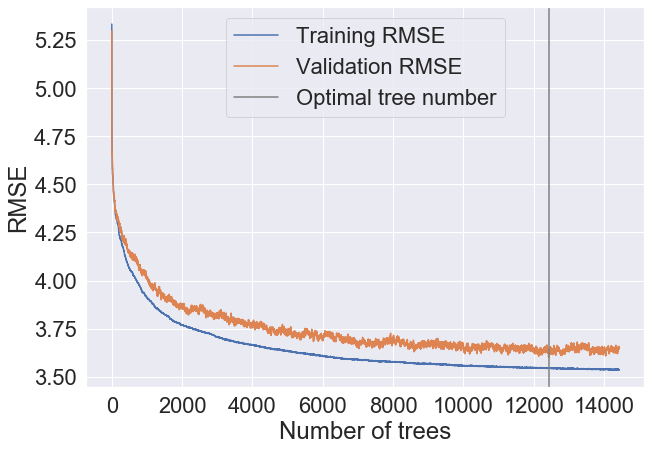

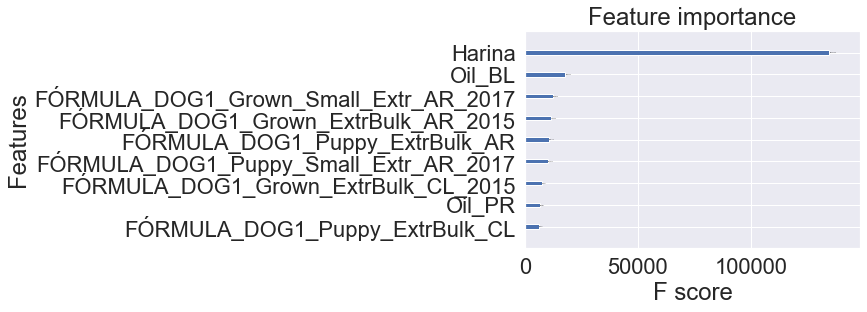

In [137]:
xgb_es = xgb.XGBRegressor(objective='reg:squarederror',
                   n_estimators=20000,
                   booster='gbtree',   
                   **rsearch_xgbr.best_params_)

model_fit(xgb_es, early_stopping_rounds=2000)

### Comparison

I am going to compare the best **Random Forest** model with the best **XGBoost Regressor** model using the **RMSE** as scoring in the test set

In [138]:
from sklearn.metrics import mean_squared_error
from math import sqrt

# Make predictions
y_pred_RF = best_grid.predict(X_test) # Random Forest
y_pred_XGBR = xgb_es.predict(X_test) # XGBoost Regressor

# Calculate RMSE
rms_RF = sqrt(mean_squared_error(y_test, y_pred_RF)) # Random Forest
rms_XGBR = sqrt(mean_squared_error(y_test, y_pred_XGBR)) # XGBoost Regressor

# Print Results
print("---------------------------------------------\nFinal Results")
print("Random Forest RMSE: %.2f" % rms_RF)
print("XGBoost Regressor RMSE: %.2f" % rms_XGBR)
print("---------------------------------------------")

---------------------------------------------
Final Results
Random Forest RMSE: 3.60
XGBoost Regressor RMSE: 3.63
---------------------------------------------


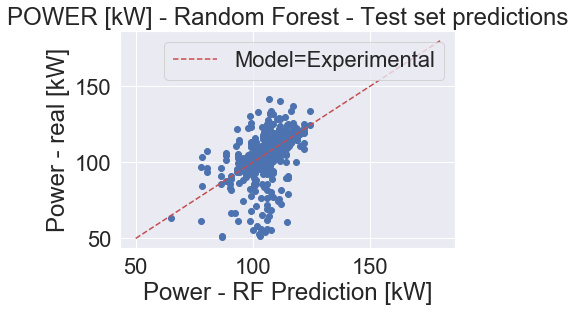

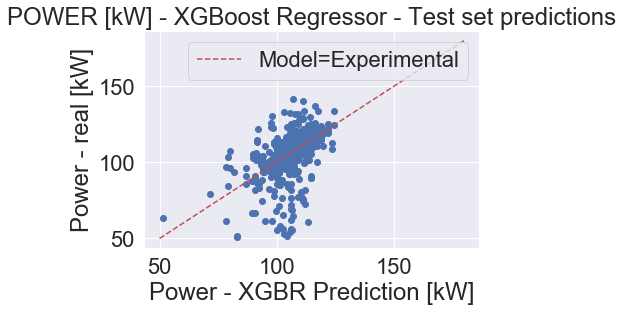

In [157]:
# Plot TAN predictions and actual values

# Random Forest
plt.scatter(y_pred_RF, y_test)
xx = [50,180]
yy = [50,180]
plt.plot(xx,yy,'r--', label='Model=Experimental')
plt.title('POWER [kW] - Random Forest - Test set predictions')
plt.ylabel('Power - real [kW]')
plt.xlabel('Power - RF Prediction [kW]')
# plt.ylim(0, 3)
# plt.xlim(0, 3)
plt.legend()

plt.show()

# XGBoost Regressor
plt.scatter(y_pred_XGBR, y_test)
xx = [50,180]
yy = [50,180]
plt.plot(xx,yy,'r--', label='Model=Experimental')
plt.title('POWER [kW] - XGBoost Regressor - Test set predictions')
plt.ylabel('Power - real [kW]')
plt.xlabel('Power - XGBR Prediction [kW]')
plt.legend()

**Best Model according to the RMSE: Random Forests**

In [142]:
X_train.describe()

,Harina,FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015,FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015,FÓRMULA_DOG1_Grown_Small_Extr_AR_2017,FÓRMULA_DOG1_Puppy_ExtrBulk_AR,FÓRMULA_DOG1_Puppy_ExtrBulk_CL,FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017,Oil_BL,Oil_PR
count,76329.000000,76329.000000,76329.000000,76329.000000,76329.000000,76329.000000,76329.000000,76329.000000,76329.000000
mean,1460.324746,0.587483,0.024958,0.152118,0.154227,0.025285,0.055929,0.433335,0.566665
std,145.945470,0.492290,0.155997,0.359137,0.361169,0.156991,0.229786,0.495539,0.495539
min,7.133000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1493.031222,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1498.069076,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,1500.349499,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,2507.681834,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [148]:
# Compare Power consumption of the model varying only the oil type, leaving every other feature fixed in their respective means.

X_oil_BL = [[X_train['Harina'].mean(), 
             X_train['FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015'].mean(), 
             X_train['FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015'].mean(),
             X_train['FÓRMULA_DOG1_Grown_Small_Extr_AR_2017'].mean(),
             X_train['FÓRMULA_DOG1_Puppy_ExtrBulk_AR'].mean(),
             X_train['FÓRMULA_DOG1_Puppy_ExtrBulk_CL'].mean(),
             X_train['FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017'].mean(),
             1,
             0]]

X_oil_PR = [[X_train['Harina'].mean(), 
             X_train['FÓRMULA_DOG1_Grown_ExtrBulk_AR_2015'].mean(), 
             X_train['FÓRMULA_DOG1_Grown_ExtrBulk_CL_2015'].mean(),
             X_train['FÓRMULA_DOG1_Grown_Small_Extr_AR_2017'].mean(),
             X_train['FÓRMULA_DOG1_Puppy_ExtrBulk_AR'].mean(),
             X_train['FÓRMULA_DOG1_Puppy_ExtrBulk_CL'].mean(),
             X_train['FÓRMULA_DOG1_Puppy_Small_Extr_AR_2017'].mean(),
             0,
             1]]

In [149]:
y_oil_BL = best_grid.predict(X_oil_BL)
y_oil_PR = best_grid.predict(X_oil_PR)

print("BL Power: %.2f" % y_oil_BL)
print("PR Power: %.2f" % y_oil_PR)

BL Power: 112.19
PR Power: 124.60


It seems there is more power consumption with PR Oil than with BL Oil.